# Deep Generative Models: Exploring Image Generation and Latent Space Representations

This Jupyter Notebook explores the application of deep generative models for image generation and analysis, focusing on:

**1. Gaussian Mixture Models (GMMs) with EM Algorithm:**

* Implementation of the EM algorithm to construct GMMs for image data.
* Experimentation with different numbers of mixture components.
* Visualization of the likelihood curve during EM iteration.
* Image generation and visualization using trained GMMs.
* Posterior inference with the GMMs and computation of Normalized Mutual Information (NMI).

**2. Variational Autoencoder (VAE) for Image Reconstruction and Latent Space Learning:**

* Implementation of a vanilla VAE with MSE loss for image reconstruction.
* Exploration of single and multiple samples of latent variables during training.
* Visualizations of reconstruction and generated images.
* Analysis of loss curves for likelihood, KL divergence, and combined terms.
* Evaluation of the VAE's latent space for image classification by:
    * Training a CNN classifier on the original images.
    * Performing posterior inference with the VAE.
    * Using the extracted latent vectors for classification with an MLP.
* Comparison of classification accuracy and network size between using original images and latent representations.

**3. Beta-VAE for Controlling Image Diversity:**

* Implementation of a beta-VAE with varying beta values.
* Visualization of generated and reconstructed images for different beta values.
* Analysis of the effect of beta on image diversity.
* Posterior inference for a pair of images and visualization of generated images along a linear interpolation path in the latent space.

**4. Autoencoder for Compression and Feature Extraction:**

* Implementation of a vanilla autoencoder with MSE loss.
* Posterior inference with the autoencoder to extract latent vectors.
* Classification using the extracted latent vectors and comparison to VAE latent representations.
* Fitting a GMM on the latent vectors from the autoencoder and generating images using sampled latents from the GMM.

This project provides a comprehensive exploration of deep generative models, demonstrating their capabilities for image generation, latent space learning, and downstream tasks like classification.

## **Dataset:**
AFHQ dataset, also known as Animal Faces-HQ (AFHQ), consists of 16,130 high-quality images at 512×512 resolution.
There are three domains of classes, each providing about 5000 images. By having multiple (three) domains and diverse images of various breeds per each domain, AFHQ sets a challenging image-to-image translation problem. The classes are:

* Cat
* Dog
* Wildlife

# Importing Dependencies

In [ ]:
import os
import numpy as np
import cv2
import tqdm
import time
import matplotlib.pyplot as plt

from sklearn.mixture import GaussianMixture
from sklearn.metrics import normalized_mutual_info_score
from scipy.stats import multivariate_normal

import torch
import torch.nn as nn
from torch.nn import functional as F
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
from torchvision.utils import make_grid

from skimage import io, transform, img_as_float
from sklearn.model_selection import train_test_split

# Trained GMMs with varying mixtures via EM. Computed NMI from posterior inference.


## Data Preprocessing

In [ ]:
class ImagePreprocessor:
    """
    Class for preprocessing images from AFHQ dataset.
    """

    def __init__(self, img_size=(128, 128)):
        """
        Initializes the ImagePreprocessor object.

        Parameters
        ----------
        img_size : tuple, optional
            Desired size for resizing the images, default is (128, 128).
        """
        self.img_size = img_size

    def preprocess_afhq(self, data_path, save_path=None):
        """
        Preprocesses images from the specified AFHQ dataset directory, resizes them, and saves them as numpy arrays.

        Parameters
        ----------
        data_path : str
            Path to the AFHQ dataset directory.
        save_path : str, optional
            Path to save the preprocessed data. If None, data won't be saved.

        Returns
        -------
        np.ndarray
            Preprocessed images as a numpy array.
        np.ndarray
            True labels corresponding to the preprocessed images.
        float
            Time taken for preprocessing.
        """
        start_time = time.time()  # Start the timer

        images = []
        labels = []

        # Iterate over categories (cat, dog, wild)
        for category in os.listdir(data_path):
            category_path = os.path.join(data_path, category)
            if os.path.isdir(category_path):
                # Iterate over images in the category folder
                for filename in tqdm.tqdm(os.listdir(category_path), desc=f"Processing {category}"):
                    img_path = os.path.join(category_path, filename)
                    img = cv2.imread(img_path)
                    img_resized = cv2.resize(img, self.img_size)
                    images.append(img_resized)
                    labels.append(category)

        images = np.array(images)
        labels = np.array(labels)

        # Save preprocessed data if save_path is provided
        if save_path:
            if "train" in data_path:
                np.save(os.path.join(save_path, "preprocessed_images_train.npy"), images)
                np.save(os.path.join(save_path, "true_labels_train.npy"), labels)
            elif "val" in data_path:
                np.save(os.path.join(save_path, "preprocessed_images_val.npy"), images)
                np.save(os.path.join(save_path, "true_labels_val.npy"), labels)

        end_time = time.time()  # End the timer
        preprocessing_time = end_time - start_time  # Calculate preprocessing time

        return images, labels, preprocessing_time

In [ ]:
# Paths
train_data_path = "/content/drive/My Drive/Project/DataSet/afhq/train/"
val_data_path = "/content/drive/My Drive/Project/DataSet/afhq/val/"
save_path_train = "/content/drive/My Drive/Project/DataSet/afhq/Preprocessed_Data/train"
save_path_val = "/content/drive/My Drive/Project/DataSet/afhq/Preprocessed_Data/val"

In [ ]:
# Create ImagePreprocessor object
preprocessor = ImagePreprocessor()

# Preprocess train data
train_preprocessed_images, train_true_labels, train_preprocessing_time = preprocessor.preprocess_afhq(train_data_path, save_path=save_path_train)

# Preprocess validation data
val_preprocessed_images, val_true_labels, val_preprocessing_time = preprocessor.preprocess_afhq(val_data_path, save_path=save_path_val)

print("Preprocessing completed.")
print(f"Training data preprocessing time: {train_preprocessing_time} seconds")
print(f"Validation data preprocessing time: {val_preprocessing_time} seconds")


Processing wild: 100%|██████████| 500/500 [00:16<00:00, 30.03it/s]


Preprocessing completed.
Training data preprocessing time: 720.3107163906097 seconds
Validation data preprocessing time: 56.48583126068115 seconds


In [ ]:
# Load the preprocessed data
train_preprocessed_images = np.load("/content/drive/My Drive/Project/DataSet/afhq/Preprocessed_Data/train/preprocessed_images_train.npy")
train_true_labels = np.load("/content/drive/My Drive/Project/DataSet/afhq/Preprocessed_Data/train/true_labels_train.npy")
val_preprocessed_images = np.load("/content/drive/My Drive/Project/DataSet/afhq/Preprocessed_Data/val/preprocessed_images_val.npy")
val_true_labels = np.load("/content/drive/My Drive/Project/DataSet/afhq/Preprocessed_Data/val/true_labels_val.npy")
# Check dimensions and shapes
print("Training Set:")
print("Preprocessed Images Shape:", train_preprocessed_images.shape)
print("True Labels Shape:", train_true_labels.shape)
print("Validation Set:")
print("Preprocessed Images Shape:", val_preprocessed_images.shape)
print("True Labels Shape:", val_true_labels.shape)


Training Set:
Preprocessed Images Shape: (14630, 128, 128, 3)
True Labels Shape: (14630,)
Validation Set:
Preprocessed Images Shape: (1500, 128, 128, 3)
True Labels Shape: (1500,)


## Data Visualisation

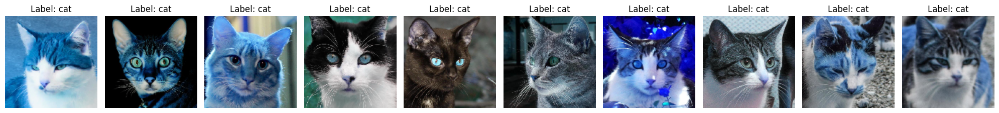

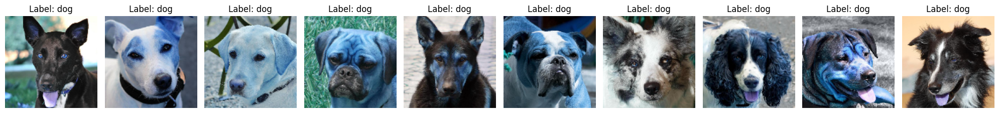

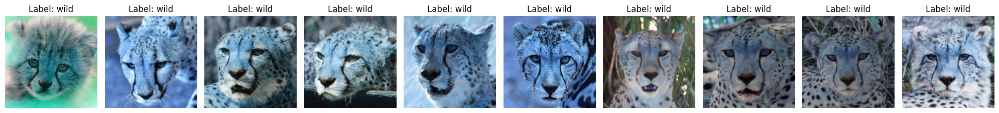

In [ ]:
class ImageVisualizer:
  """
  A class for visualizing preprocessed images.
  """
  def __init__(self, images, labels):
    """
    Initializes the ImageVisualizer with images and labels.

    Parameters:
      images: np.ndarray
        The preprocessed images to visualize.
      labels: np.ndarray
        The labels corresponding to the images.
    """
    self.images = images
    self.labels = labels

  def visualize_image(self, image, label, ax):
    """
    Visualizes an image with its label on a provided axis.

    Parameters:
      image: np.ndarray
        The preprocessed image to visualize.
      label: str
        The label corresponding to the image.
      ax: matplotlib.axes._axes.Axes
        The matplotlib axis to use for visualization.
    """
    ax.imshow(image)
    ax.set_title(f"Label: {label}")
    ax.axis("off")

  def visualize_grid(self, num_images_per_row, row_indices, col_title):
    """
    Visualizes a grid of images from specified row indices with a title.

    Parameters:
      num_images_per_row: int
        The number of images to display in each row.
      row_indices: list
        The indices of the images to visualize in the current row.
      col_title: str
        The title for the current column.
    """
    fig, axs = plt.subplots(1, num_images_per_row, figsize=(20, 5))

    for i, idx in enumerate(row_indices):
      image = self.images[idx]
      label = self.labels[idx]
      self.visualize_image(image, label, axs[i])

    axs[0].set_ylabel(col_title, fontsize=10)
    plt.tight_layout()
    plt.show()

# Load preprocessed data (assuming you have already loaded them)
train_preprocessed_images = np.load("/content/drive/My Drive/Project/DataSet/afhq/Preprocessed_Data/train/preprocessed_images_train.npy")
train_true_labels = np.load("/content/drive/My Drive/Project/DataSet/afhq/Preprocessed_Data/train/true_labels_train.npy")

# Visualizer object
visualizer = ImageVisualizer(train_preprocessed_images, train_true_labels)

# Define number of images per row
num_images_per_row = 10

# Visualize first 10 images
visualizer.visualize_grid(num_images_per_row, range(num_images_per_row), "First 10")

# Visualize middle 10 images
middle_indices = range(len(train_preprocessed_images) // 2 - num_images_per_row // 2,
                          len(train_preprocessed_images) // 2 + num_images_per_row // 2)
visualizer.visualize_grid(num_images_per_row, middle_indices, "Middle 10")

# Visualize last 10 images
visualizer.visualize_grid(num_images_per_row, range(len(train_preprocessed_images) - num_images_per_row, len(train_preprocessed_images)), "Last 10")


## Gaussian Mixture Model

In [ ]:
class GaussianMixtureModel:
    """
    A class to represent a Gaussian Mixture Model (GMM).

    Attributes:
        n_hyper (int): Number of Gaussian components in the mixture.
        dim (int): Dimensionality of the data.
        u_s (np.ndarray): Means of the Gaussian components (shape: (n_hyper, dim)).
        co_mx_inv (np.ndarray): Inverse covariance matrices of the Gaussian components (shape: (n_hyper, dim)).
        alpha_s (np.ndarray): Mixing coefficients of the Gaussian components (shape: (n_hyper,)).
        likely (float): Log-likelihood of the data given the current model parameters.

    """

    def __init__(self, n_hyper, dim=0):
        """
        Initializes a GaussianMixtureModel object.

        Args:
            n_hyper (int): Number of Gaussian components.
            dim (int, optional): Dimensionality of the data. Defaults to 0.
        """

        self.n_hyper = n_hyper
        self.dim = dim
        # Initialize means randomly
        self.u_s = np.random.rand(n_hyper, dim)
        # Initialize inverse covariance matrices to identity
        self.co_mx_inv = np.ones((n_hyper, dim))
        # Initialize mixing coefficients uniformly
        self.alpha_s = np.ones((n_hyper)) / n_hyper
        self.likely = 0

    def _gaussian(self, x, mean, co_var_inv):
        """
        Calculates the Gaussian probability density function for a given data point.

        Args:
            x (np.ndarray): Data point (shape: (dim,)).
            mean (np.ndarray): Mean of the Gaussian component (shape: (dim,)).
            co_var_inv (np.ndarray): Inverse covariance matrix of the Gaussian component (shape: (dim,)).

        Returns:
            float: Gaussian probability density at the given data point.

        """

        # Calculate the difference between data point and mean
        x_u = x - mean
        # Reshape for matrix multiplication
        x_u = x_u.reshape(1, len(x_u))
        co_var_inv = co_var_inv.reshape(1, x_u.shape[-1])
        # Calculate the exponent term of the Gaussian PDF
        e = -((x_u**2) * co_var_inv)
        # Handle cases where variance is zero to avoid division by zero
        for i in range(e.shape[1]):
            if x_u[0][i] == 0:
                e[0][i] = 0
        # Sum over dimensions and divide by 2
        e = (e.sum(axis=1)) / 2
        # Calculate the complete Gaussian PDF and return
        return (np.log(co_var_inv).sum(axis=1)) * 0.5 + e

    def expectation(self, data):
        """
        Performs the expectation step of the EM algorithm.

        Args:
            data (np.ndarray): Data matrix (shape: (n_samples, dim)).

        Returns:
            np.ndarray: Responsibilities of each Gaussian component for each data point (shape: (n_samples, n_hyper)).

        """
        gamma_ik = []
        # Iterate over each data point
        for each in data:
            dist_v = np.zeros((1, self.n_hyper))
            # Calculate the Gaussian PDF for each component
            for i in range(self.n_hyper):
                dist_v[0][i] = self._gaussian(each, self.u_s[i], self.co_mx_inv[i])
            # Calculate the responsibilities using the calculated PDFs and mixing coefficients
            gamma_ik.append(self.alpha_s / ((np.exp(dist_v - dist_v.T) * self.alpha_s).sum(axis=1)).reshape(1, self.n_hyper))
        # Concatenate responsibilities for all data points and return
        gamma_ik = np.concatenate(gamma_ik, axis=0).astype(np.float32)
        return gamma_ik

    def likelihood(self, data):
        """
        Calculates the log-likelihood of the data given the current model parameters.

        Args:
            data (np.ndarray): Data matrix (shape: (n_samples, dim)).

        Returns:
            float: Log-likelihood of the data.

        """

        p = 0
        # Iterate over data points and sum their individual log probabilities
        for each in data:
            p += self.prob(each)
        return p

    def maximisation(self, data, gamma_ik):
        """
        Performs the maximization step of the EM algorithm.

        Args:
            data (np.ndarray): Data matrix (shape: (n_samples, dim)).
            gamma_ik (np.ndarray): Responsibilities of each Gaussian component for each data point (shape: (n_samples, n_hyper)).

        """

        # Calculate weighted sum of data points for each component
        sumxi = gamma_ik.T @ data
        # Calculate the sum of responsibilities for each component
        sum_gamma = gamma_ik.sum(axis=0)
        # Update means for each component
        for i in range(self.n_hyper):
            if sum_gamma[i] != 0:
                sumxi[i] = sumxi[i] / sum_gamma[i]
            else:
                sumxi[i] = sumxi[i] * 0
        self.u_s = sumxi
        # Calculate weighted covariance matrices for each component
        co_Vars = (((np.expand_dims(data, axis=1) - np.expand_dims(self.u_s, axis=0)) ** 2) * np.expand_dims(gamma_ik, axis=2)).sum(axis=0)
        # Update covariance matrices for each component
        for i in range(self.n_hyper):
            if sum_gamma[i] != 0:
                co_Vars[i] = co_Vars[i] / sum_gamma[i]
            else:
                co_Vars[i] = co_Vars[i] * 0
        # Calculate inverse covariance matrices
        for i in range(self.n_hyper):
            for j in range(co_Vars.shape[-1]):
                if co_Vars[i][j] == 0:
                    self.co_mx_inv[i][j] = float('inf')
                else:
                    self.co_mx_inv[i][j] = 1 / co_Vars[i][j]
        # Update mixing coefficients
        self.alpha_s = gamma_ik.sum(axis=0) / len(data)

    def train(self, data, th, path=''):
        """
        Trains the GMM on the given data using the EM algorithm.

        Args:
            data (np.ndarray): Data matrix (shape: (n_samples, dim)).
            th (float): Convergence threshold for log-likelihood.
            path (str, optional): Path to save the model parameters. Defaults to ''.

        Returns:
            list: List of log-likelihood values during training.

        """

        prev = self.likelihood(data)
        lhd = []
        # Run EM algorithm for a fixed number of iterations
        for _ in range(50):
            lhd.append(prev)
            # E-step: Calculate responsibilities
            gammas = self.expectation(data)
            # M-step: Update model parameters
            self.maximisation(data, gammas)
            cur = self.likelihood(data)
            # Check for convergence
            flag = cur - prev > th
            prev = cur
            # Save model parameters
            np.save(os.path.join(path, 'means_' + str(self.n_hyper)), self.u_s,)
            np.save(os.path.join(path, 'covariance_' + str(self.n_hyper)), self.co_mx_inv)
            np.save(os.path.join(path, 'alphas_' + str(self.n_hyper)), self.alpha_s)
            print("Training completed")
        return lhd

    def load_model(self, path_m=None, path_c=None, path_a=None, path=None):
        """
        Loads the GMM model parameters from files.

        Args:
            path_m (str, optional): Path to the means file. Defaults to None.
            path_c (str, optional): Path to the covariance matrices file. Defaults to None.
            path_a (str, optional): Path to the mixing coefficients file. Defaults to None.
            path (str, optional): Path to a directory containing all model parameter files. Defaults to None.

        """

        if path:
            # Load parameters from a directory
            self.alpha_s = np.load(os.path.join(path, 'alphas{0}'.format(self.n_hyper)))
            self.co_mx = np.load(os.path.join(path, 'covariance{0}'.format(self.n_hyper)))
            self.u_s = np.load(os.path.join(path, 'means{0}'.format(self.n_hyper)))
        else:
            # Load parameters from individual files
            if path_m:
                self.u_s = np.load(path_m) / 255

    def prob(self, data):
        """
        Calculates the probability of a data point belonging to the GMM.

        Args:
            data (np.ndarray): Data point (shape: (dim,)).

        Returns:
            float: Probability of the data point belonging to the GMM.

        """

        dist_v = np.zeros((1, self.n_hyper))
        # Calculate the Gaussian PDF for each component
        for i in range(self.n_hyper):
            dist_v[0][i] = self._gaussian(data, self.u_s[i], self.co_mx_inv[i])
        # Calculate the weighted sum of PDFs using mixing coefficients
        ret = (self.alpha_s * dist_v).sum(axis=1)
        return ret

In [ ]:
def plot_samples(images, n_rows=10, n_cols=10):
    """
    Plots an array of images in a grid.

    Args:
        images (np.ndarray): Array of images to plot (shape: (n_samples, height * width * channels)).
        n_rows (int, optional): Number of rows in the grid. Defaults to 10.
        n_cols (int, optional): Number of columns in the grid. Defaults to 10.

    """

    # Create a figure and a grid of subplots
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, 12))
    # Iterate over each cell in the grid
    for i in range(n_rows):
        for j in range(n_cols):
            # Calculate the index of the image to plot
            index = i * n_cols + j
            # Get the image data
            image = images[index]
            # Reshape the image to its original dimensions (assuming 16x16 RGB images)
            image = (image.reshape(128, 128, 3) * 255).astype('uint8')
            # Display the image on the corresponding subplot
            axes[i, j].imshow(image)
            # Turn off axis ticks and labels
            axes[i, j].axis('off')
    # Display the plot
    plt.show()

In [ ]:
def calculate_nmi(predicted, n_clusters, data_splits=None):
  """
  Calculates the Normalized Mutual Information (NMI) between a set of predicted cluster labels and ground truth class labels.

  Args:
      predicted (np.ndarray): 1D array of predicted cluster labels.
      n_clusters (int): Number of clusters.
      data_splits (list, optional): A list containing the number of data points for each ground truth class.
                                      Defaults to None, assuming three classes of sizes 5153, 4739, and 4738.

  Returns:
      float: Normalized Mutual Information (NMI) score.

  """

  if data_splits is None:
    data_splits = [5153, 4739, 4738]
  total_samples = len(predicted)

  # Calculate the empirical cluster proportions
  cluster_hist, _ = np.histogram(predicted, bins=np.arange(n_clusters + 1))
  cluster_probs = cluster_hist / total_samples

  # Calculate the entropy of the clustering
  h_u = -np.sum(cluster_probs * np.log(cluster_probs + 1e-10))

  # Calculate the empirical class proportions
  class_probs = np.array(data_splits) / total_samples
  h_v = -np.sum(class_probs * np.log(class_probs + 1e-10)) # Add a small epsilon to handle log(0)

  # Calculate the mutual information
  mi = 0.0
  for i in range(n_clusters):
      cluster_indices = np.where(predicted == i)[0]
      cluster_class_hist, _ = np.histogram(cluster_indices, bins=np.cumsum([0] + data_splits))
      cluster_class_probs = cluster_class_hist / len(cluster_indices)
      mi += cluster_probs[i] * (-np.sum(cluster_class_probs * np.log(cluster_class_probs + 1e-10)))

  # Calculate and return the normalized mutual information
  nmi = (2 * (mi - h_u - h_v)) / (h_v + h_u)
  return nmi

In [ ]:
# Load the data
data = np.load("/content/drive/My Drive/Project/DataSet/afhq/Preprocessed_Data/train/preprocessed_images_train.npy")/255

# Flatten the images to be (n_samples, dim)
data = data.reshape(data.shape[0], -1)

# Set the training parameters
convergence_threshold = 0.5
save_path_1 = "/content/drive/My Drive/Project/exp_result/model_1/"
save_path_2 = "/content/drive/My Drive/Project/exp_result/model_2/"
save_path_3 = "/content/drive/My Drive/Project/exp_result/model_3/"

### Number of Clusters = 12

In [ ]:
# Initialize the GMM model
model_1 = GaussianMixtureModel(n_hyper = 12, dim = data.shape[1])

# Train the GMM model
log_likelihood_history_1=model_1.train(data, convergence_threshold, path=save_path_1")

Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


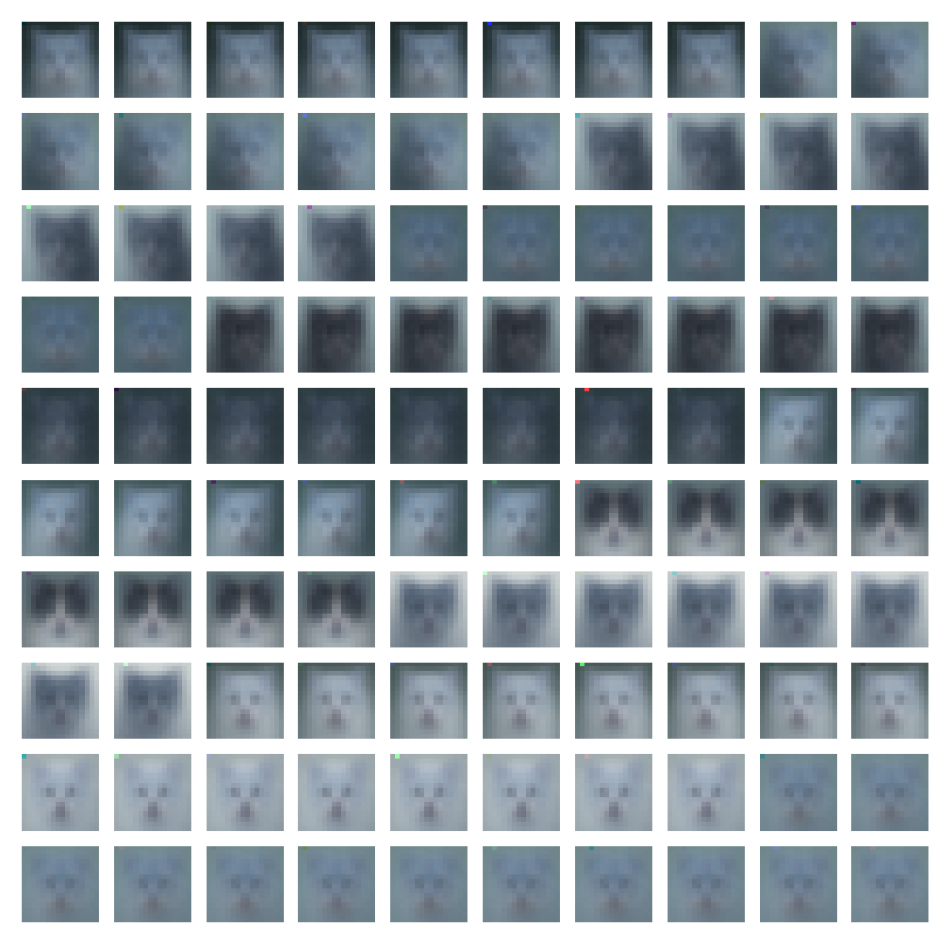

In [ ]:
# Sample Generation and Plotting
samples_12 = []
means_12 = np.load('/content/drive/My Drive/Project/exp_result/model_1/means_12.npy')
variances_12 = np.load('/content/drive/My Drive/Project/exp_result/model_1/covariance_12.npy')
alpha_12 = np.load('/content/drive/My Drive/Project/exp_result/model_1/alphas_12.npy')

for i in range(12):
    # Generate samples from each Gaussian component
    sample = np.random.multivariate_normal(means_12[i], np.linalg.inv(variances_12[i]), size=10) # Generate 10 samples per component
    samples_12.extend(sample)

# Reshape samples for plotting
samples_12 = np.array(samples_12)

plot_samples(samples_12)

In [ ]:
# Prediction and NMI Calculation
predicted_12 = []
for each in data:
    log_likelihoods = []  # Use log-likelihoods for numerical stability
    for i in range(12):
        log_likelihoods.append(model_1._gaussian(each, means_12[i], variances_12[i]))
    predicted_12.append(np.argmax(log_likelihoods))

nmi_score = calculate_nmi(predicted_12, 12)
print("NMI Score: ", nmi_score)

NMI Score (12 components): 0.0383928328489452


### Number of Clusters = 9

In [ ]:
# Initialize the GMM model
model_2 = GaussianMixtureModel(n_hyper=9, dim=data.shape[1])

# Train the GMM model
log_likelihood_history__2=model_2.train(data, convergence_threshold, path=save_path_2")

Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

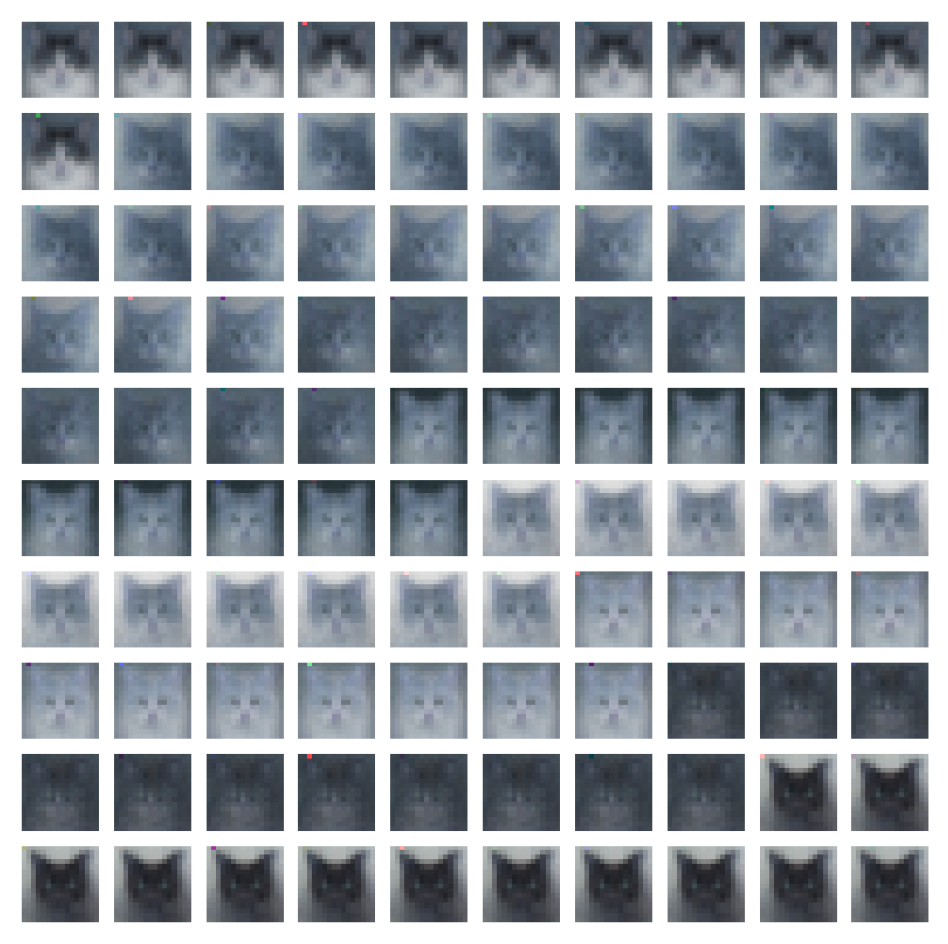

In [ ]:
# Sample Generation and Plotting
samples_9 = []
means_9 = np.load('/content/drive/My Drive/Project/exp_result/model_2/means_9.npy')
variances_9 = np.load('/content/drive/My Drive/Project/exp_result/model_2/covariance_9.npy')
alpha_9 = np.load('/content/drive/My Drive/Project/exp_result/model_2/alphas_9.npy')

for i in range(9):
    # Generate multiple samples from each Gaussian component
    sample = np.random.multivariate_normal(means_9[i], np.linalg.inv(variances_9[i]), size=12) # Generate 12 samples
    samples_9.extend(sample)

# Reshape samples for plotting
samples_9 = np.array(samples_9)

plot_samples(samples_9)

In [ ]:
# Prediction and NMI Calculation
predicted_9 = []
for each in data:
    log_likelihoods = []
    for i in range(9):
        log_likelihoods.append(model_2._gaussian(each, means_9[i], variances_9[i]))
    predicted_9.append(np.argmax(log_likelihoods))

nmi_score_9 = calculate_nmi(predicted_9, 9)
print("NMI Score (9 Components): ", nmi_score_9)

NMI Score (9 Components): 0.03140658122152431


### Number of Clusters = 3

In [ ]:
# Initialize the GMM model
model_3 = GaussianMixtureModel(n_hyper=3, dim=data.shape[1])

# Train the GMM model
log_likelihood_history__3=model_3.train(data, convergence_threshold, path=save_path_3")

Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed
Training Completed


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


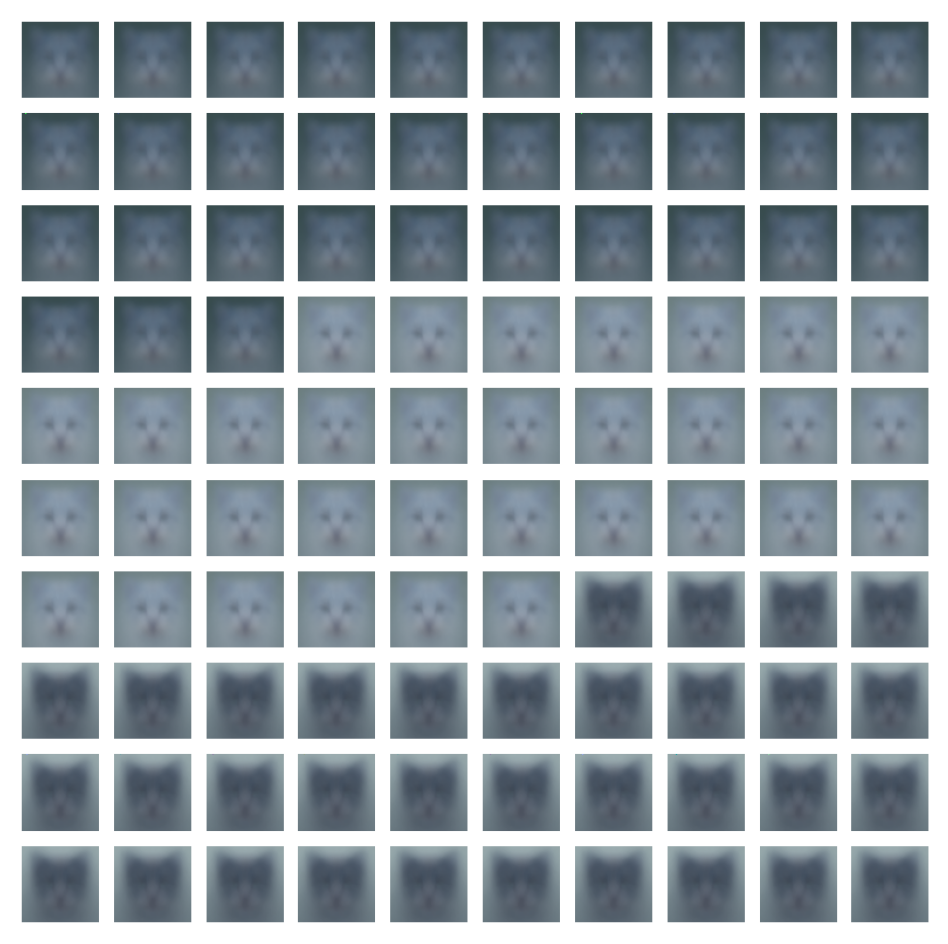

In [ ]:
# Sample Generation and Plotting
samples_3 = []
means_3 = np.load('/content/drive/My Drive/Project/exp_result/model_3/means_3.npy')
variances_3 = np.load('/content/drive/My Drive/Project/exp_result/model_3/covariance_3.npy')
alpha_3 = np.load('/content/drive/My Drive/Project/exp_result/model_3/alphas_3.npy')

for i in range(3):
    # Generate multiple samples per component
    sample = np.random.multivariate_normal(means_3[i], np.linalg.inv(variances_3[i]), size=35) # Generate 35 samples
    samples_3.extend(sample)

# Reshape samples (for plotting)
samples_3 = np.array(samples_3)
plot_samples(samples_3)

In [ ]:
# Prediction and NMI Calculation
predicted_3 = []
for each in data:
    log_likelihoods = []
    for i in range(3):
        # Make sure you are using the correct variables (means_3, variances_3)
        log_likelihoods.append(model_3._gaussian(each, means_3[i], variances_3[i]))
    predicted_3.append(np.argmax(log_likelihoods))

nmi_score_3 = calculate_nmi(predicted_3, 3)
print("NMI Score (3 Components): ", nmi_score_3)

NMI Score (3 Components): 0.00701903250252015


#Implemented VAEs, including beta-VAEs, for image generation and diversity control.

## Dataloaders

In [ ]:
class ImagePreprocessing:
    """
    Class responsible for preprocessing images for a deep learning model.

    Attributes:
        image_size (tuple): The desired size for resizing images.
        mean (list): The mean values used for normalization.
        std (list): The standard deviation values used for normalization.

    Methods:
        get_transform(): Returns a torchvision.transforms.Compose object representing the preprocessing pipeline.
    """

    def __init__(self, image_size=(128, 128), mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]):
        """
        Initializes the ImagePreprocessing object with given parameters.

        Args:
            image_size (tuple): The desired size for resizing images (default: (128, 128)).
            mean (list): The mean values used for normalization (default: [0.5, 0.5, 0.5]).
            std (list): The standard deviation values used for normalization (default: [0.5, 0.5, 0.5]).
        """

        self.image_size = image_size
        self.mean = mean
        self.std = std

    def get_transform(self):
        """
        Returns a torchvision.transforms.Compose object representing the preprocessing pipeline.

        The pipeline includes:
            - Resizing images to the specified size.
            - Converting images to tensors.
            - Normalizing images using the provided mean and standard deviation values.

        Returns:
            torchvision.transforms.Compose: The preprocessing pipeline.
        """
        transform = transforms.Compose([
            transforms.Resize(self.image_size),  # Resize images to specified size
            transforms.ToTensor(),  # Convert image to PyTorch tensor
            transforms.Normalize(mean=self.mean, std=self.std)  # Normalize to range [-1, 1]
        ])
        return transform

# Initialize preprocessing class
image_preprocessing = ImagePreprocessing()

# Create transform object
transform = image_preprocessing.get_transform()

# Load image dataset from directory
dataset = ImageFolder(root='/content/drive/My Drive/Project/DataSet/afhq/train', transform=transform)

# Create data loader
dataloader = DataLoader(dataset, batch_size=256, shuffle=False)

## VAE Class

In [ ]:
class VAE(nn.Module):
  """
  Variational Autoencoder (VAE) model.

  Args:
      z_dim (int, optional): Dimensionality of the latent space. Defaults to 128.
      in_channels (int, optional): Number of input channels (e.g., 3 for RGB images). Defaults to 3.
      beta (float, optional): Beta parameter for the KL divergence loss. Defaults to 1.
      z_sample (int, optional): Number of latent samples to generate for each input image. Defaults to 1.

  Attributes:
      z_dim (int): Dimensionality of the latent space.
      beta (float): Beta parameter for the KL divergence loss.
      z_sample (int): Number of latent samples to generate for each input image.
      encoder (nn.Sequential): Encoder network.
      fc_mu (nn.Linear): Fully connected layer for the mean of the latent distribution.
      fc_var (nn.Linear): Fully connected layer for the variance of the latent distribution.
      decoder_input (nn.Linear): Fully connected layer for the decoder input.
      decoder (nn.Sequential): Decoder network.

  Methods:
      encode(x): Encodes the input image into the latent space.
      decode(z): Decodes the latent vector into an image.
      reparametrization(mu, log_var, z_sample): Samples from the latent distribution.
      forward(x, z_sample): Performs the forward pass through the VAE.
      loss(x, x_hat, mu, log_var): Calculates the VAE loss.
      reconstruct(x): Reconstructs the input image.
      sample(device, B): Samples from the latent distribution and decodes to generate images.
  """
  def __init__(self, z_dim=128, in_channels=3, beta=1, z_sample=1):
    """
    Initializes the VAE model.
    """
    super(VAE, self).__init__()
    self.z_dim = z_dim
    self.beta = beta
    self.z_sample = z_sample

    # --- Encoder ---
    self.encoder = nn.Sequential(
        nn.Conv2d(in_channels, 32, kernel_size=3, stride=2, padding=1),   # Input: B x 3 x 128 x 128
        nn.BatchNorm2d(32),
        nn.LeakyReLU(),
        nn.Conv2d(32, 64, kernel_size=3, stride=2, padding=1),            # Input: B x 32 x 64 x 64
        nn.BatchNorm2d(64),
        nn.LeakyReLU(),
        nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),           # Input: B x 64 x 32 x 32
        nn.BatchNorm2d(128),
        nn.LeakyReLU(),
        nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),           # Input: B x 128 x 16 x 16
        nn.LeakyReLU(),
    )  # Output: B x 256 x 8 x 8

    # Mean and variance (flatten input)
    self.fc_mu = nn.Linear(256 * 8 * 8, z_dim)
    self.fc_var = nn.Linear(256 * 8 * 8, z_dim)

    # --- Decoder ---
    # Decoder input transforms z_dim to 256*8*8 for reshaping
    self.decoder_input = nn.Linear(z_dim, 256 * 8 * 8)  # Output: B x 256*64
    self.decoder = nn.Sequential(                         # Input: B x 256 x 8 x 8
        nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),    # Output: B x 128 x 16 x 16
        nn.BatchNorm2d(128),
        nn.LeakyReLU(),
        nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),     # Output: B x 64 x 32 x 32
        nn.BatchNorm2d(64),
        nn.LeakyReLU(),
        nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),      # Output: B x 32 x 64 x 64
        nn.BatchNorm2d(32),
        nn.LeakyReLU(),
        nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1),       # Output: B x 3 x 128 x 128
        nn.Tanh()                                               # Output range: -1 to 1
    )

  def encode(self, x):
    """
    Encodes the input image into the latent space.

    Args:
        x (torch.Tensor): Input image with shape B x C x H x W (B x 3 x 128 x 128).

    Returns:
        list: List containing:
            mu (torch.Tensor): Mean of the latent distribution with shape B x Z_dim.
            log_var (torch.Tensor): Log variance of the latent distribution with shape B x Z_dim.
    """
    x = self.encoder(x)
    x = torch.flatten(x, start_dim=1)
    mu = self.fc_mu(x)
    log_var = self.fc_var(x)
    return [mu, log_var]

  def decode(self, z):
    """
    Decodes the latent vector into an image.

    Args:
        z (torch.Tensor): Latent vector with shape B x Z_dim.

    Returns:
        torch.Tensor: Reconstructed image with shape B x C x H x W (B x 3 x 128 x 128).
    """
    x = self.decoder_input(z)
    x = torch.reshape(x, (-1, 256, 8, 8))
    x = self.decoder(x)
    return x

  def reparametrization(self, mu, log_var, z_sample):
    """
    Samples from the latent distribution using the reparametrization trick.

    Args:
        mu (torch.Tensor): Mean of the latent distribution with shape B x Z_dim.
        log_var (torch.Tensor): Log variance of the latent distribution with shape B x Z_dim.
        z_sample (int): Number of latent samples to generate.

    Returns:
        torch.Tensor: Sampled latent vector with shape B*z_sample x Z_dim.
    """
    z = None
    for i in range(z_sample):
      std = torch.exp(0.5 * log_var)
      eps = torch.rand_like(std)
      if i == 0:
        z = mu + std * eps
        continue
      z = torch.cat((z, mu + std * eps), dim=0)
    return z

  def forward(self, x, z_sample=None):
    """
    Performs the forward pass through the VAE.

    Args:
        x (torch.Tensor): Input image with shape B x C x H x W (B x 3 x 128 x 128).
        z_sample (int, optional): Number of latent samples to generate. Defaults to self.z_sample.

    Returns:
        list: List containing:
            x_chng (torch.Tensor): Concatenated input images based on z_sample with shape B*z_sample x C x H x W.
            x_hat (torch.Tensor): Reconstructed images with shape B*z_sample x C x H x W.
            mu (torch.Tensor): Mean of the latent distribution with shape B x Z_dim.
            log_var (torch.Tensor): Log variance of the latent distribution with shape B x Z_dim.
    """
    if z_sample is None:
      z_sample = self.z_sample

    mu, log_var = self.encode(x)
    z = self.reparametrization(mu, log_var, z_sample)
    x_hat = self.decode(z)

    x_chng = None
    for i in range(z_sample):
      if i == 0:
        x_chng = x
        continue
      x_chng = torch.cat((x_chng, x), dim=0)  # B*z_sample x C x H x W

    return [x_chng, x_hat, mu, log_var]

  def loss(self, x, x_hat, mu, log_var):
    """
    Calculates the VAE loss.

    Args:
        x (torch.Tensor): Input image with shape B x C x H x W (B x 3 x 128 x 128).
        x_hat (torch.Tensor): Reconstructed image with shape B x C x H x W (B x 3 x 128 x 128).
        mu (torch.Tensor): Mean of the latent distribution with shape B x Z_dim.
        log_var (torch.Tensor): Log variance of the latent distribution with shape B x Z_dim.

    Returns:
        list: List containing:
            loss (torch.Tensor): Total VAE loss.
            rec_loss (torch.Tensor): Reconstruction loss.
            reg_loss (torch.Tensor): Regularization loss (KL divergence).
    """
    x = torch.reshape(x, (x.shape[0], -1))
    x_hat = torch.reshape(x_hat, (x_hat.shape[0], -1))
    rec_loss = F.mse_loss(x, x_hat) * x.shape[0] * x.shape[1] / self.z_sample  # Average reconstruction loss
    reg_loss = -0.5 * torch.sum(1 + log_var - mu**2 - log_var.exp())  # Average regularization loss
    loss = rec_loss + self.beta * reg_loss
    return [loss, rec_loss, reg_loss]

  def reconstruct(self, x):
    """
    Reconstructs the input image.

    Args:
        x (torch.Tensor): Input image with shape B x C x H x W (B x 3 x 128 x 128).

    Returns:
        torch.Tensor: Reconstructed image with shape B x C x H x W (B x 3 x 128 x 128).
    """
    _, x_hat, _, _ = self.forward(x, 1)
    return x_hat

  def sample(self, device, B):
    """
    Samples from the latent distribution and decodes to generate images.

    Args:
        device (str): Device to use (e.g., 'cuda', 'cpu').
        B (int): Batch size.

    Returns:
        torch.Tensor: Sampled images with shape B x C x H x W (B x 3 x 128 x 128).
    """
    z = torch.randn((B, self.z_dim))
    z = z.to(device)
    x_hat = self.decode(z)
    return x_hat

## Training VAE

This section focuses on fine-tuning our model by training it with different values of the parameters 'z' and 'beta'. By systematically adjusting these parameters, we explore the model's potential and identify optimal configurations for specific tasks. The weights corresponding to these optimal configurations are carefully saved, serving as a blueprint for our model's learned knowledge. These saved weights will be crucial in the next section, where we utilize them for inference and sampling purposes.

Here, 'total loss' represents the overall loss of the model, which is comprised of two components: 'likelihood' and 'KL'. 'Likelihood' refers to the reconstruction loss, measuring how well the model reconstructs the original input data. 'KL' stands for Kullback-Leibler divergence, which represents the prior matching loss, measuring how closely the model's internal representation aligns with the desired prior distribution.

### Beta = 1 and z_sample = 1

The beta value is set to 1, and the number of intermediate samples is 1.

Epoch 1/200
Total Loss:  226080000.0
Epoch 2/200
Total Loss:  127720000.0
Epoch 3/200
Total Loss:  85293784.0
Epoch 4/200
Total Loss:  69209248.0
Epoch 5/200
Total Loss:  61884880.0
Epoch 6/200
Total Loss:  57651280.0
Epoch 7/200
Total Loss:  54663408.0
Epoch 8/200
Total Loss:  52389140.0
Epoch 9/200
Total Loss:  50504424.0
Epoch 10/200
Total Loss:  49010604.0


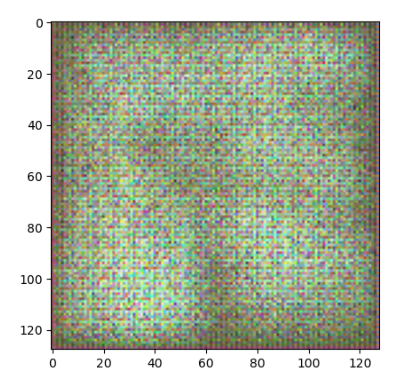

Epoch 11/200
Total Loss:  47822104.0
Epoch 12/200
Total Loss:  46816724.0
Epoch 13/200
Total Loss:  45540220.0
Epoch 14/200
Total Loss:  43767380.0
Epoch 15/200
Total Loss:  42219032.0
Epoch 16/200
Total Loss:  41120732.0
Epoch 17/200
Total Loss:  40137424.0
Epoch 18/200
Total Loss:  39301052.0
Epoch 19/200
Total Loss:  38631332.0
Epoch 20/200
Total Loss:  37983872.0


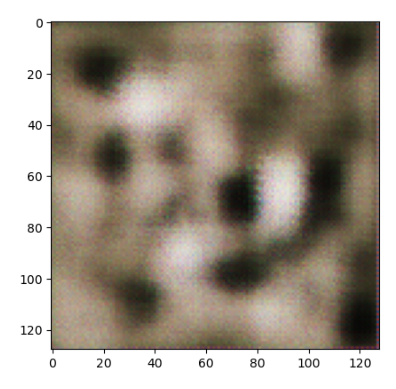

Epoch 21/200
Total Loss:  37413400.0
Epoch 22/200
Total Loss:  36935392.0
Epoch 23/200
Total Loss:  36589012.0
Epoch 24/200
Total Loss:  36245080.0
Epoch 25/200
Total Loss:  35960716.0
Epoch 26/200
Total Loss:  35730548.0
Epoch 27/200
Total Loss:  35544244.0
Epoch 28/200
Total Loss:  35334392.0
Epoch 29/200
Total Loss:  35123104.0
Epoch 30/200
Total Loss:  34800808.0


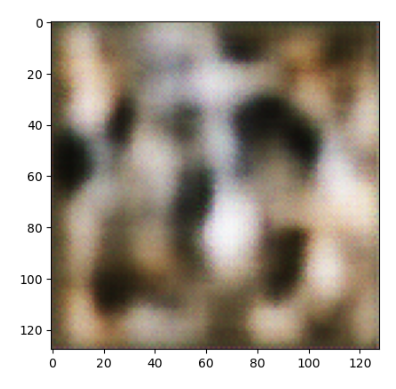

Epoch 31/200
Total Loss:  34589648.0
Epoch 32/200
Total Loss:  34394536.0
Epoch 33/200
Total Loss:  34184360.0
Epoch 34/200
Total Loss:  34043980.0
Epoch 35/200
Total Loss:  33899868.0
Epoch 36/200
Total Loss:  33770904.0
Epoch 37/200
Total Loss:  33626084.0
Epoch 38/200
Total Loss:  33505628.0
Epoch 39/200
Total Loss:  33392904.0
Epoch 40/200
Total Loss:  33292732.0


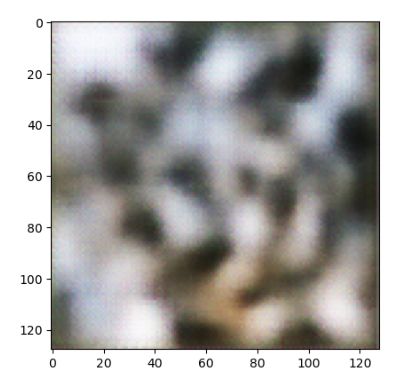

Epoch 41/200
Total Loss:  33215598.0
Epoch 42/200
Total Loss:  33140750.0
Epoch 43/200
Total Loss:  33117476.0
Epoch 44/200
Total Loss:  33118166.0
Epoch 45/200
Total Loss:  33129772.0
Epoch 46/200
Total Loss:  33064868.0
Epoch 47/200
Total Loss:  33078266.0
Epoch 48/200
Total Loss:  32907464.0
Epoch 49/200
Total Loss:  32763230.0
Epoch 50/200
Total Loss:  32611754.0


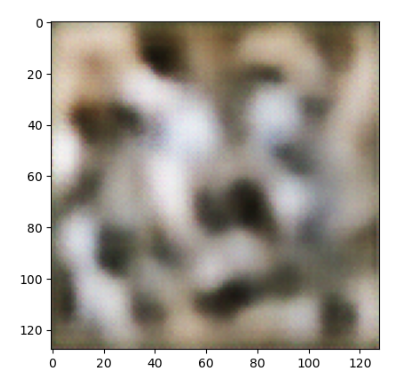

Epoch 51/200
Total Loss:  32542874.0
Epoch 52/200
Total Loss:  32496288.0
Epoch 53/200
Total Loss:  32459096.0
Epoch 54/200
Total Loss:  32365282.0
Epoch 55/200
Total Loss:  32273332.0
Epoch 56/200
Total Loss:  32210626.0
Epoch 57/200
Total Loss:  32160614.0
Epoch 58/200
Total Loss:  32088740.0
Epoch 59/200
Total Loss:  31950540.0
Epoch 60/200
Total Loss:  31753026.0


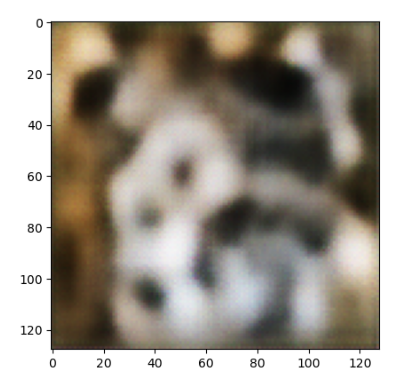

Epoch 61/200
Total Loss:  31621214.0
Epoch 62/200
Total Loss:  31500366.0
Epoch 63/200
Total Loss:  31403112.0
Epoch 64/200
Total Loss:  31325570.0
Epoch 65/200
Total Loss:  31232980.0
Epoch 66/200
Total Loss:  31159308.0
Epoch 67/200
Total Loss:  31088714.0
Epoch 68/200
Total Loss:  31009960.0
Epoch 69/200
Total Loss:  30948624.0
Epoch 70/200
Total Loss:  30911824.0


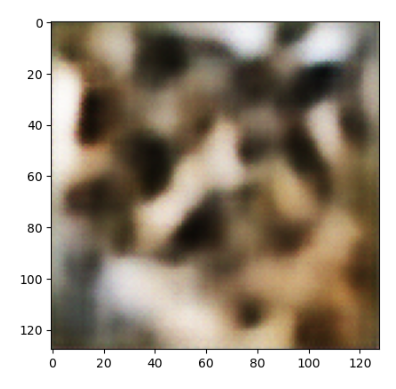

Epoch 71/200
Total Loss:  30925422.0
Epoch 72/200
Total Loss:  30869722.0
Epoch 73/200
Total Loss:  30785380.0
Epoch 74/200
Total Loss:  30731810.0
Epoch 75/200
Total Loss:  30626360.0
Epoch 76/200
Total Loss:  30579148.0
Epoch 77/200
Total Loss:  30499640.0
Epoch 78/200
Total Loss:  30360418.0
Epoch 79/200
Total Loss:  30292034.0
Epoch 80/200
Total Loss:  30248878.0


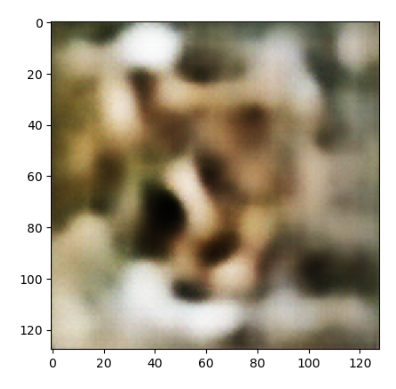

Epoch 81/200
Total Loss:  30231560.0
Epoch 82/200
Total Loss:  30183110.0
Epoch 83/200
Total Loss:  30205404.0
Epoch 84/200
Total Loss:  30222832.0
Epoch 85/200
Total Loss:  30166448.0
Epoch 86/200
Total Loss:  30025368.0
Epoch 87/200
Total Loss:  29911386.0
Epoch 88/200
Total Loss:  29811340.0
Epoch 89/200
Total Loss:  29722572.0
Epoch 90/200
Total Loss:  29702618.0


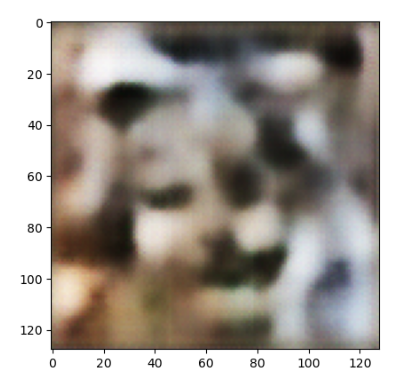

Epoch 91/200
Total Loss:  29669918.0
Epoch 92/200
Total Loss:  29699828.0
Epoch 93/200
Total Loss:  29734328.0
Epoch 94/200
Total Loss:  29759668.0
Epoch 95/200
Total Loss:  29707948.0
Epoch 96/200
Total Loss:  29666046.0
Epoch 97/200
Total Loss:  29607006.0
Epoch 98/200
Total Loss:  29477304.0
Epoch 99/200
Total Loss:  29345958.0
Epoch 100/200
Total Loss:  29245912.0


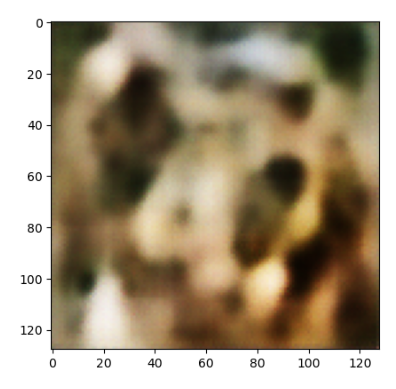

Epoch 101/200
Total Loss:  29165004.0
Epoch 102/200
Total Loss:  29110708.0
Epoch 103/200
Total Loss:  29026302.0
Epoch 104/200
Total Loss:  28929794.0
Epoch 105/200
Total Loss:  28877042.0
Epoch 106/200
Total Loss:  28816758.0
Epoch 107/200
Total Loss:  28773510.0
Epoch 108/200
Total Loss:  28720542.0
Epoch 109/200
Total Loss:  28692442.0
Epoch 110/200
Total Loss:  28679570.0


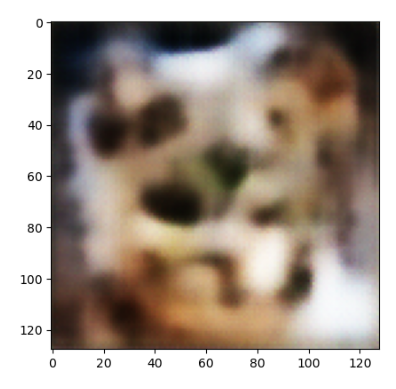

Epoch 111/200
Total Loss:  28678578.0
Epoch 112/200
Total Loss:  28673152.0
Epoch 113/200
Total Loss:  28695966.0
Epoch 114/200
Total Loss:  28730644.0
Epoch 115/200
Total Loss:  28726628.0
Epoch 116/200
Total Loss:  28745162.0
Epoch 117/200
Total Loss:  28745838.0
Epoch 118/200
Total Loss:  28719420.0
Epoch 119/200
Total Loss:  28666758.0
Epoch 120/200
Total Loss:  28653840.0


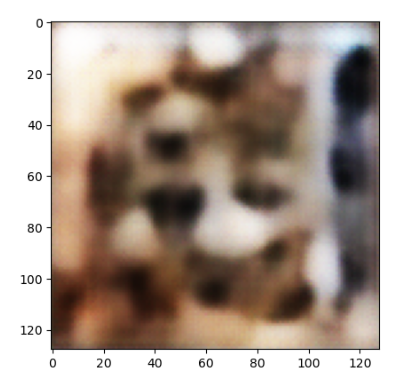

Epoch 121/200
Total Loss:  28681036.0
Epoch 122/200
Total Loss:  28718924.0
Epoch 123/200
Total Loss:  28830418.0
Epoch 124/200
Total Loss:  28694294.0
Epoch 125/200
Total Loss:  28446928.0
Epoch 126/200
Total Loss:  28292204.0
Epoch 127/200
Total Loss:  28222862.0
Epoch 128/200
Total Loss:  28191282.0
Epoch 129/200
Total Loss:  28175766.0
Epoch 130/200
Total Loss:  28213746.0


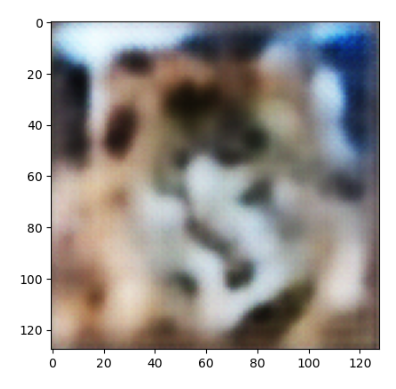

Epoch 131/200
Total Loss:  28250100.0
Epoch 132/200
Total Loss:  28184070.0
Epoch 133/200
Total Loss:  28143626.0
Epoch 134/200
Total Loss:  28128354.0
Epoch 135/200
Total Loss:  28120846.0
Epoch 136/200
Total Loss:  28158492.0
Epoch 137/200
Total Loss:  28161992.0
Epoch 138/200
Total Loss:  28163094.0
Epoch 139/200
Total Loss:  28205312.0
Epoch 140/200
Total Loss:  28283470.0


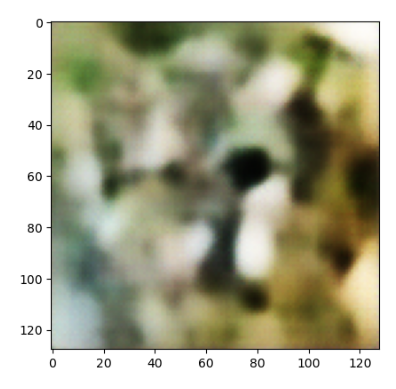

Epoch 141/200
Total Loss:  28305242.0
Epoch 142/200
Total Loss:  28238888.0
Epoch 143/200
Total Loss:  28240610.0
Epoch 144/200
Total Loss:  28227036.0
Epoch 145/200
Total Loss:  28175390.0
Epoch 146/200
Total Loss:  28089434.0
Epoch 147/200
Total Loss:  28021162.0
Epoch 148/200
Total Loss:  27907910.0
Epoch 149/200
Total Loss:  27802976.0
Epoch 150/200
Total Loss:  27720956.0


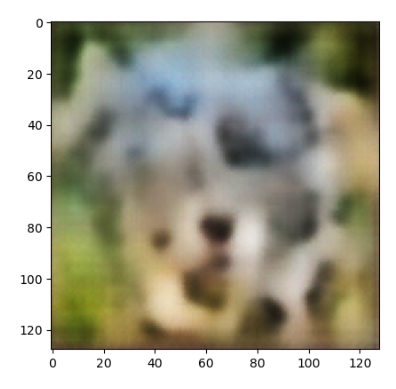

Epoch 151/200
Total Loss:  27631848.0
Epoch 152/200
Total Loss:  27556622.0
Epoch 153/200
Total Loss:  27473574.0
Epoch 154/200
Total Loss:  27385596.0
Epoch 155/200
Total Loss:  27266720.0
Epoch 156/200
Total Loss:  27171176.0
Epoch 157/200
Total Loss:  27105098.0
Epoch 158/200
Total Loss:  27048586.0
Epoch 159/200
Total Loss:  27003068.0
Epoch 160/200
Total Loss:  26970704.0


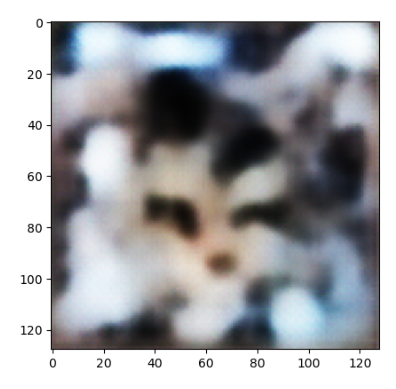

Epoch 161/200
Total Loss:  26941452.0
Epoch 162/200
Total Loss:  26904184.0
Epoch 163/200
Total Loss:  26870090.0
Epoch 164/200
Total Loss:  26837754.0
Epoch 165/200
Total Loss:  26826604.0
Epoch 166/200
Total Loss:  26852394.0
Epoch 167/200
Total Loss:  26873274.0
Epoch 168/200
Total Loss:  26915880.0
Epoch 169/200
Total Loss:  26953000.0
Epoch 170/200
Total Loss:  27008018.0


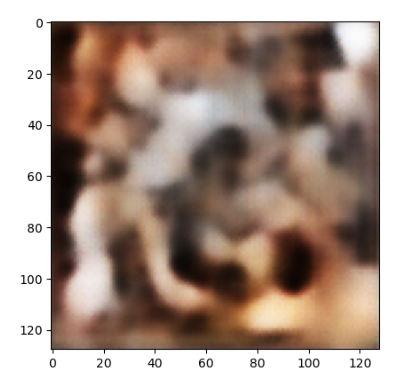

Epoch 171/200
Total Loss:  26977124.0
Epoch 172/200
Total Loss:  26948240.0
Epoch 173/200
Total Loss:  26916156.0
Epoch 174/200
Total Loss:  26907574.0
Epoch 175/200
Total Loss:  26821558.0
Epoch 176/200
Total Loss:  26719754.0
Epoch 177/200
Total Loss:  26638428.0
Epoch 178/200
Total Loss:  26614856.0
Epoch 179/200
Total Loss:  26588158.0
Epoch 180/200
Total Loss:  26515690.0


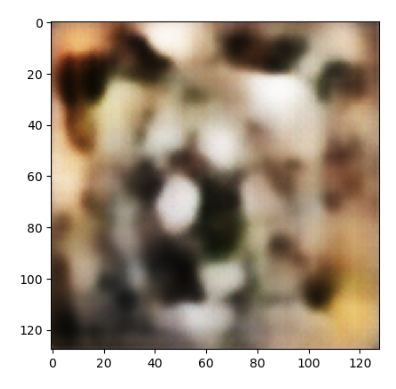

Epoch 181/200
Total Loss:  26407706.0
Epoch 182/200
Total Loss:  26347694.0
Epoch 183/200
Total Loss:  26244300.0
Epoch 184/200
Total Loss:  26217316.0
Epoch 185/200
Total Loss:  26194740.0
Epoch 186/200
Total Loss:  26181770.0
Epoch 187/200
Total Loss:  26181592.0
Epoch 188/200
Total Loss:  26179656.0
Epoch 189/200
Total Loss:  26186062.0
Epoch 190/200
Total Loss:  26189720.0


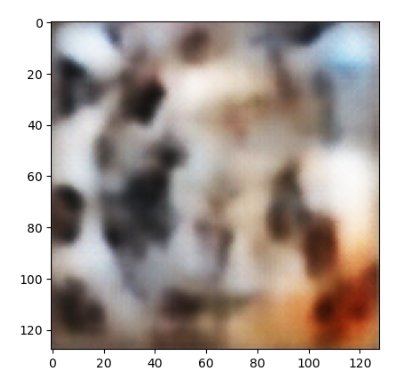

Epoch 191/200
Total Loss:  26203780.0
Epoch 192/200
Total Loss:  26248634.0
Epoch 193/200
Total Loss:  26255836.0
Epoch 194/200
Total Loss:  26246670.0
Epoch 195/200
Total Loss:  26172778.0
Epoch 196/200
Total Loss:  26092116.0
Epoch 197/200
Total Loss:  26018000.0
Epoch 198/200
Total Loss:  25960908.0
Epoch 199/200
Total Loss:  25996700.0
Epoch 200/200
Total Loss:  26071820.0


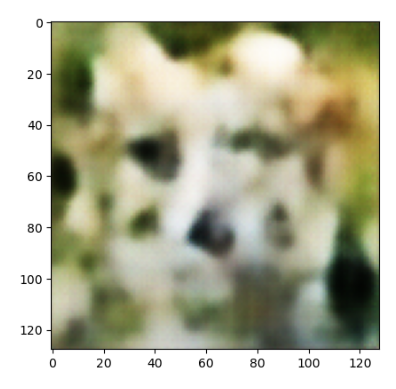

In [ ]:
# Training function
def train_vae(model, dataloader, epochs, learning_rate, beta=1, save_path='model_weights.pth', sample_interval=10):
    """
    Trains a Variational Autoencoder (VAE) model.

    Args:
        model (VAE): The VAE model to train.
        dataloader (torch.utils.data.DataLoader): The data loader for the training dataset.
        epochs (int): The number of epochs to train for.
        learning_rate (float): The learning rate for the optimizer.
        beta (float, optional): The beta parameter for the KL divergence loss. Defaults to 1.
        save_path (str, optional): The path to save the model weights. Defaults to 'model_weights.pth'.
        sample_interval (int, optional): The interval (in epochs) to sample and display images. Defaults to 10.

    Returns:
        list: A list containing the training loss for each epoch.
    """
    # Initialize optimizer
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    # Set device
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    model = model.to(device)

    # Training loop
    total_losses = []
    likelihood_losses = []
    kl_losses = []

    for epoch in range(epochs):
        print(f"Epoch {epoch + 1}/{epochs}")

        # Initialize epoch-level loss trackers
        epoch_total_loss = 0.0
        epoch_likelihood = 0.0
        epoch_KL = 0.0

        model.train()  # Set model to training mode
        for image_batch in dataloader:
            x = image_batch[0].to(device)

            # Forward pass
            x_chng, x_hat, mu, log_var = model(x)

            # Calculate loss
            loss, rec_loss, reg_loss = model.loss(x_chng, x_hat, mu, log_var)

            # Update epoch-level loss trackers
            epoch_total_loss += loss.item()
            epoch_likelihood += rec_loss.item()
            epoch_KL += reg_loss.item()

            # Backpropagation and optimization
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            # Clear GPU memory
            torch.cuda.empty_cache()

        # Print epoch loss
        print(f"Total Loss: {epoch_total_loss:.4f}")

        total_losses.append(epoch_total_loss)
        likelihood_losses.append(epoch_likelihood)
        kl_losses.append(epoch_KL)

        # Sample and display images every `sample_interval` epochs
        if (epoch + 1) % sample_interval == 0:
            model.eval()  # Set model to evaluation mode
            with torch.no_grad():
                y = model.sample(device, 10)
                y = y.cpu().detach().numpy()

                # Display a sample image
                img = y[0]
                img = img * 0.5 + 0.5
                img = np.transpose(img, (1, 2, 0))
                plt.imshow(img)
                plt.show()

        # Save model weights every `sample_interval` epochs
        if (epoch + 1) % sample_interval == 0:
            if os.path.exists(save_path):
                os.remove(save_path)
            torch.save(model.state_dict(), save_path)

    return total_losses, likelihood_losses, kl_losses

# Example usage:
# Assuming you have a dataloader and the VAE model defined
total_losses, likelihood_losses, kl_losses = train_vae(
    model=VAE(),
    dataloader=dataloader,
    epochs=200,
    learning_rate=0.0001,
    beta=1,
    save_path='/content/drive/My Drive/Project/DataSet/afhq/model_weights.pth'
)

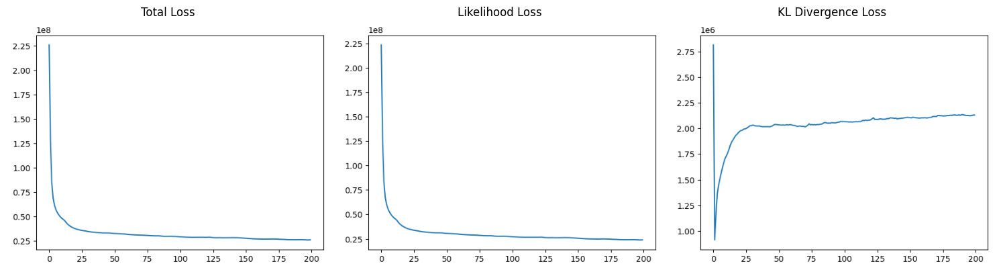

In [ ]:
# Plot the losses
plt.figure(figsize=(15, 4))

plt.subplot(1, 3, 1)
plt.plot(total_losses)
plt.title('Total Loss')

plt.subplot(1, 3, 2)
plt.plot(likelihood_losses)
plt.title('Likelihood Loss')

plt.subplot(1, 3, 3)
plt.plot(kl_losses)
plt.title('KL Divergence Loss')

plt.tight_layout()
plt.show()

### Beta = 1 and z_sample = 10

The beta value is set to 1, and the number of intermediate samples is 10.

Epoch 1/200
Total Loss: 147580000.0
Epoch 2/200
Total Loss: 76692792.0
Epoch 3/200
Total Loss: 63707096.0
Epoch 4/200
Total Loss: 57548868.0
Epoch 5/200
Total Loss: 53446204.0
Epoch 6/200
Total Loss: 50181344.0
Epoch 7/200
Total Loss: 46020812.0
Epoch 8/200
Total Loss: 43308872.0
Epoch 9/200
Total Loss: 41244328.0
Epoch 10/200
Total Loss: 39877832.0


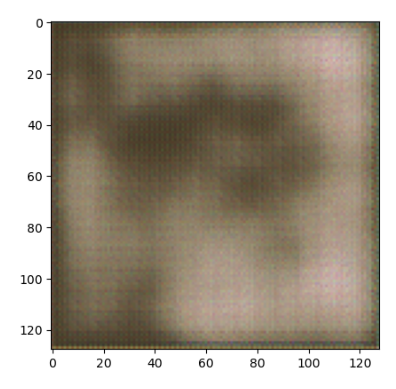

Epoch 11/200
Total Loss: 38777076.0
Epoch 12/200
Total Loss: 37859280.0
Epoch 13/200
Total Loss: 37041800.0
Epoch 14/200
Total Loss: 36456796.0
Epoch 15/200
Total Loss: 35744808.0
Epoch 16/200
Total Loss: 35135588.0
Epoch 17/200
Total Loss: 34841220.0
Epoch 18/200
Total Loss: 34451568.0
Epoch 19/200
Total Loss: 34252880.0
Epoch 20/200
Total Loss: 34087152.0


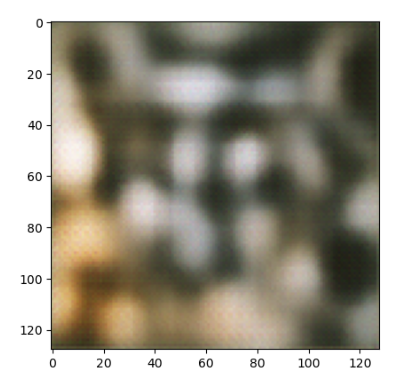

Epoch 21/200
Total Loss: 33949228.0
Epoch 22/200
Total Loss: 33819784.0
Epoch 23/200
Total Loss: 33535070.0
Epoch 24/200
Total Loss: 33340022.0
Epoch 25/200
Total Loss: 33275210.0
Epoch 26/200
Total Loss: 33149744.0
Epoch 27/200
Total Loss: 33058438.0
Epoch 28/200
Total Loss: 32976768.0
Epoch 29/200
Total Loss: 32896286.0
Epoch 30/200
Total Loss: 32810986.0


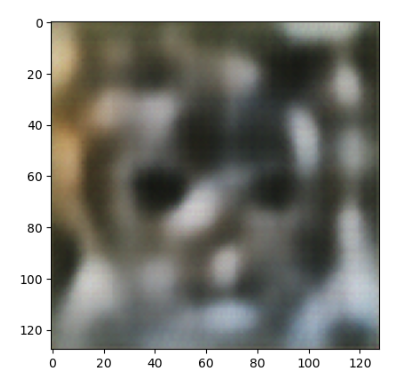

Epoch 31/200
Total Loss: 32728032.0
Epoch 32/200
Total Loss: 32538558.0
Epoch 33/200
Total Loss: 32539566.0
Epoch 34/200
Total Loss: 32362990.0
Epoch 35/200
Total Loss: 32321800.0
Epoch 36/200
Total Loss: 32074556.0
Epoch 37/200
Total Loss: 31796700.0
Epoch 38/200
Total Loss: 31661786.0
Epoch 39/200
Total Loss: 31806792.0
Epoch 40/200
Total Loss: 31407960.0


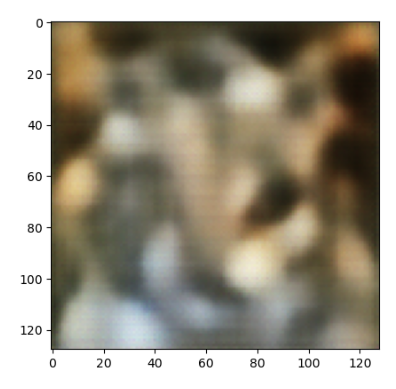

Epoch 41/200
Total Loss: 31030974.0
Epoch 42/200
Total Loss: 31019700.0
Epoch 43/200
Total Loss: 31131282.0
Epoch 44/200
Total Loss: 31314184.0
Epoch 45/200
Total Loss: 31563432.0
Epoch 46/200
Total Loss: 31591014.0
Epoch 47/200
Total Loss: 31110942.0
Epoch 48/200
Total Loss: 31087396.0
Epoch 49/200
Total Loss: 30778746.0
Epoch 50/200
Total Loss: 30584698.0


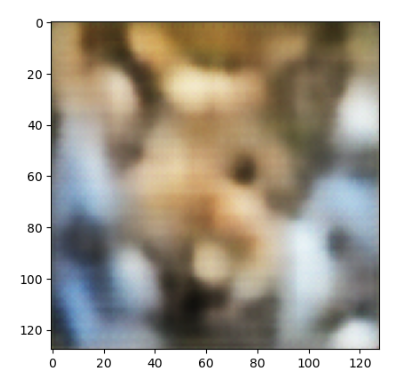

Epoch 51/200
Total Loss: 30225532.0
Epoch 52/200
Total Loss: 30035032.0
Epoch 53/200
Total Loss: 29920024.0
Epoch 54/200
Total Loss: 29713150.0
Epoch 55/200
Total Loss: 29717772.0
Epoch 56/200
Total Loss: 29913574.0
Epoch 57/200
Total Loss: 29718534.0
Epoch 58/200
Total Loss: 29799162.0
Epoch 59/200
Total Loss: 29861176.0
Epoch 60/200
Total Loss: 29744100.0


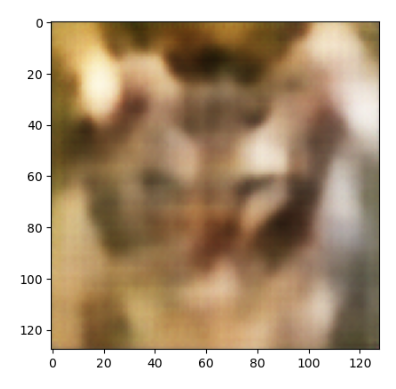

Epoch 61/200
Total Loss: 29465696.0
Epoch 62/200
Total Loss: 29376604.0
Epoch 63/200
Total Loss: 29433638.0
Epoch 64/200
Total Loss: 29596556.0
Epoch 65/200
Total Loss: 29792496.0
Epoch 66/200
Total Loss: 29526356.0
Epoch 67/200
Total Loss: 29021748.0
Epoch 68/200
Total Loss: 28738916.0
Epoch 69/200
Total Loss: 28537318.0
Epoch 70/200
Total Loss: 28494394.0


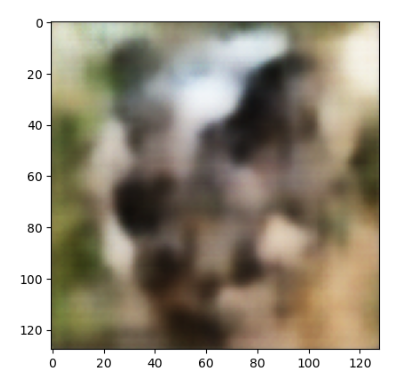

Epoch 71/200
Total Loss: 28479458.0
Epoch 72/200
Total Loss: 28357152.0
Epoch 73/200
Total Loss: 28279768.0
Epoch 74/200
Total Loss: 28605690.0
Epoch 75/200
Total Loss: 28044680.0
Epoch 76/200
Total Loss: 27959820.0
Epoch 77/200
Total Loss: 28062248.0
Epoch 78/200
Total Loss: 28400082.0
Epoch 79/200
Total Loss: 28037950.0
Epoch 80/200
Total Loss: 27508056.0


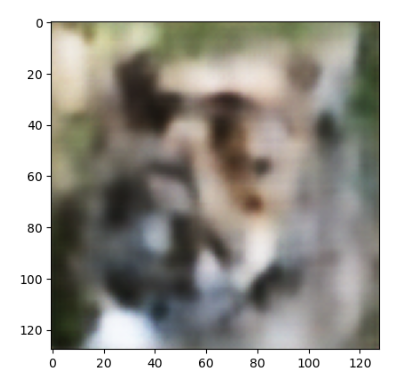

Epoch 81/200
Total Loss: 27048482.0
Epoch 82/200
Total Loss: 27053052.0
Epoch 83/200
Total Loss: 27329358.0
Epoch 84/200
Total Loss: 27616362.0
Epoch 85/200
Total Loss: 27360864.0
Epoch 86/200
Total Loss: 26991932.0
Epoch 87/200
Total Loss: 26823170.0
Epoch 88/200
Total Loss: 27348742.0
Epoch 89/200
Total Loss: 27957422.0
Epoch 90/200
Total Loss: 27139510.0


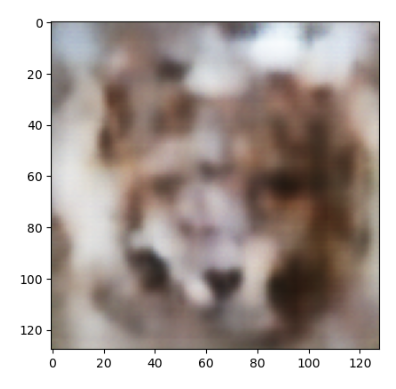

Epoch 91/200
Total Loss: 26560412.0
Epoch 92/200
Total Loss: 26376500.0
Epoch 93/200
Total Loss: 26373282.0
Epoch 94/200
Total Loss: 26425428.0
Epoch 95/200
Total Loss: 26749366.0
Epoch 96/200
Total Loss: 26784310.0
Epoch 97/200
Total Loss: 26594194.0
Epoch 98/200
Total Loss: 27565914.0
Epoch 99/200
Total Loss: 27107902.0
Epoch 100/200
Total Loss: 26052668.0


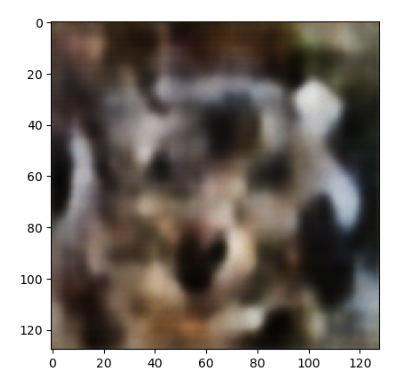

Epoch 101/200
Total Loss: 25621558.0
Epoch 102/200
Total Loss: 25322192.0
Epoch 103/200
Total Loss: 25314784.0
Epoch 104/200
Total Loss: 25611112.0
Epoch 105/200
Total Loss: 25965954.0
Epoch 106/200
Total Loss: 25750350.0
Epoch 107/200
Total Loss: 25293002.0
Epoch 108/200
Total Loss: 25132856.0
Epoch 109/200
Total Loss: 25020202.0
Epoch 110/200
Total Loss: 24987792.0


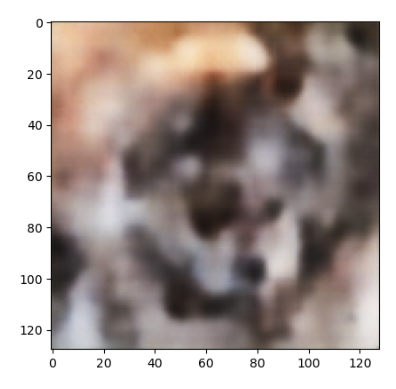

Epoch 111/200
Total Loss: 25094668.0
Epoch 112/200
Total Loss: 25419192.0
Epoch 113/200
Total Loss: 26049486.0
Epoch 114/200
Total Loss: 26638048.0
Epoch 115/200
Total Loss: 26278798.0
Epoch 116/200
Total Loss: 25832618.0
Epoch 117/200
Total Loss: 25401834.0
Epoch 118/200
Total Loss: 25288786.0
Epoch 119/200
Total Loss: 25338370.0
Epoch 120/200
Total Loss: 25572960.0


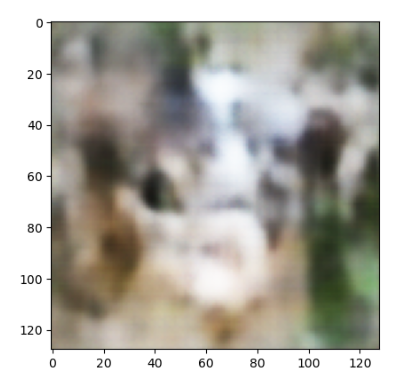

Epoch 121/200
Total Loss: 25577556.0
Epoch 122/200
Total Loss: 25341436.0
Epoch 123/200
Total Loss: 25345484.0
Epoch 124/200
Total Loss: 25320598.0
Epoch 125/200
Total Loss: 24678770.0
Epoch 126/200
Total Loss: 24347634.0
Epoch 127/200
Total Loss: 24245916.0
Epoch 128/200
Total Loss: 24339246.0
Epoch 129/200
Total Loss: 24536238.0
Epoch 130/200
Total Loss: 24705924.0


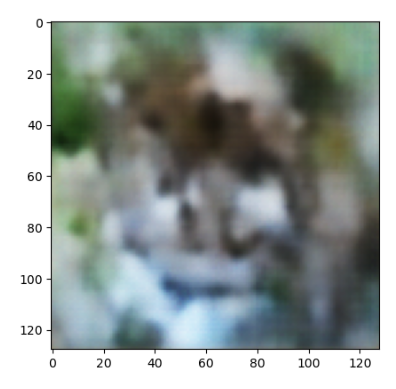

Epoch 131/200
Total Loss: 24836328.0
Epoch 132/200
Total Loss: 24489664.0
Epoch 133/200
Total Loss: 24442202.0
Epoch 134/200
Total Loss: 24458338.0
Epoch 135/200
Total Loss: 24328562.0
Epoch 136/200
Total Loss: 24278820.0
Epoch 137/200
Total Loss: 24147020.0
Epoch 138/200
Total Loss: 24053908.0
Epoch 139/200
Total Loss: 24094304.0
Epoch 140/200
Total Loss: 24434948.0


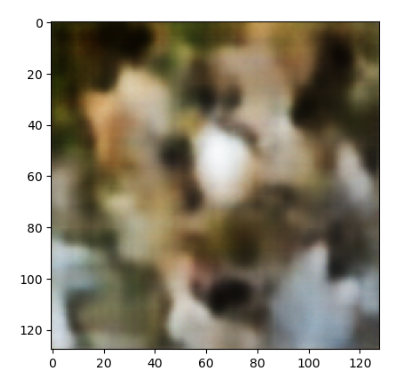

Epoch 141/200
Total Loss: 24286612.0
Epoch 142/200
Total Loss: 23782634.0
Epoch 143/200
Total Loss: 23740838.0
Epoch 144/200
Total Loss: 24121616.0
Epoch 145/200
Total Loss: 24164658.0
Epoch 146/200
Total Loss: 24053734.0
Epoch 147/200
Total Loss: 24171064.0
Epoch 148/200
Total Loss: 24675498.0
Epoch 149/200
Total Loss: 24720574.0
Epoch 150/200
Total Loss: 23832472.0


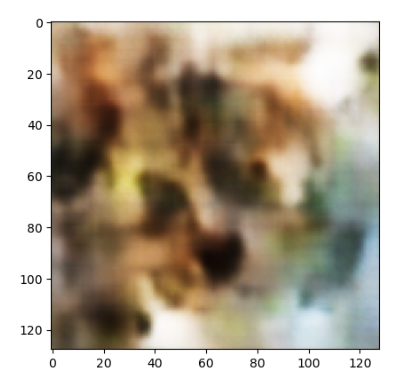

Epoch 151/200
Total Loss: 23132212.0
Epoch 152/200
Total Loss: 22947540.0
Epoch 153/200
Total Loss: 22937932.0
Epoch 154/200
Total Loss: 23091848.0
Epoch 155/200
Total Loss: 23327382.0
Epoch 156/200
Total Loss: 23704998.0
Epoch 157/200
Total Loss: 24011398.0
Epoch 158/200
Total Loss: 23491228.0
Epoch 159/200
Total Loss: 23044880.0
Epoch 160/200
Total Loss: 22973160.0


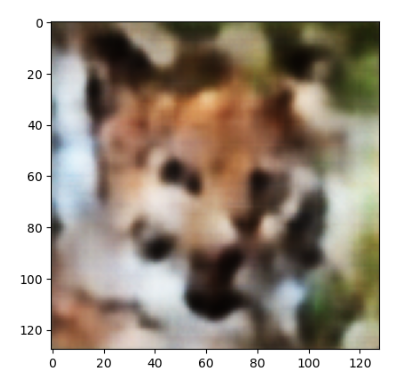

Epoch 161/200
Total Loss: 22909526.0
Epoch 162/200
Total Loss: 22936422.0
Epoch 163/200
Total Loss: 23077932.0
Epoch 164/200
Total Loss: 23419486.0
Epoch 165/200
Total Loss: 23698832.0
Epoch 166/200
Total Loss: 23574108.0
Epoch 167/200
Total Loss: 23558102.0
Epoch 168/200
Total Loss: 23354442.0
Epoch 169/200
Total Loss: 23264950.0
Epoch 170/200
Total Loss: 22920540.0


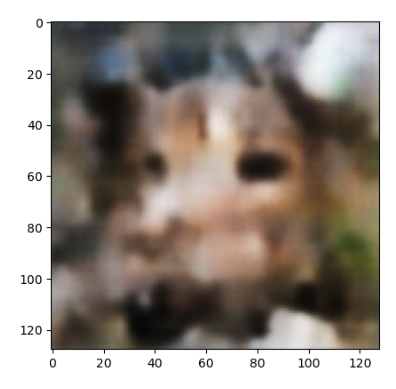

Epoch 171/200
Total Loss: 22440410.0
Epoch 172/200
Total Loss: 22248488.0
Epoch 173/200
Total Loss: 22216096.0
Epoch 174/200
Total Loss: 22253118.0
Epoch 175/200
Total Loss: 22382680.0
Epoch 176/200
Total Loss: 22454110.0
Epoch 177/200
Total Loss: 22554094.0
Epoch 178/200
Total Loss: 22676644.0
Epoch 179/200
Total Loss: 22724084.0
Epoch 180/200
Total Loss: 22822546.0


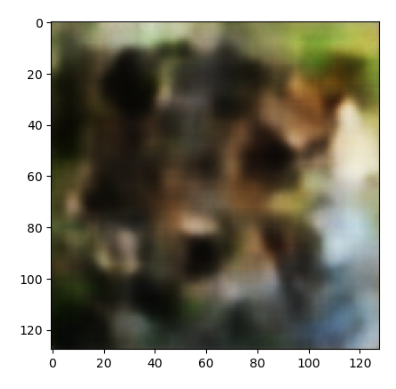

Epoch 181/200
Total Loss: 22833042.0
Epoch 182/200
Total Loss: 22904466.0
Epoch 183/200
Total Loss: 22622264.0
Epoch 184/200
Total Loss: 22495560.0
Epoch 185/200
Total Loss: 22425674.0
Epoch 186/200
Total Loss: 22770042.0
Epoch 187/200
Total Loss: 22802638.0
Epoch 188/200
Total Loss: 22432680.0
Epoch 189/200
Total Loss: 22217080.0
Epoch 190/200
Total Loss: 22232264.0


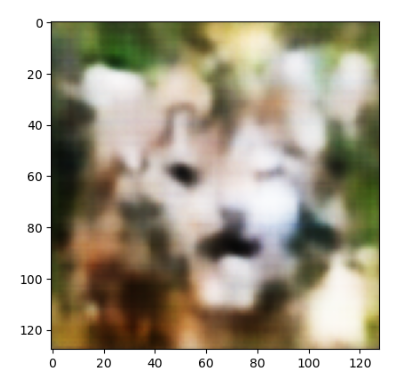

Epoch 191/200
Total Loss: 22381972.0
Epoch 192/200
Total Loss: 22567136.0
Epoch 193/200
Total Loss: 23322862.0
Epoch 194/200
Total Loss: 23369022.0
Epoch 195/200
Total Loss: 22763184.0
Epoch 196/200
Total Loss: 22282604.0
Epoch 197/200
Total Loss: 22052508.0
Epoch 198/200
Total Loss: 21960232.0
Epoch 199/200
Total Loss: 21972814.0
Epoch 200/200
Total Loss: 22119952.0


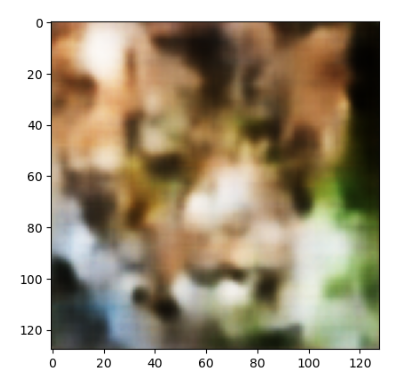

In [ ]:
# Training function
def train_vae(model, dataloader, epochs, learning_rate, beta=1, save_path='model_weights.pth', sample_interval=10):
    """
    Trains a Variational Autoencoder (VAE) model.

    Args:
        model (VAE): The VAE model to train.
        dataloader (torch.utils.data.DataLoader): The data loader for the training dataset.
        epochs (int): The number of epochs to train for.
        learning_rate (float): The learning rate for the optimizer.
        beta (float, optional): The beta parameter for the KL divergence loss. Defaults to 1.
        save_path (str, optional): The path to save the model weights. Defaults to 'model_weights.pth'.
        sample_interval (int, optional): The interval (in epochs) to sample and display images. Defaults to 10.

    Returns:
        tuple: A tuple containing lists of training losses for each epoch:
            - total_losses: Total loss for each epoch.
            - likelihood_losses: Likelihood loss for each epoch.
            - kl_losses: KL divergence loss for each epoch.
    """
    # Initialize optimizer
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    # Set device
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    model = model.to(device)

    # Training loop
    total_losses = []
    likelihood_losses = []
    kl_losses = []

    for epoch in range(epochs):
        print(f"Epoch {epoch + 1}/{epochs}")

        # Initialize epoch-level loss trackers
        epoch_total_loss = 0.0
        epoch_likelihood = 0.0
        epoch_KL = 0.0

        model.train()  # Set model to training mode
        for image_batch in dataloader:
            x = image_batch[0].to(device)

            # Forward pass
            x_chng, x_hat, mu, log_var = model(x)

            # Calculate loss
            loss, rec_loss, reg_loss = model.loss(x_chng, x_hat, mu, log_var)

            # Update epoch-level loss trackers
            epoch_total_loss += loss.item()
            epoch_likelihood += rec_loss.item()
            epoch_KL += reg_loss.item()

            # Backpropagation and optimization
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            # Clear GPU memory
            torch.cuda.empty_cache()

        # Print epoch loss
        print(f"Total Loss: {epoch_total_loss:.4f}")

        total_losses.append(epoch_total_loss)
        likelihood_losses.append(epoch_likelihood)
        kl_losses.append(epoch_KL)

        # Sample and display images every `sample_interval` epochs
        if (epoch + 1) % sample_interval == 0:
            model.eval()  # Set model to evaluation mode
            with torch.no_grad():
                y = model.sample(device, 10)  # Generate 10 samples
                y = y.cpu().detach().numpy()

                # Display a sample image (choose the first one)
                img = y[0]
                img = img * 0.5 + 0.5
                img = np.transpose(img, (1, 2, 0))
                plt.imshow(img)
                plt.show()

        # Save model weights every `sample_interval` epochs
        if (epoch + 1) % sample_interval == 0:
            if os.path.exists(save_path):
                os.remove(save_path)
            torch.save(model.state_dict(), save_path)

    return total_losses, likelihood_losses, kl_losses

total_losses, likelihood_losses, kl_losses = train_vae(
    model=VAE(z_sample=10),  # Initialize VAE with z_sample=10
    dataloader=dataloader,
    epochs=200,
    learning_rate=0.001,
    beta=1,
    save_path='/content/drive/My Drive/Project/DataSet/afhq/model_weights.pth'
)

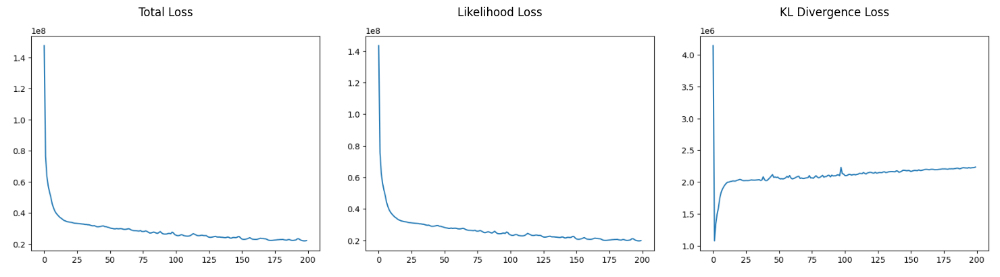

In [ ]:
# Plot the losses
plt.figure(figsize=(15, 4))

plt.subplot(1, 3, 1)
plt.plot(total_losses)
plt.title('Total Loss')

plt.subplot(1, 3, 2)
plt.plot(likelihood_losses)
plt.title('Likelihood Loss')

plt.subplot(1, 3, 3)
plt.plot(kl_losses)
plt.title('KL Divergence Loss')

plt.tight_layout()
plt.show()

### Beta = 10 and z_sample = 1

---



The beta value is set to 10, and we use one intermediate sample.

Epoch 1/200
Total Loss: 140500000.0
Epoch 2/200
Total Loss: 82712280.0
Epoch 3/200
Total Loss: 72462056.0
Epoch 4/200
Total Loss: 66436708.0
Epoch 5/200
Total Loss: 63069916.0
Epoch 6/200
Total Loss: 60498084.0
Epoch 7/200
Total Loss: 58623060.0
Epoch 8/200
Total Loss: 56719100.0
Epoch 9/200
Total Loss: 55786344.0
Epoch 10/200
Total Loss: 54544692.0


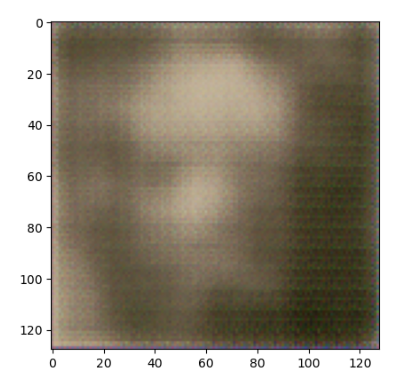

Epoch 11/200
Total Loss: 53058672.0
Epoch 12/200
Total Loss: 50943908.0
Epoch 13/200
Total Loss: 49227728.0
Epoch 14/200
Total Loss: 48048764.0
Epoch 15/200
Total Loss: 47053232.0
Epoch 16/200
Total Loss: 46011968.0
Epoch 17/200
Total Loss: 45334844.0
Epoch 18/200
Total Loss: 44993288.0
Epoch 19/200
Total Loss: 44531832.0
Epoch 20/200
Total Loss: 44109316.0


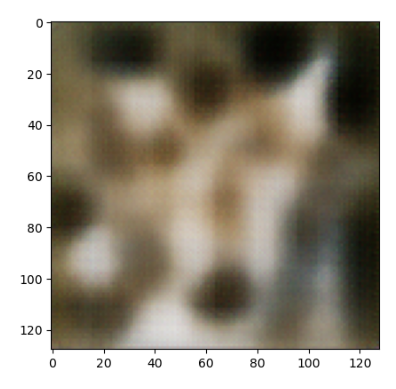

Epoch 21/200
Total Loss: 43723012.0
Epoch 22/200
Total Loss: 43468972.0
Epoch 23/200
Total Loss: 43212120.0
Epoch 24/200
Total Loss: 42855100.0
Epoch 25/200
Total Loss: 42444084.0
Epoch 26/200
Total Loss: 42074564.0
Epoch 27/200
Total Loss: 41906476.0
Epoch 28/200
Total Loss: 41694676.0
Epoch 29/200
Total Loss: 41437528.0
Epoch 30/200
Total Loss: 41217180.0


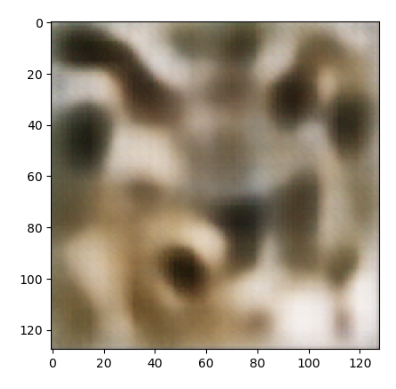

Epoch 31/200
Total Loss: 41092572.0
Epoch 32/200
Total Loss: 41082028.0
Epoch 33/200
Total Loss: 40927860.0
Epoch 34/200
Total Loss: 40777156.0
Epoch 35/200
Total Loss: 40685052.0
Epoch 36/200
Total Loss: 40522356.0
Epoch 37/200
Total Loss: 40220000.0
Epoch 38/200
Total Loss: 40016548.0
Epoch 39/200
Total Loss: 39915372.0
Epoch 40/200
Total Loss: 39881264.0


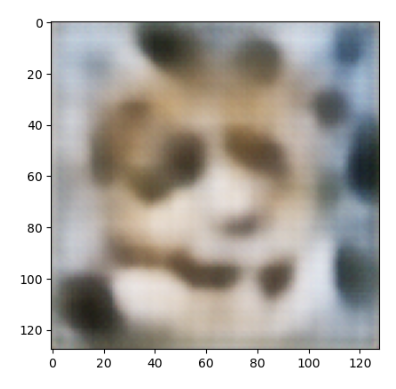

Epoch 41/200
Total Loss: 39729024.0
Epoch 42/200
Total Loss: 39597232.0
Epoch 43/200
Total Loss: 39391356.0
Epoch 44/200
Total Loss: 39270072.0
Epoch 45/200
Total Loss: 39275264.0
Epoch 46/200
Total Loss: 39252976.0
Epoch 47/200
Total Loss: 39521844.0
Epoch 48/200
Total Loss: 40141952.0
Epoch 49/200
Total Loss: 39385052.0
Epoch 50/200
Total Loss: 39272852.0


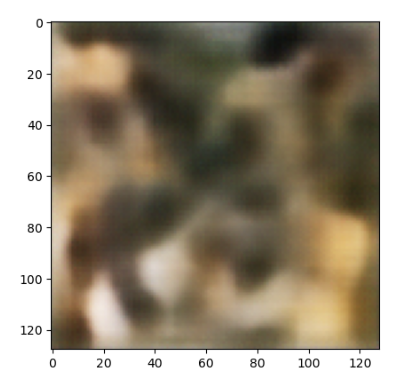

Epoch 51/200
Total Loss: 39112324.0
Epoch 52/200
Total Loss: 39184080.0
Epoch 53/200
Total Loss: 39223928.0
Epoch 54/200
Total Loss: 38999744.0
Epoch 55/200
Total Loss: 38843804.0
Epoch 56/200
Total Loss: 38497776.0
Epoch 57/200
Total Loss: 38314808.0
Epoch 58/200
Total Loss: 38139156.0
Epoch 59/200
Total Loss: 38253612.0
Epoch 60/200
Total Loss: 38351224.0


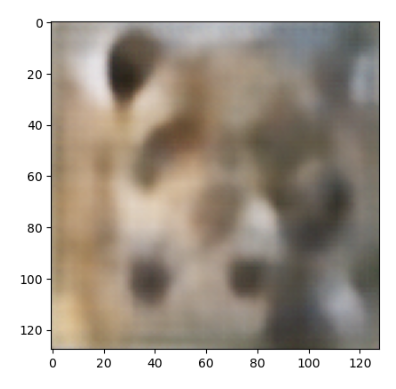

Epoch 61/200
Total Loss: 38477620.0
Epoch 62/200
Total Loss: 38446620.0
Epoch 63/200
Total Loss: 38271244.0
Epoch 64/200
Total Loss: 38083908.0
Epoch 65/200
Total Loss: 38076960.0
Epoch 66/200
Total Loss: 37781456.0
Epoch 67/200
Total Loss: 37630052.0
Epoch 68/200
Total Loss: 37413600.0
Epoch 69/200
Total Loss: 37227160.0
Epoch 70/200
Total Loss: 37071620.0


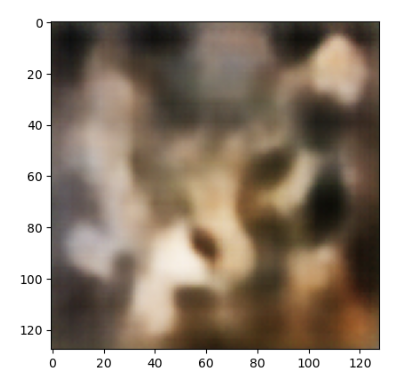

Epoch 71/200
Total Loss: 37030492.0
Epoch 72/200
Total Loss: 37155476.0
Epoch 73/200
Total Loss: 37371124.0
Epoch 74/200
Total Loss: 37372440.0
Epoch 75/200
Total Loss: 37465480.0
Epoch 76/200
Total Loss: 37126076.0
Epoch 77/200
Total Loss: 36635020.0
Epoch 78/200
Total Loss: 36691356.0
Epoch 79/200
Total Loss: 36890508.0
Epoch 80/200
Total Loss: 36675332.0


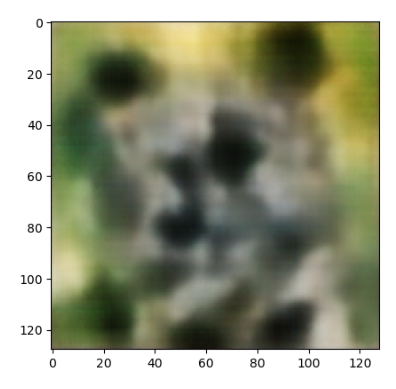

Epoch 81/200
Total Loss: 36697656.0
Epoch 82/200
Total Loss: 36865412.0
Epoch 83/200
Total Loss: 37058692.0
Epoch 84/200
Total Loss: 36750128.0
Epoch 85/200
Total Loss: 36798172.0
Epoch 86/200
Total Loss: 37202444.0
Epoch 87/200
Total Loss: 37181376.0
Epoch 88/200
Total Loss: 36888808.0
Epoch 89/200
Total Loss: 36676868.0
Epoch 90/200
Total Loss: 36544824.0


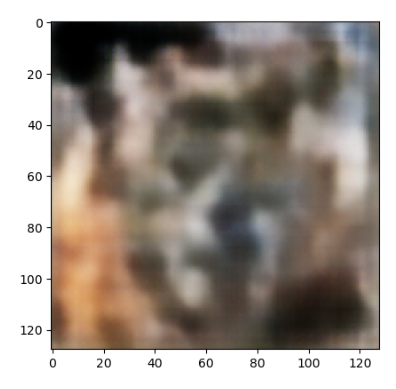

Epoch 91/200
Total Loss: 36734532.0
Epoch 92/200
Total Loss: 37119556.0
Epoch 93/200
Total Loss: 37069500.0
Epoch 94/200
Total Loss: 37161312.0
Epoch 95/200
Total Loss: 36967304.0
Epoch 96/200
Total Loss: 36310592.0
Epoch 97/200
Total Loss: 36187956.0
Epoch 98/200
Total Loss: 36350120.0
Epoch 99/200
Total Loss: 36471028.0
Epoch 100/200
Total Loss: 36948092.0


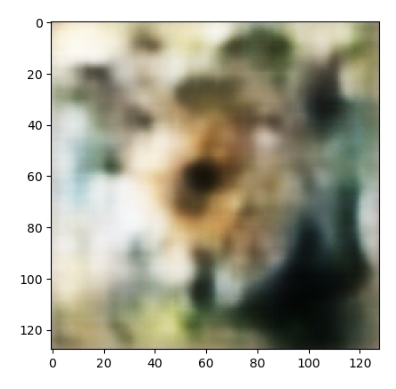

Epoch 101/200
Total Loss: 36715484.0
Epoch 102/200
Total Loss: 36307132.0
Epoch 103/200
Total Loss: 35691172.0
Epoch 104/200
Total Loss: 35416968.0
Epoch 105/200
Total Loss: 35439180.0
Epoch 106/200
Total Loss: 35181436.0
Epoch 107/200
Total Loss: 35015888.0
Epoch 108/200
Total Loss: 34997592.0
Epoch 109/200
Total Loss: 34914212.0
Epoch 110/200
Total Loss: 35029464.0


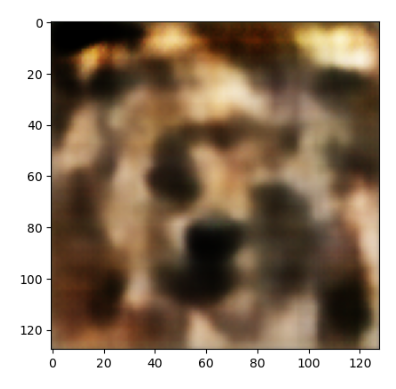

Epoch 111/200
Total Loss: 35152552.0
Epoch 112/200
Total Loss: 35357064.0
Epoch 113/200
Total Loss: 35924864.0
Epoch 114/200
Total Loss: 35563512.0
Epoch 115/200
Total Loss: 35689404.0
Epoch 116/200
Total Loss: 35503360.0
Epoch 117/200
Total Loss: 35353244.0
Epoch 118/200
Total Loss: 34912992.0
Epoch 119/200
Total Loss: 34441032.0
Epoch 120/200
Total Loss: 34499108.0


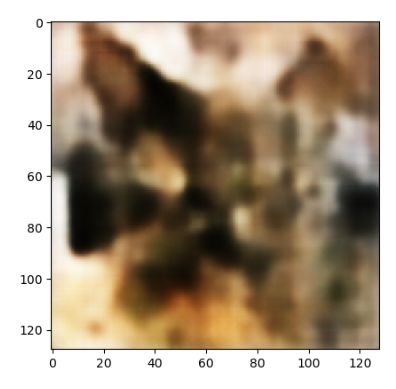

Epoch 121/200
Total Loss: 34394084.0
Epoch 122/200
Total Loss: 34480776.0
Epoch 123/200
Total Loss: 34799356.0
Epoch 124/200
Total Loss: 35153672.0
Epoch 125/200
Total Loss: 34946636.0
Epoch 126/200
Total Loss: 34317456.0
Epoch 127/200
Total Loss: 34081028.0
Epoch 128/200
Total Loss: 34075812.0
Epoch 129/200
Total Loss: 34092260.0
Epoch 130/200
Total Loss: 34520164.0


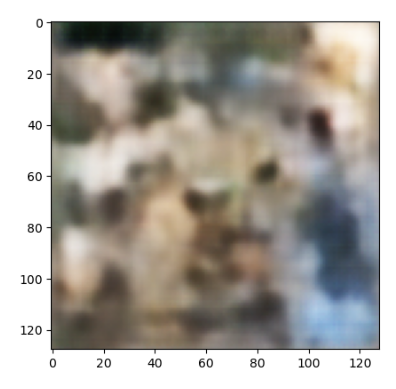

Epoch 131/200
Total Loss: 34600960.0
Epoch 132/200
Total Loss: 34370520.0
Epoch 133/200
Total Loss: 34260000.0
Epoch 134/200
Total Loss: 33753284.0
Epoch 135/200
Total Loss: 33628944.0
Epoch 136/200
Total Loss: 33758832.0
Epoch 137/200
Total Loss: 33858476.0
Epoch 138/200
Total Loss: 33757404.0
Epoch 139/200
Total Loss: 33870496.0
Epoch 140/200
Total Loss: 34308684.0


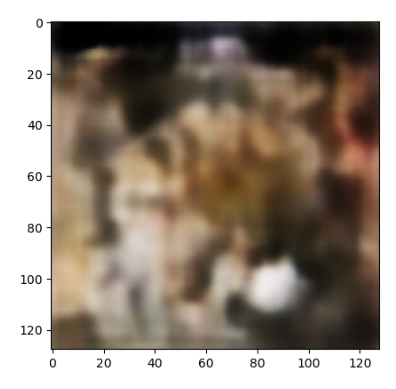

Epoch 141/200
Total Loss: 34303848.0
Epoch 142/200
Total Loss: 33627840.0
Epoch 143/200
Total Loss: 33278036.0
Epoch 144/200
Total Loss: 33130736.0
Epoch 145/200
Total Loss: 33179504.0
Epoch 146/200
Total Loss: 33459236.0
Epoch 147/200
Total Loss: 33762060.0
Epoch 148/200
Total Loss: 33881020.0
Epoch 149/200
Total Loss: 34188404.0
Epoch 150/200
Total Loss: 34266696.0


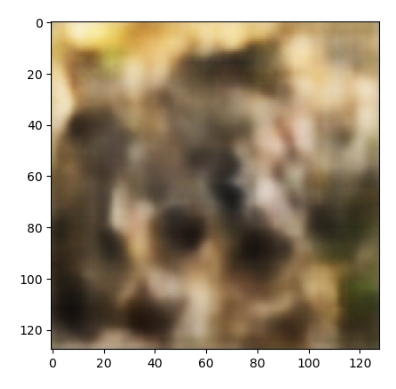

Epoch 151/200
Total Loss: 34237964.0
Epoch 152/200
Total Loss: 33651696.0
Epoch 153/200
Total Loss: 33308346.0
Epoch 154/200
Total Loss: 33195890.0
Epoch 155/200
Total Loss: 33195792.0
Epoch 156/200
Total Loss: 33462380.0
Epoch 157/200
Total Loss: 33934796.0
Epoch 158/200
Total Loss: 33483390.0
Epoch 159/200
Total Loss: 33138898.0
Epoch 160/200
Total Loss: 33096998.0


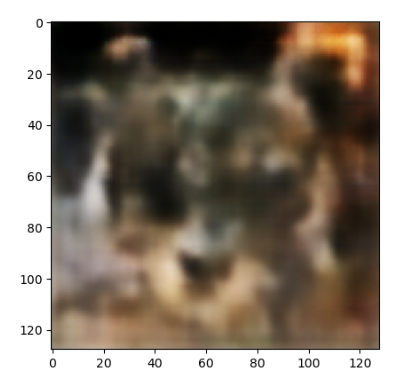

Epoch 161/200
Total Loss: 33456660.0
Epoch 162/200
Total Loss: 33403236.0
Epoch 163/200
Total Loss: 33203742.0
Epoch 164/200
Total Loss: 32957834.0
Epoch 165/200
Total Loss: 33038826.0
Epoch 166/200
Total Loss: 32925106.0
Epoch 167/200
Total Loss: 32856080.0
Epoch 168/200
Total Loss: 32996588.0
Epoch 169/200
Total Loss: 32986520.0
Epoch 170/200
Total Loss: 32906308.0


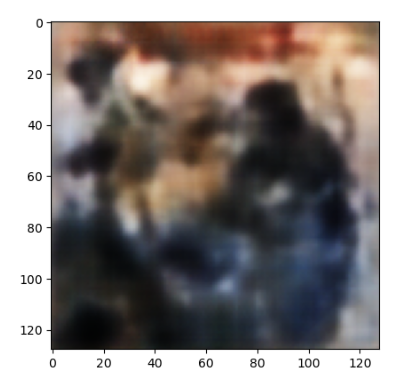

Epoch 171/200
Total Loss: 33020642.0
Epoch 172/200
Total Loss: 33138016.0
Epoch 173/200
Total Loss: 33025948.0
Epoch 174/200
Total Loss: 32920976.0
Epoch 175/200
Total Loss: 32724976.0
Epoch 176/200
Total Loss: 33060874.0
Epoch 177/200
Total Loss: 33209048.0
Epoch 178/200
Total Loss: 33553812.0
Epoch 179/200
Total Loss: 34208352.0
Epoch 180/200
Total Loss: 33551452.0


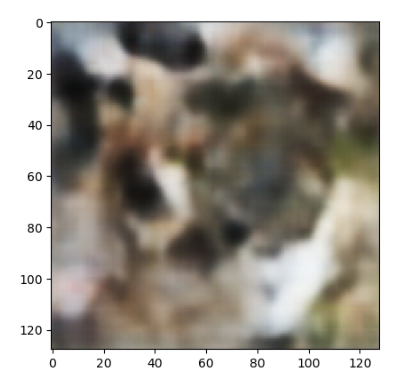

Epoch 181/200
Total Loss: 32870490.0
Epoch 182/200
Total Loss: 32245976.0
Epoch 183/200
Total Loss: 32133386.0
Epoch 184/200
Total Loss: 32040504.0
Epoch 185/200
Total Loss: 32003522.0
Epoch 186/200
Total Loss: 31967182.0
Epoch 187/200
Total Loss: 31960830.0
Epoch 188/200
Total Loss: 32106776.0
Epoch 189/200
Total Loss: 32539698.0
Epoch 190/200
Total Loss: 33353960.0


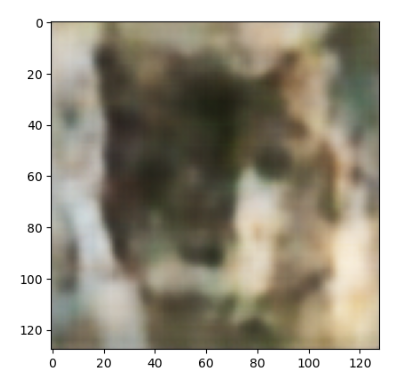

Epoch 191/200
Total Loss: 33257114.0
Epoch 192/200
Total Loss: 32706476.0
Epoch 193/200
Total Loss: 32095724.0
Epoch 194/200
Total Loss: 31854322.0
Epoch 195/200
Total Loss: 31736410.0
Epoch 196/200
Total Loss: 31738702.0
Epoch 197/200
Total Loss: 31839702.0
Epoch 198/200
Total Loss: 32018040.0
Epoch 199/200
Total Loss: 32262812.0
Epoch 200/200
Total Loss: 32505612.0


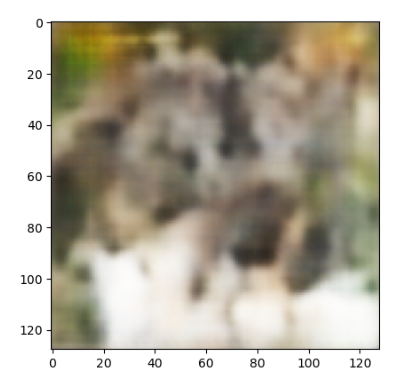

In [ ]:
# Training function
def train_vae(model, dataloader, epochs, learning_rate, beta=10, save_path='model_weights.pth', sample_interval=10):
    """
    Trains a Variational Autoencoder (VAE) model.

    Args:
        model (VAE): The VAE model to train.
        dataloader (torch.utils.data.DataLoader): The data loader for the training dataset.
        epochs (int): The number of epochs to train for.
        learning_rate (float): The learning rate for the optimizer.
        beta (float, optional): The beta parameter for the KL divergence loss. Defaults to 1.
        save_path (str, optional): The path to save the model weights. Defaults to 'model_weights.pth'.
        sample_interval (int, optional): The interval (in epochs) to sample and display images. Defaults to 10.

    Returns:
        tuple: A tuple containing lists of training losses for each epoch:
            - total_losses: Total loss for each epoch.
            - likelihood_losses: Likelihood loss for each epoch.
            - kl_losses: KL divergence loss for each epoch.
    """
    # Initialize optimizer
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    # Set device
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    model = model.to(device)

    # Training loop
    total_losses = []
    likelihood_losses = []
    kl_losses = []

    for epoch in range(epochs):
        print(f"Epoch {epoch + 1}/{epochs}")

        # Initialize epoch-level loss trackers
        epoch_total_loss = 0.0
        epoch_likelihood = 0.0
        epoch_KL = 0.0

        model.train()  # Set model to training mode
        for image_batch in dataloader:
            x = image_batch[0].to(device)

            # Forward pass
            x_chng, x_hat, mu, log_var = model(x)

            # Calculate loss
            loss, rec_loss, reg_loss = model.loss(x_chng, x_hat, mu, log_var)

            # Update epoch-level loss trackers
            epoch_total_loss += loss.item()
            epoch_likelihood += rec_loss.item()
            epoch_KL += reg_loss.item()

            # Backpropagation and optimization
            optimizer.zero_grad()  # Clear gradients
            loss.backward()  # Calculate gradients
            optimizer.step()  # Update weights

            # Clear GPU memory
            torch.cuda.empty_cache()

        # Print epoch loss
        print(f"Total Loss: {epoch_total_loss:.4f}")

        total_losses.append(epoch_total_loss)
        likelihood_losses.append(epoch_likelihood)
        kl_losses.append(epoch_KL)

        # Sample and display images every `sample_interval` epochs
        if (epoch + 1) % sample_interval == 0:
            model.eval()  # Set model to evaluation mode
            with torch.no_grad():
                y = model.sample(device, 10)  # Generate 10 samples
                y = y.cpu().detach().numpy()

                # Display a sample image (choose the first one)
                img = y[0]
                img = img * 0.5 + 0.5
                img = np.transpose(img, (1, 2, 0))
                plt.imshow(img)
                plt.show()

        # Save model weights every `sample_interval` epochs
        if (epoch + 1) % sample_interval == 0:
            if os.path.exists(save_path):
                os.remove(save_path)
            torch.save(model.state_dict(), save_path)

    return total_losses, likelihood_losses, kl_losses

total_losses, likelihood_losses, kl_losses = train_vae(
    model=VAE(beta=10),  # Initialize VAE with beta=10
    dataloader=dataloader,
    epochs=200,
    learning_rate=0.001,
    save_path='/content/drive/My Drive/Project/DataSet/afhq/model_weights.pth'
)

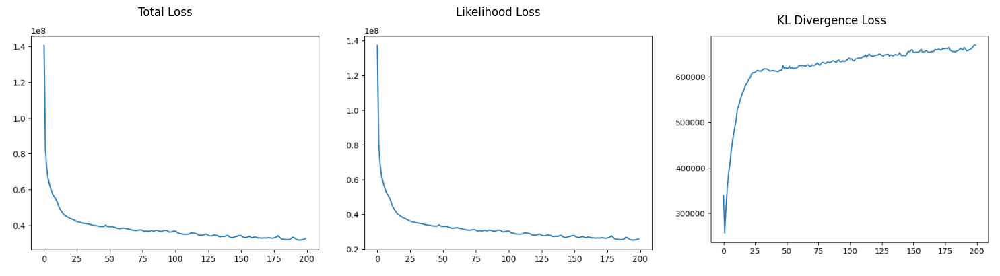

In [ ]:
# Plot the losses (vertical layout)
plt.figure(figsize=(10, 6))

plt.subplot(3, 1, 1)
plt.plot(total_losses)
plt.title('Total Loss')

plt.subplot(3, 1, 2)
plt.plot(likelihood_losses)
plt.title('Likelihood Loss')

plt.subplot(3, 1, 3)
plt.plot(kl_losses)
plt.title('KL Divergence Loss')

plt.tight_layout()
plt.show()

### Beta = 100 and z_sample = 1

The beta value is set to 100, and we use one intermediate sample.

Epoch 1/200
Total Loss: 226210000.0
Epoch 2/200
Total Loss: 140610000.0
Epoch 3/200
Total Loss: 102880000.0
Epoch 4/200
Total Loss: 91478032.0
Epoch 5/200
Total Loss: 86310664.0
Epoch 6/200
Total Loss: 83636872.0
Epoch 7/200
Total Loss: 81648648.0
Epoch 8/200
Total Loss: 80301848.0
Epoch 9/200
Total Loss: 79340168.0
Epoch 10/200
Total Loss: 78489600.0


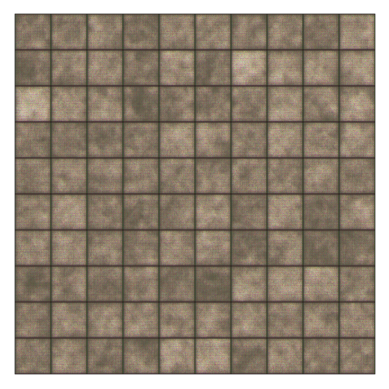

Epoch 11/200
Total Loss: 77692104.0
Epoch 12/200
Total Loss: 77103936.0
Epoch 13/200
Total Loss: 76498976.0
Epoch 14/200
Total Loss: 75968080.0
Epoch 15/200
Total Loss: 75567896.0
Epoch 16/200
Total Loss: 75161336.0
Epoch 17/200
Total Loss: 74823056.0
Epoch 18/200
Total Loss: 74517672.0
Epoch 19/200
Total Loss: 74202848.0
Epoch 20/200
Total Loss: 74021920.0


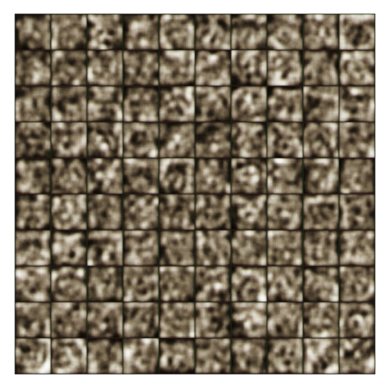

Epoch 21/200
Total Loss: 73758736.0
Epoch 22/200
Total Loss: 73490064.0
Epoch 23/200
Total Loss: 73360728.0
Epoch 24/200
Total Loss: 73004888.0
Epoch 25/200
Total Loss: 72935928.0
Epoch 26/200
Total Loss: 72816040.0
Epoch 27/200
Total Loss: 72488344.0
Epoch 28/200
Total Loss: 72466024.0
Epoch 29/200
Total Loss: 72113720.0
Epoch 30/200
Total Loss: 71613992.0


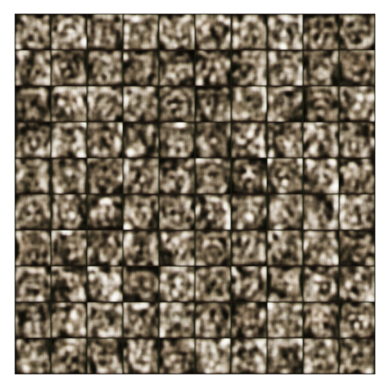

Epoch 31/200
Total Loss: 71301328.0
Epoch 32/200
Total Loss: 70734928.0
Epoch 33/200
Total Loss: 70465200.0
Epoch 34/200
Total Loss: 70155992.0
Epoch 35/200
Total Loss: 69900624.0
Epoch 36/200
Total Loss: 69579432.0
Epoch 37/200
Total Loss: 69287448.0
Epoch 38/200
Total Loss: 69103104.0
Epoch 39/200
Total Loss: 68987184.0
Epoch 40/200
Total Loss: 68829480.0


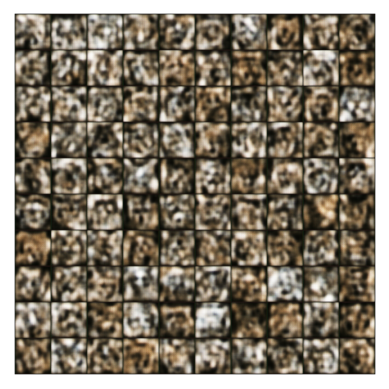

Epoch 41/200
Total Loss: 68841200.0
Epoch 42/200
Total Loss: 68377776.0
Epoch 43/200
Total Loss: 68293744.0
Epoch 44/200
Total Loss: 68257136.0
Epoch 45/200
Total Loss: 68295288.0
Epoch 46/200
Total Loss: 68183456.0
Epoch 47/200
Total Loss: 68158160.0
Epoch 48/200
Total Loss: 68223064.0
Epoch 49/200
Total Loss: 68166592.0
Epoch 50/200
Total Loss: 68146568.0


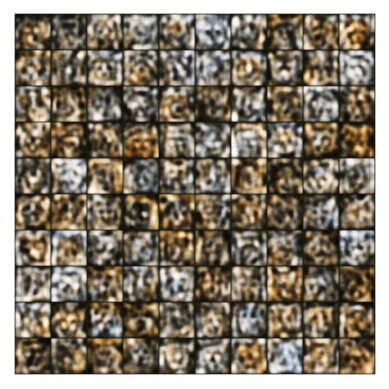

Epoch 51/200
Total Loss: 68145872.0
Epoch 52/200
Total Loss: 67978032.0
Epoch 53/200
Total Loss: 67952072.0
Epoch 54/200
Total Loss: 67798824.0
Epoch 55/200
Total Loss: 67606376.0
Epoch 56/200
Total Loss: 67597720.0
Epoch 57/200
Total Loss: 67485912.0
Epoch 58/200
Total Loss: 67383736.0
Epoch 59/200
Total Loss: 67225024.0
Epoch 60/200
Total Loss: 67151744.0


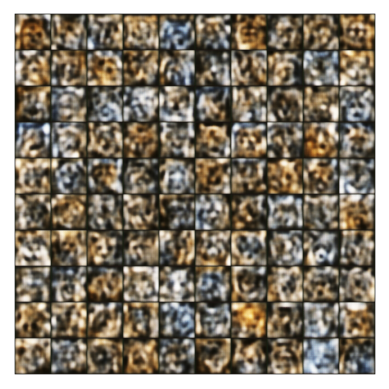

Epoch 61/200
Total Loss: 67066432.0
Epoch 62/200
Total Loss: 66872796.0
Epoch 63/200
Total Loss: 66755492.0
Epoch 64/200
Total Loss: 66668584.0
Epoch 65/200
Total Loss: 66560064.0
Epoch 66/200
Total Loss: 66441968.0
Epoch 67/200
Total Loss: 66397360.0
Epoch 68/200
Total Loss: 66332668.0
Epoch 69/200
Total Loss: 66190576.0
Epoch 70/200
Total Loss: 66140724.0


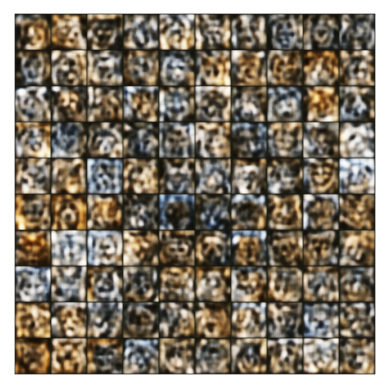

Epoch 71/200
Total Loss: 65926268.0
Epoch 72/200
Total Loss: 66013284.0
Epoch 73/200
Total Loss: 65909040.0
Epoch 74/200
Total Loss: 65880176.0
Epoch 75/200
Total Loss: 65824108.0
Epoch 76/200
Total Loss: 65874416.0
Epoch 77/200
Total Loss: 65805380.0
Epoch 78/200
Total Loss: 65832048.0
Epoch 79/200
Total Loss: 65771468.0
Epoch 80/200
Total Loss: 65601768.0


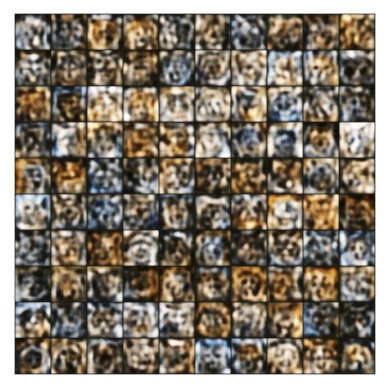

Epoch 81/200
Total Loss: 65497536.0
Epoch 82/200
Total Loss: 65378608.0
Epoch 83/200
Total Loss: 65266188.0
Epoch 84/200
Total Loss: 65232152.0
Epoch 85/200
Total Loss: 65113380.0
Epoch 86/200
Total Loss: 65116048.0
Epoch 87/200
Total Loss: 65010636.0
Epoch 88/200
Total Loss: 64939164.0
Epoch 89/200
Total Loss: 64913344.0
Epoch 90/200
Total Loss: 64889428.0


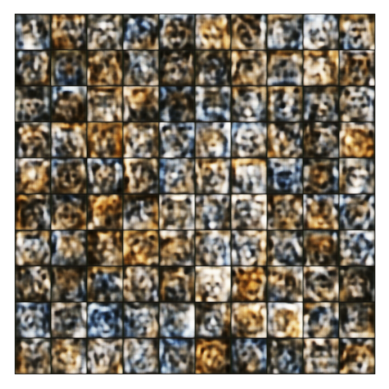

Epoch 91/200
Total Loss: 64874676.0
Epoch 92/200
Total Loss: 64874620.0
Epoch 93/200
Total Loss: 64769392.0
Epoch 94/200
Total Loss: 64809828.0
Epoch 95/200
Total Loss: 64645708.0
Epoch 96/200
Total Loss: 64672420.0
Epoch 97/200
Total Loss: 64720812.0
Epoch 98/200
Total Loss: 64744348.0
Epoch 99/200
Total Loss: 64669760.0
Epoch 100/200
Total Loss: 64685180.0


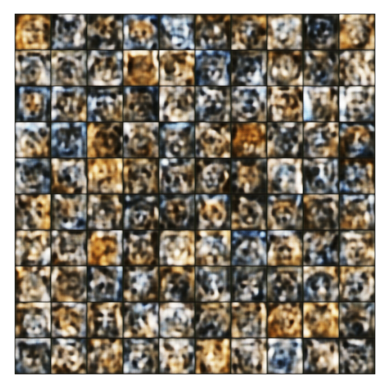

Epoch 101/200
Total Loss: 64664952.0
Epoch 102/200
Total Loss: 64631588.0
Epoch 103/200
Total Loss: 64597768.0
Epoch 104/200
Total Loss: 64492180.0
Epoch 105/200
Total Loss: 64462952.0
Epoch 106/200
Total Loss: 64413212.0
Epoch 107/200
Total Loss: 64385504.0
Epoch 108/200
Total Loss: 64318460.0
Epoch 109/200
Total Loss: 64263380.0
Epoch 110/200
Total Loss: 64166740.0


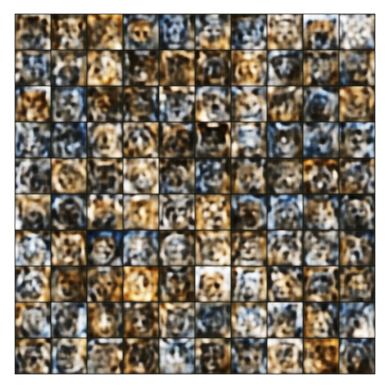

Epoch 111/200
Total Loss: 64182328.0
Epoch 112/200
Total Loss: 64143432.0
Epoch 113/200
Total Loss: 64044508.0
Epoch 114/200
Total Loss: 64061408.0
Epoch 115/200
Total Loss: 64017980.0
Epoch 116/200
Total Loss: 64028996.0
Epoch 117/200
Total Loss: 63903268.0
Epoch 118/200
Total Loss: 63975276.0
Epoch 119/200
Total Loss: 63870340.0
Epoch 120/200
Total Loss: 63783712.0


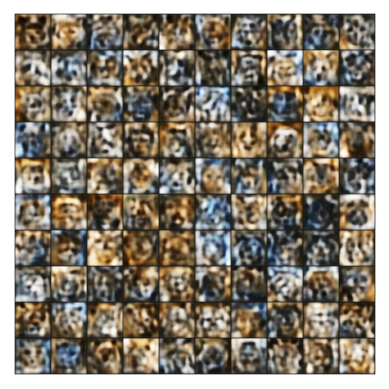

Epoch 121/200
Total Loss: 63735316.0
Epoch 122/200
Total Loss: 63711368.0
Epoch 123/200
Total Loss: 63653608.0
Epoch 124/200
Total Loss: 63590056.0
Epoch 125/200
Total Loss: 63555516.0
Epoch 126/200
Total Loss: 63484264.0
Epoch 127/200
Total Loss: 63435404.0
Epoch 128/200
Total Loss: 63404288.0
Epoch 129/200
Total Loss: 63314216.0
Epoch 130/200
Total Loss: 63262028.0


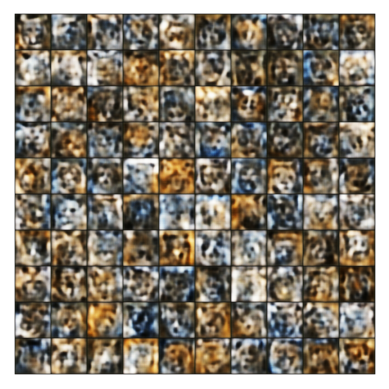

Epoch 131/200
Total Loss: 63277824.0
Epoch 132/200
Total Loss: 63191520.0
Epoch 133/200
Total Loss: 63129320.0
Epoch 134/200
Total Loss: 63095664.0
Epoch 135/200
Total Loss: 63050636.0
Epoch 136/200
Total Loss: 63000652.0
Epoch 137/200
Total Loss: 62980216.0
Epoch 138/200
Total Loss: 62923616.0
Epoch 139/200
Total Loss: 62841084.0
Epoch 140/200
Total Loss: 62847976.0


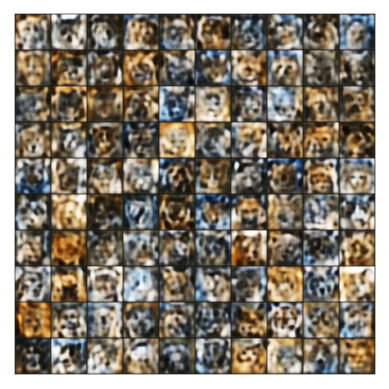

Epoch 141/200
Total Loss: 62806448.0
Epoch 142/200
Total Loss: 62803400.0
Epoch 143/200
Total Loss: 62747664.0
Epoch 144/200
Total Loss: 62787252.0
Epoch 145/200
Total Loss: 62713684.0
Epoch 146/200
Total Loss: 62664572.0
Epoch 147/200
Total Loss: 62674992.0
Epoch 148/200
Total Loss: 62667420.0
Epoch 149/200
Total Loss: 62587248.0
Epoch 150/200
Total Loss: 62619384.0


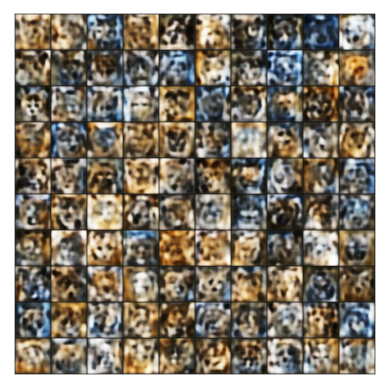

Epoch 151/200
Total Loss: 62569604.0
Epoch 152/200
Total Loss: 62595256.0
Epoch 153/200
Total Loss: 62561432.0
Epoch 154/200
Total Loss: 62478044.0
Epoch 155/200
Total Loss: 62540368.0
Epoch 156/200
Total Loss: 62479988.0
Epoch 157/200
Total Loss: 62512612.0
Epoch 158/200
Total Loss: 62512572.0
Epoch 159/200
Total Loss: 62537576.0
Epoch 160/200
Total Loss: 62458256.0


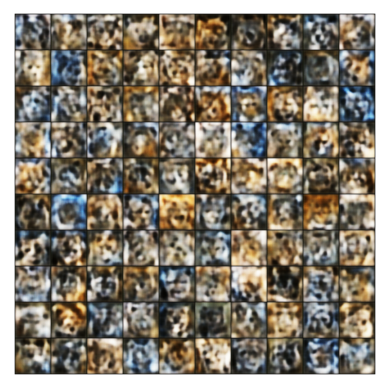

Epoch 161/200
Total Loss: 62377528.0
Epoch 162/200
Total Loss: 62326408.0
Epoch 163/200
Total Loss: 62271064.0
Epoch 164/200
Total Loss: 62241388.0
Epoch 165/200
Total Loss: 62248784.0
Epoch 166/200
Total Loss: 62212948.0
Epoch 167/200
Total Loss: 62202200.0
Epoch 168/200
Total Loss: 62118052.0
Epoch 169/200
Total Loss: 62159500.0
Epoch 170/200
Total Loss: 62085624.0


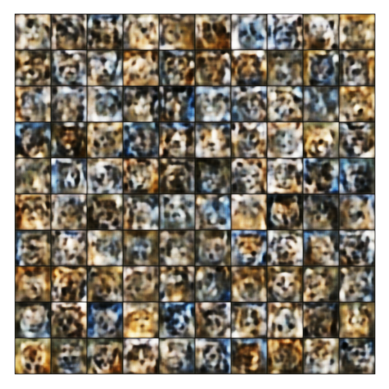

Epoch 171/200
Total Loss: 62091828.0
Epoch 172/200
Total Loss: 62024032.0
Epoch 173/200
Total Loss: 62011984.0
Epoch 174/200
Total Loss: 62015744.0
Epoch 175/200
Total Loss: 61950916.0
Epoch 176/200
Total Loss: 61961556.0
Epoch 177/200
Total Loss: 61905788.0
Epoch 178/200
Total Loss: 61968184.0
Epoch 179/200
Total Loss: 61915596.0
Epoch 180/200
Total Loss: 61904052.0


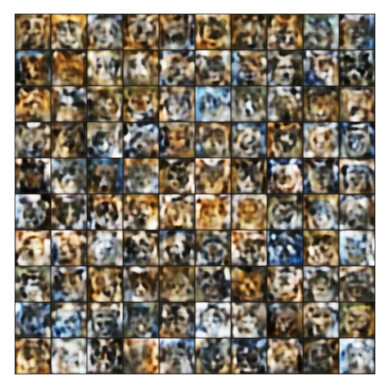

Epoch 181/200
Total Loss: 61884192.0
Epoch 182/200
Total Loss: 61940492.0
Epoch 183/200
Total Loss: 61987528.0
Epoch 184/200
Total Loss: 61924988.0
Epoch 185/200
Total Loss: 61910708.0
Epoch 186/200
Total Loss: 61970288.0
Epoch 187/200
Total Loss: 61860020.0
Epoch 188/200
Total Loss: 61851100.0
Epoch 189/200
Total Loss: 61841980.0
Epoch 190/200
Total Loss: 61778348.0


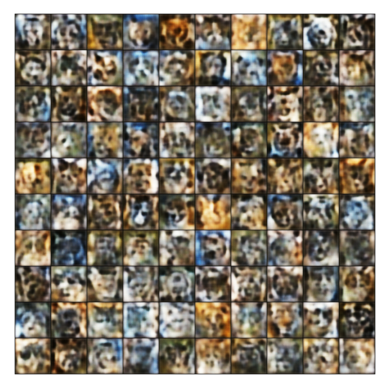

Epoch 191/200
Total Loss: 61828984.0
Epoch 192/200
Total Loss: 61780228.0
Epoch 193/200
Total Loss: 61769104.0
Epoch 194/200
Total Loss: 61729128.0
Epoch 195/200
Total Loss: 61708972.0
Epoch 196/200
Total Loss: 61642748.0
Epoch 197/200
Total Loss: 61627604.0
Epoch 198/200
Total Loss: 61560648.0
Epoch 199/200
Total Loss: 61546140.0
Epoch 200/200
Total Loss: 61499836.0


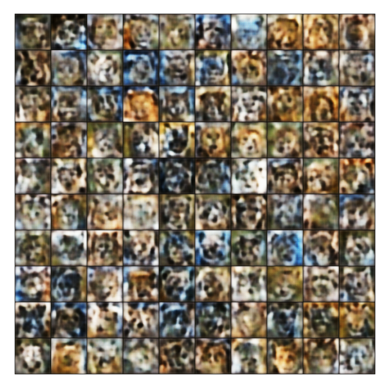

In [ ]:
# Training function
def train_vae(model, dataloader, epochs, learning_rate, beta=100, save_path='model_weights.pth', sample_interval=10):
    """
    Trains a Variational Autoencoder (VAE) model.
    """
    # Initialize optimizer
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    # Set device
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    model = model.to(device)

    # Training loop
    total_losses = []
    likelihood_losses = []
    kl_losses = []

    for epoch in range(epochs):
        print(f"Epoch {epoch + 1}/{epochs}")

        # Initialize epoch-level loss trackers
        epoch_total_loss = 0.0
        epoch_likelihood = 0.0
        epoch_KL = 0.0

        model.train()  # Set model to training mode
        for image_batch in dataloader:
            x = image_batch[0].to(device)

            # Forward pass
            x_chng, x_hat, mu, log_var = model(x)

            # Calculate loss
            loss, rec_loss, reg_loss = model.loss(x_chng, x_hat, mu, log_var)

            # Update epoch-level loss trackers
            epoch_total_loss += loss.item()
            epoch_likelihood += rec_loss.item()
            epoch_KL += reg_loss.item()

            # Backpropagation and optimization
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            # Clear GPU memory
            torch.cuda.empty_cache()

        # Print epoch loss
        print(f"Total Loss: {epoch_total_loss:.4f}, KL: {epoch_KL:.4f}")

        total_losses.append(epoch_total_loss)
        likelihood_losses.append(epoch_likelihood)
        kl_losses.append(epoch_KL)

        # Sample and display images every `sample_interval` epochs
        if (epoch + 1) % sample_interval == 0:
            model.eval()  # Set model to evaluation mode
            with torch.no_grad():
                gen = model.sample(device, 100)  # Generate 100 samples
                grid = make_grid(gen, nrow=10, padding=2, normalize=True)
                grid = grid.cpu().detach()
                plt.figure(figsize=(10, 10))
                plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
                plt.axis('off')
                plt.show()

        # Save model weights every `sample_interval` epochs
        if (epoch + 1) % sample_interval == 0:
            if os.path.exists(save_path):
                os.remove(save_path)
            torch.save(model.state_dict(), save_path)

    return total_losses, likelihood_losses, kl_losses


total_losses, likelihood_losses, kl_losses = train_vae(
    model=VAE(beta=100),  # Initialize VAE with beta=100
    dataloader=dataloader,
    epochs=200,
    learning_rate=0.0001,
    save_path='/content/drive/My Drive/Project/DataSet/afhq/model_weights.pth'
)

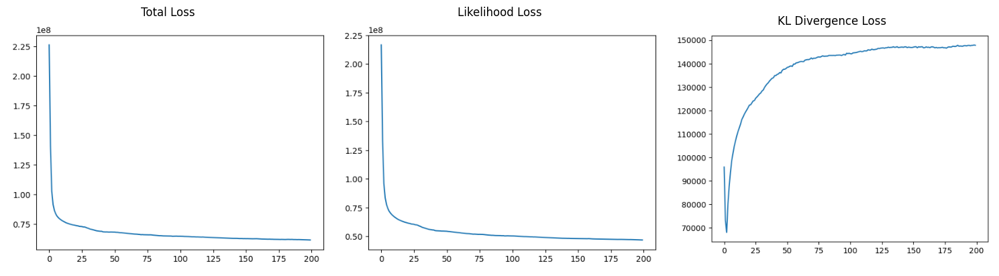

In [ ]:
# Plot the losses (vertical layout)
plt.figure(figsize=(10, 6))

plt.subplot(3, 1, 1)
plt.plot(total_losses)
plt.title('Total Loss')

plt.subplot(3, 1, 2)
plt.plot(likelihood_losses)
plt.title('Likelihood Loss')

plt.subplot(3, 1, 3)
plt.plot(kl_losses)
plt.title('KL Divergence Loss')

plt.tight_layout()
plt.show()

### Beta = 1000 and z_sample = 1

The beta value is set to 1000, and we use one intermediate sample.

Epoch 1/200
Total Loss: 206870000.0
Epoch 2/200
Total Loss: 170330000.0
Epoch 3/200
Total Loss: 170010000.0
Epoch 4/200
Total Loss: 169870000.0
Epoch 5/200
Total Loss: 169680000.0
Epoch 6/200
Total Loss: 169550000.0
Epoch 7/200
Total Loss: 169450000.0
Epoch 8/200
Total Loss: 169380000.0
Epoch 9/200
Total Loss: 169340000.0
Epoch 10/200
Total Loss: 168050000.0


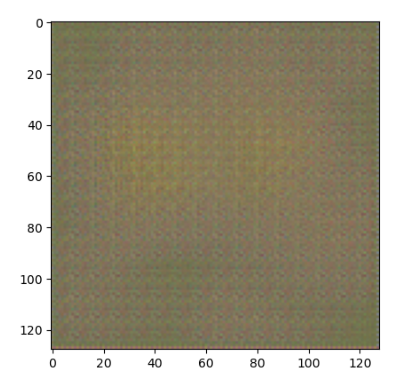

Epoch 11/200
Total Loss: 151770000.0
Epoch 12/200
Total Loss: 132080000.0
Epoch 13/200
Total Loss: 122800000.0
Epoch 14/200
Total Loss: 120500000.0
Epoch 15/200
Total Loss: 118220000.0
Epoch 16/200
Total Loss: 116700000.0
Epoch 17/200
Total Loss: 115220000.0
Epoch 18/200
Total Loss: 114780000.0
Epoch 19/200
Total Loss: 114290000.0
Epoch 20/200
Total Loss: 114060000.0


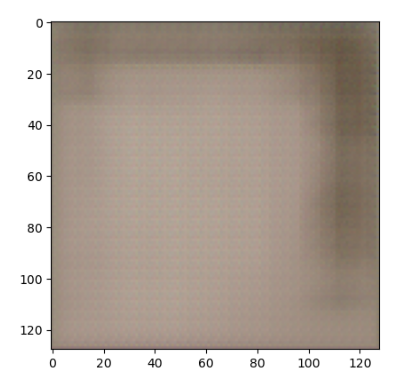

Epoch 21/200
Total Loss: 114070000.0
Epoch 22/200
Total Loss: 114080000.0
Epoch 23/200
Total Loss: 113910000.0
Epoch 24/200
Total Loss: 113600000.0
Epoch 25/200
Total Loss: 113550000.0
Epoch 26/200
Total Loss: 113600000.0
Epoch 27/200
Total Loss: 113110000.0
Epoch 28/200
Total Loss: 113250000.0
Epoch 29/200
Total Loss: 113220000.0
Epoch 30/200
Total Loss: 113140000.0


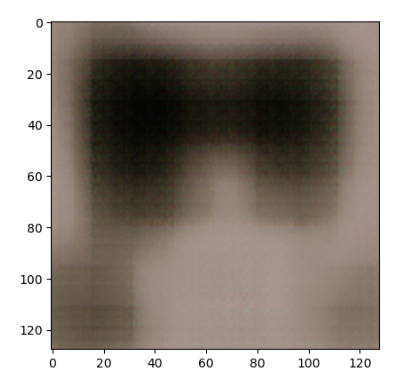

Epoch 31/200
Total Loss: 113060000.0
Epoch 32/200
Total Loss: 113080000.0
Epoch 33/200
Total Loss: 112990000.0
Epoch 34/200
Total Loss: 112780000.0
Epoch 35/200
Total Loss: 112780000.0
Epoch 36/200
Total Loss: 112880000.0
Epoch 37/200
Total Loss: 112670000.0
Epoch 38/200
Total Loss: 112770000.0
Epoch 39/200
Total Loss: 112580000.0
Epoch 40/200
Total Loss: 112550000.0


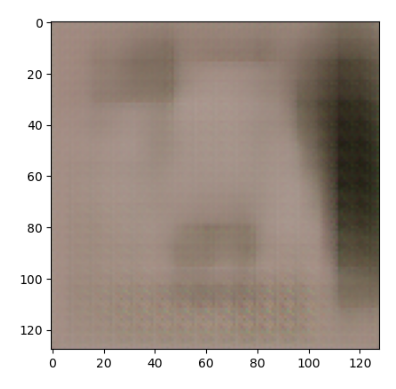

Epoch 41/200
Total Loss: 112750000.0
Epoch 42/200
Total Loss: 112570000.0
Epoch 43/200
Total Loss: 112610000.0
Epoch 44/200
Total Loss: 112480000.0
Epoch 45/200
Total Loss: 112420000.0
Epoch 46/200
Total Loss: 112310000.0
Epoch 47/200
Total Loss: 112370000.0
Epoch 48/200
Total Loss: 112110000.0
Epoch 49/200
Total Loss: 112090000.0
Epoch 50/200
Total Loss: 112320000.0


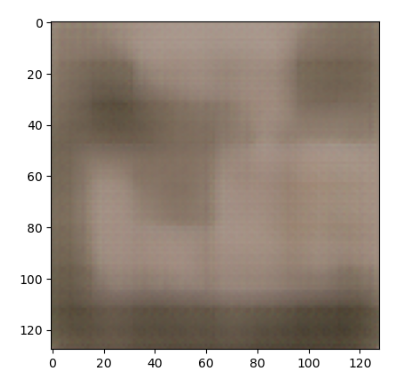

Epoch 51/200
Total Loss: 112250000.0
Epoch 52/200
Total Loss: 112230000.0
Epoch 53/200
Total Loss: 111860000.0
Epoch 54/200
Total Loss: 111890000.0
Epoch 55/200
Total Loss: 112100000.0
Epoch 56/200
Total Loss: 111770000.0
Epoch 57/200
Total Loss: 111680000.0
Epoch 58/200
Total Loss: 111890000.0
Epoch 59/200
Total Loss: 111730000.0
Epoch 60/200
Total Loss: 111700000.0


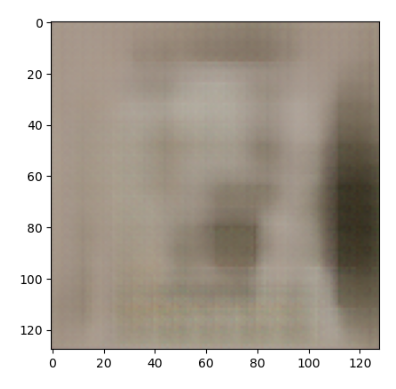

Epoch 61/200
Total Loss: 111720000.0
Epoch 62/200
Total Loss: 111510000.0
Epoch 63/200
Total Loss: 111440000.0
Epoch 64/200
Total Loss: 111620000.0
Epoch 65/200
Total Loss: 111220000.0
Epoch 66/200
Total Loss: 111070000.0
Epoch 67/200
Total Loss: 110830000.0
Epoch 68/200
Total Loss: 110530000.0
Epoch 69/200
Total Loss: 110450000.0
Epoch 70/200
Total Loss: 110370000.0


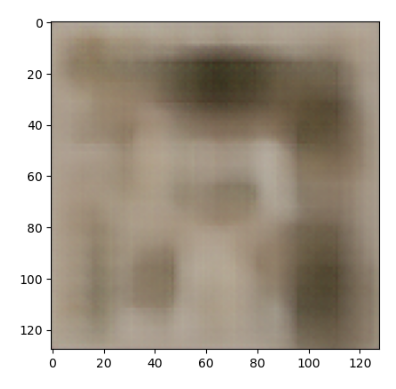

Epoch 71/200
Total Loss: 110240000.0
Epoch 72/200
Total Loss: 110090000.0
Epoch 73/200
Total Loss: 109970000.0
Epoch 74/200
Total Loss: 110010000.0
Epoch 75/200
Total Loss: 109910000.0
Epoch 76/200
Total Loss: 109940000.0
Epoch 77/200
Total Loss: 109970000.0
Epoch 78/200
Total Loss: 109760000.0
Epoch 79/200
Total Loss: 109780000.0
Epoch 80/200
Total Loss: 109800000.0


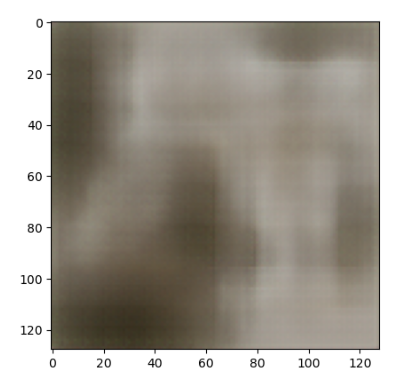

Epoch 81/200
Total Loss: 109580000.0
Epoch 82/200
Total Loss: 109690000.0
Epoch 83/200
Total Loss: 109420000.0
Epoch 84/200
Total Loss: 109550000.0
Epoch 85/200
Total Loss: 109290000.0
Epoch 86/200
Total Loss: 109310000.0
Epoch 87/200
Total Loss: 109140000.0
Epoch 88/200
Total Loss: 109310000.0
Epoch 89/200
Total Loss: 109270000.0
Epoch 90/200
Total Loss: 109210000.0


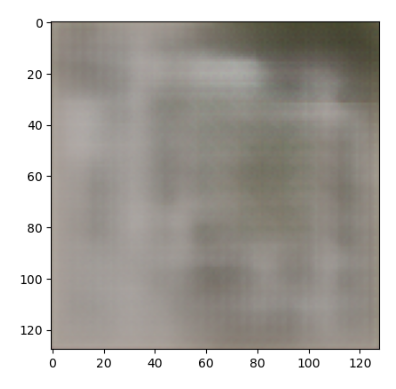

Epoch 91/200
Total Loss: 109240000.0
Epoch 92/200
Total Loss: 109370000.0
Epoch 93/200
Total Loss: 109200000.0
Epoch 94/200
Total Loss: 109020000.0
Epoch 95/200
Total Loss: 108970000.0
Epoch 96/200
Total Loss: 108780000.0
Epoch 97/200
Total Loss: 108740000.0
Epoch 98/200
Total Loss: 109040000.0
Epoch 99/200
Total Loss: 108680000.0
Epoch 100/200
Total Loss: 108820000.0


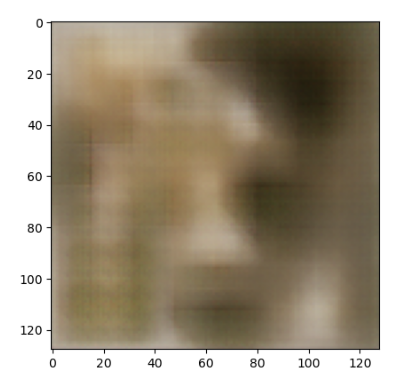

Epoch 101/200
Total Loss: 108610000.0
Epoch 102/200
Total Loss: 108760000.0
Epoch 103/200
Total Loss: 108650000.0
Epoch 104/200
Total Loss: 108680000.0
Epoch 105/200
Total Loss: 108590000.0
Epoch 106/200
Total Loss: 108590000.0
Epoch 107/200
Total Loss: 108590000.0
Epoch 108/200
Total Loss: 108590000.0
Epoch 109/200
Total Loss: 108540000.0
Epoch 110/200
Total Loss: 108550000.0


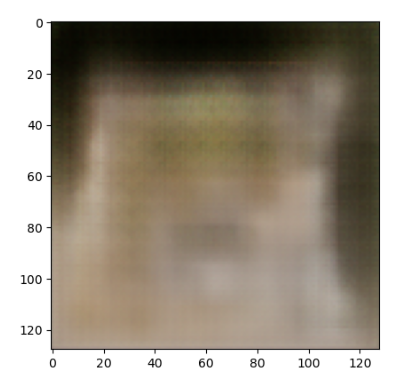

Epoch 111/200
Total Loss: 108420000.0
Epoch 112/200
Total Loss: 108260000.0
Epoch 113/200
Total Loss: 108190000.0
Epoch 114/200
Total Loss: 108320000.0
Epoch 115/200
Total Loss: 108190000.0
Epoch 116/200
Total Loss: 108280000.0
Epoch 117/200
Total Loss: 108190000.0
Epoch 118/200
Total Loss: 108250000.0
Epoch 119/200
Total Loss: 108080000.0
Epoch 120/200
Total Loss: 107940000.0


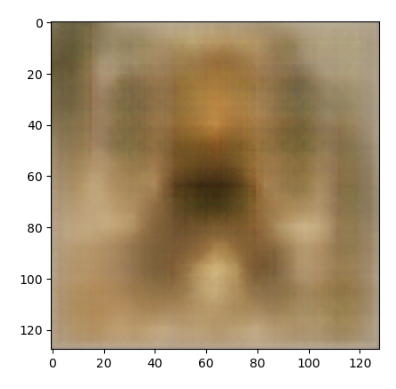

Epoch 121/200
Total Loss: 108120000.0
Epoch 122/200
Total Loss: 107890000.0
Epoch 123/200
Total Loss: 108090000.0
Epoch 124/200
Total Loss: 107880000.0
Epoch 125/200
Total Loss: 107960000.0
Epoch 126/200
Total Loss: 107970000.0
Epoch 127/200
Total Loss: 107810000.0
Epoch 128/200
Total Loss: 107760000.0
Epoch 129/200
Total Loss: 108090000.0
Epoch 130/200
Total Loss: 107800000.0


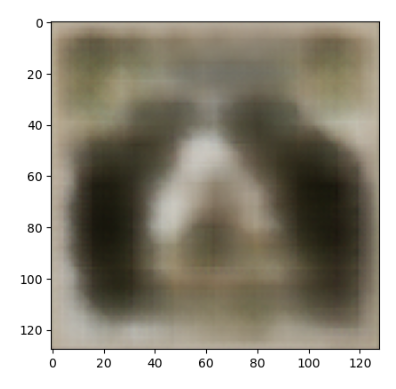

Epoch 131/200
Total Loss: 107800000.0
Epoch 132/200
Total Loss: 107610000.0
Epoch 133/200
Total Loss: 107610000.0
Epoch 134/200
Total Loss: 107640000.0
Epoch 135/200
Total Loss: 107530000.0
Epoch 136/200
Total Loss: 107620000.0
Epoch 137/200
Total Loss: 107640000.0
Epoch 138/200
Total Loss: 107310000.0
Epoch 139/200
Total Loss: 107400000.0
Epoch 140/200
Total Loss: 107470000.0


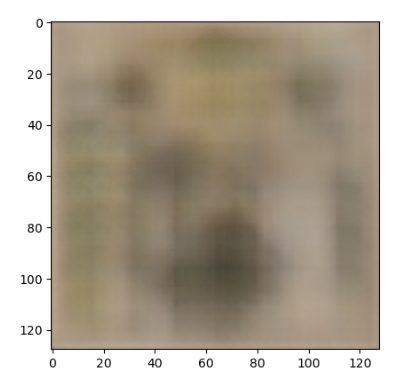

Epoch 141/200
Total Loss: 107360000.0
Epoch 142/200
Total Loss: 107320000.0
Epoch 143/200
Total Loss: 107560000.0
Epoch 144/200
Total Loss: 107330000.0
Epoch 145/200
Total Loss: 107370000.0
Epoch 146/200
Total Loss: 107180000.0
Epoch 147/200
Total Loss: 107020000.0
Epoch 148/200
Total Loss: 107180000.0
Epoch 149/200
Total Loss: 107180000.0
Epoch 150/200
Total Loss: 107130000.0


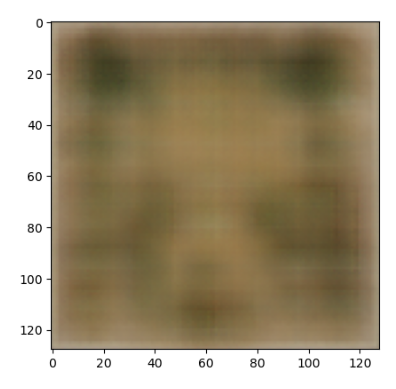

Epoch 151/200
Total Loss: 106970000.0
Epoch 152/200
Total Loss: 107020000.0
Epoch 153/200
Total Loss: 107060000.0
Epoch 154/200
Total Loss: 106900000.0
Epoch 155/200
Total Loss: 107140000.0
Epoch 156/200
Total Loss: 106800000.0
Epoch 157/200
Total Loss: 106820000.0
Epoch 158/200
Total Loss: 106780000.0
Epoch 159/200
Total Loss: 106580000.0
Epoch 160/200
Total Loss: 106580000.0


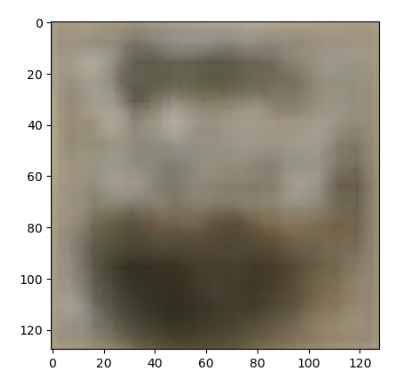

Epoch 161/200
Total Loss: 106780000.0
Epoch 162/200
Total Loss: 106370000.0
Epoch 163/200
Total Loss: 106440000.0
Epoch 164/200
Total Loss: 106450000.0
Epoch 165/200
Total Loss: 106410000.0
Epoch 166/200
Total Loss: 106210000.0
Epoch 167/200
Total Loss: 106210000.0
Epoch 168/200
Total Loss: 106170000.0
Epoch 169/200
Total Loss: 106430000.0
Epoch 170/200
Total Loss: 106180000.0


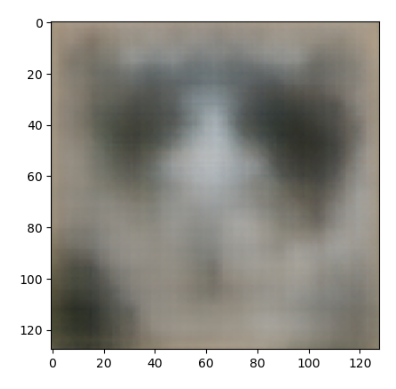

Epoch 171/200
Total Loss: 106230000.0
Epoch 172/200
Total Loss: 106280000.0
Epoch 173/200
Total Loss: 106270000.0
Epoch 174/200
Total Loss: 105980000.0
Epoch 175/200
Total Loss: 106020000.0
Epoch 176/200
Total Loss: 105920000.0
Epoch 177/200
Total Loss: 105850000.0
Epoch 178/200
Total Loss: 105880000.0
Epoch 179/200
Total Loss: 105790000.0
Epoch 180/200
Total Loss: 105830000.0


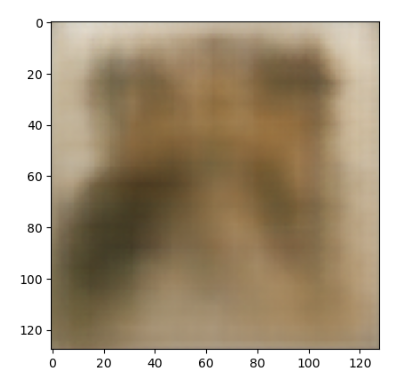

Epoch 181/200
Total Loss: 105820000.0
Epoch 182/200
Total Loss: 105730000.0
Epoch 183/200
Total Loss: 105840000.0
Epoch 184/200
Total Loss: 105580000.0
Epoch 185/200
Total Loss: 105800000.0
Epoch 186/200
Total Loss: 105700000.0
Epoch 187/200
Total Loss: 105670000.0
Epoch 188/200
Total Loss: 105600000.0
Epoch 189/200
Total Loss: 105770000.0
Epoch 190/200
Total Loss: 105420000.0


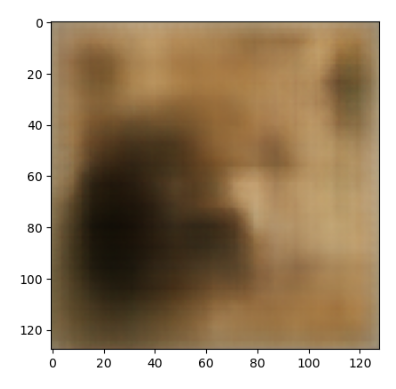

Epoch 191/200
Total Loss: 105520000.0
Epoch 192/200
Total Loss: 105390000.0
Epoch 193/200
Total Loss: 105280000.0
Epoch 194/200
Total Loss: 105280000.0
Epoch 195/200
Total Loss: 105670000.0
Epoch 196/200
Total Loss: 105480000.0
Epoch 197/200
Total Loss: 105530000.0
Epoch 198/200
Total Loss: 105410000.0
Epoch 199/200
Total Loss: 105200000.0
Epoch 200/200
Total Loss: 105270000.0


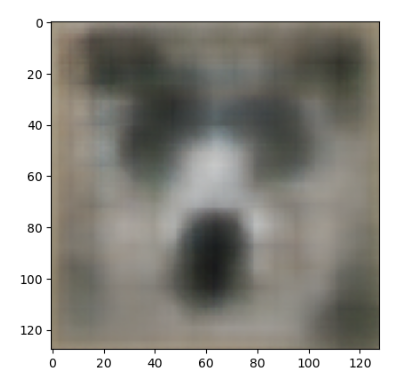

In [ ]:
# Training function
def train_vae(model, dataloader, epochs, learning_rate, beta=1000, save_path='model_weights.pth', sample_interval=10):
    """
    Trains a Variational Autoencoder (VAE) model.
    """
    # Initialize optimizer
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    # Set device
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    model = model.to(device)

    # Training loop
    total_losses = []
    likelihood_losses = []
    kl_losses = []

    for epoch in range(epochs):
        print(f"Epoch {epoch + 1}/{epochs}")

        # Initialize epoch-level loss trackers
        epoch_total_loss = 0.0
        epoch_likelihood = 0.0
        epoch_KL = 0.0

        model.train()  # Set model to training mode
        for image_batch in dataloader:
            x = image_batch[0].to(device)

            # Forward pass
            x_chng, x_hat, mu, log_var = model(x)

            # Calculate loss
            loss, rec_loss, reg_loss = model.loss(x_chng, x_hat, mu, log_var)

            # Update epoch-level loss trackers
            epoch_total_loss += loss.item()
            epoch_likelihood += rec_loss.item()
            epoch_KL += reg_loss.item()

            # Backpropagation and optimization
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            # Clear GPU memory
            torch.cuda.empty_cache()

        # Print epoch loss
        print(f"Total Loss: {epoch_total_loss:.4f}")

        total_losses.append(epoch_total_loss)
        likelihood_losses.append(epoch_likelihood)
        kl_losses.append(epoch_KL)

        # Sample and display images every `sample_interval` epochs
        if (epoch + 1) % sample_interval == 0:
            model.eval()  # Set model to evaluation mode
            with torch.no_grad():
                gen = model.sample(device, 100)  # Generate 100 samples
                grid = make_grid(gen, nrow=10, padding=2, normalize=True)
                grid = grid.cpu().detach()
                plt.figure(figsize=(10, 10))
                plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
                plt.axis('off')
                plt.show()

        # Save model weights every `sample_interval` epochs
        if (epoch + 1) % sample_interval == 0:
            if os.path.exists(save_path):
                os.remove(save_path)
            torch.save(model.state_dict(), save_path)

    return total_losses, likelihood_losses, kl_losses

total_losses, likelihood_losses, kl_losses = train_vae(
    model=VAE(beta=1000),  # Initialize VAE with beta=1000
    dataloader=dataloader,
    epochs=200,
    learning_rate=0.001,
    save_path='/content/drive/My Drive/Project/DataSet/afhq/model_weights.pth'
)

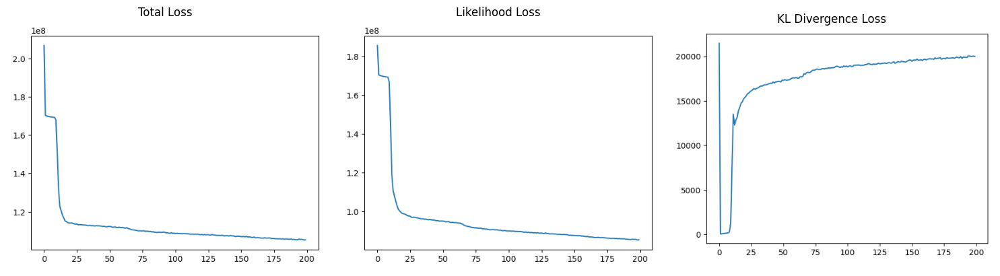

In [ ]:
# Plot the losses (vertical layout)
plt.figure(figsize=(10, 6))

plt.subplot(3, 1, 1)
plt.plot(total_losses)
plt.title('Total Loss')

plt.subplot(3, 1, 2)
plt.plot(likelihood_losses)
plt.title('Likelihood Loss')

plt.subplot(3, 1, 3)
plt.plot(kl_losses)
plt.title('KL Divergence Loss')

plt.tight_layout()
plt.show()

### Comments

During training, achieving a balance between minimizing both reconstruction loss and the prior matching term presents a significant challenge. When these objectives clash, a common issue arises: the reconstruction term, residing in the input domain (x), often exhibits a larger loss value compared to the latent domain loss (prior matching term). This disparity leads to the reconstruction loss dominating the optimization process, as the model prioritizes reconstructing the input data over aligning with the prior distribution. To mitigate this imbalance, a higher value for the beta parameter can be employed. This scaling factor amplifies the influence of the prior matching term, forcing the model to consider both objectives more equitably. By adjusting beta, we can effectively guide the training process to achieve a desired balance between reconstruction accuracy and adherence to the prior distribution.

## Inference

### 10 x 10 grids of Images

The training experiments were conducted with two distinct latent space dimensions: 128 and 32. The choice of a smaller 32-dimensional latent space was motivated by a comparative analysis. As expected, the reconstruction quality for the model trained with a 128-dimensional latent space excelled, exhibiting sharper details and a more accurate representation of the input data. However, a fascinating observation emerged regarding the sampling process. The model trained on the 32-dimensional latent space demonstrated superior sampling capabilities, generating smoother and more coherent images. This discrepancy can be attributed to the limited size of the training dataset. In the 128-dimensional space, the sparsity of data points resulted in undefined regions within the latent space. Consequently, sampling from these undefined regions led to the generation of distorted, "curvy" images. In contrast, the 32-dimensional space, despite its lower dimensionality, proved sufficient to define density across the entire space due to the relatively smaller number of data points. This comprehensive coverage enabled the generation of smooth and coherent samples. Furthermore, the impact of the beta parameter on both reconstruction quality and sampling smoothness was readily observed. As the beta value increased, the prior matching term gained greater influence, leading to a decrease in reconstruction quality. This prioritization of the prior distribution resulted in smoother sampled images, as the model was more constrained to the learned distribution rather than focusing solely on reconstruction accuracy.

#### beta = 1 and z = 1

##### Sampling

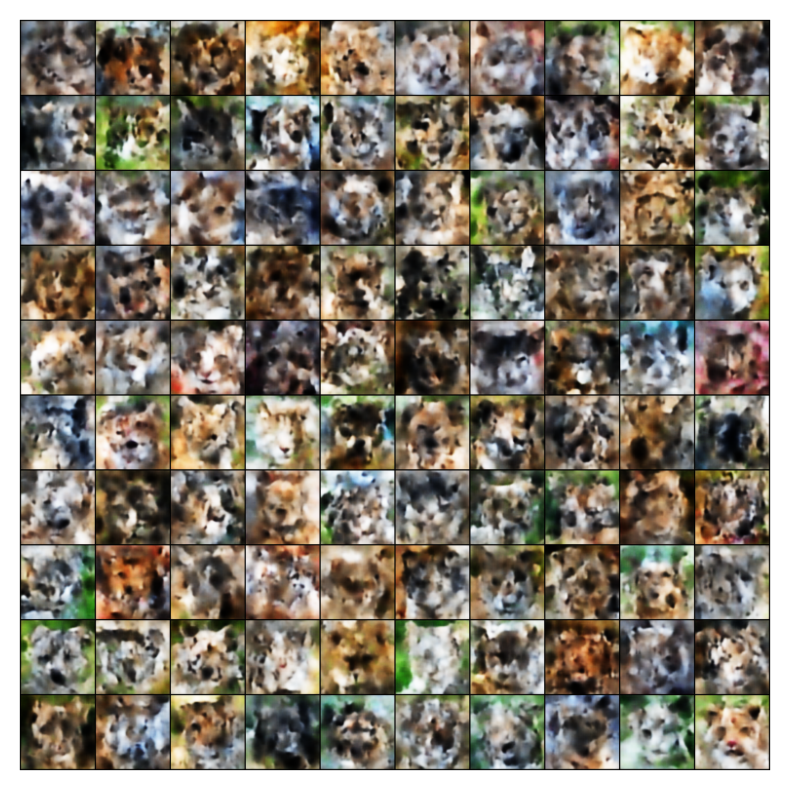

In [ ]:
def generate_and_display_samples(model, device, num_samples=100, grid_nrow=10):
  """
  Generates and displays a grid of samples from the trained VAE model.

  Args:
      model (VAE): The trained VAE model.
      device (str): The device to use ('cuda' or 'cpu').
      num_samples (int, optional): The number of samples to generate. Defaults to 100.
      grid_nrow (int, optional): The number of rows in the grid. Defaults to 10.
  """

  with torch.no_grad():
    # Generate samples from the model
    gen = model.sample(device, num_samples)

    # Create a grid of images for visualization
    grid = make_grid(gen, nrow=grid_nrow, padding=2, normalize=True)
    grid = grid.cpu().detach()

    # Display the grid of images
    plt.figure(figsize=(10, 10))
    plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
    plt.axis('off')
    plt.show()

# Load the model and generate samples
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model1 = VAE()
# Load the saved model weights
model1.load_state_dict(torch.load('/content/drive/My Drive/Project/DataSet/afhq/model_weights_z_1.pth'))
# Move the model to the specified device
model1 = model1.to(device)

# Generate and display samples from the loaded model
generate_and_display_samples(model1, device)

##### Reconstruction

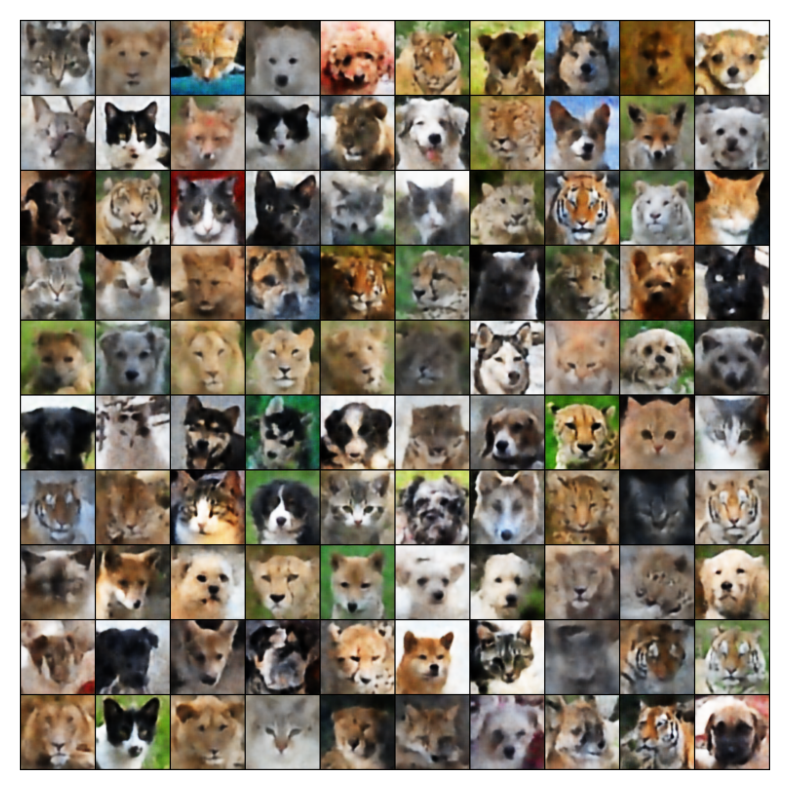

In [ ]:
def reconstruct_and_display(model, dataloader, device, grid_nrow=10):
  """
  Reconstructs an image from the dataloader using the trained VAE model
  and displays the reconstructed image in a grid.

  Args:
      model (VAE): The trained VAE model.
      dataloader (DataLoader): The dataloader containing images.
      device (str): The device to use ('cuda' or 'cpu').
      grid_nrow (int, optional): The number of rows in the grid. Defaults to 10.
  """

  with torch.no_grad():
    # Get a single batch from the dataloader
    for batch in dataloader:
        image = batch[0].to(device)
        break

    # Reconstruct the image
    gen = model.reconstruct(image)

    # Create a grid of reconstructed images for visualization
    grid = make_grid(gen, nrow=grid_nrow, padding=2, normalize=True)
    grid = grid.cpu().detach()

    # Display the grid of reconstructed images
    plt.figure(figsize=(10, 10))
    plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
    plt.axis('off')
    plt.show()

# Load the model and reconstruct an image
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model1 = VAE()
model1.load_state_dict(torch.load('/content/drive/My Drive/Project/DataSet/afhq/model_weights_z_1.pth'))
model1 = model1.to(device)

# Create a dataloader for the dataset
tst = DataLoader(dataset, batch_size=100, shuffle=True)

# Reconstruct and display the image
reconstruct_and_display(model1, tst, device)

#### beta = 1 and z = 10

##### Sampling

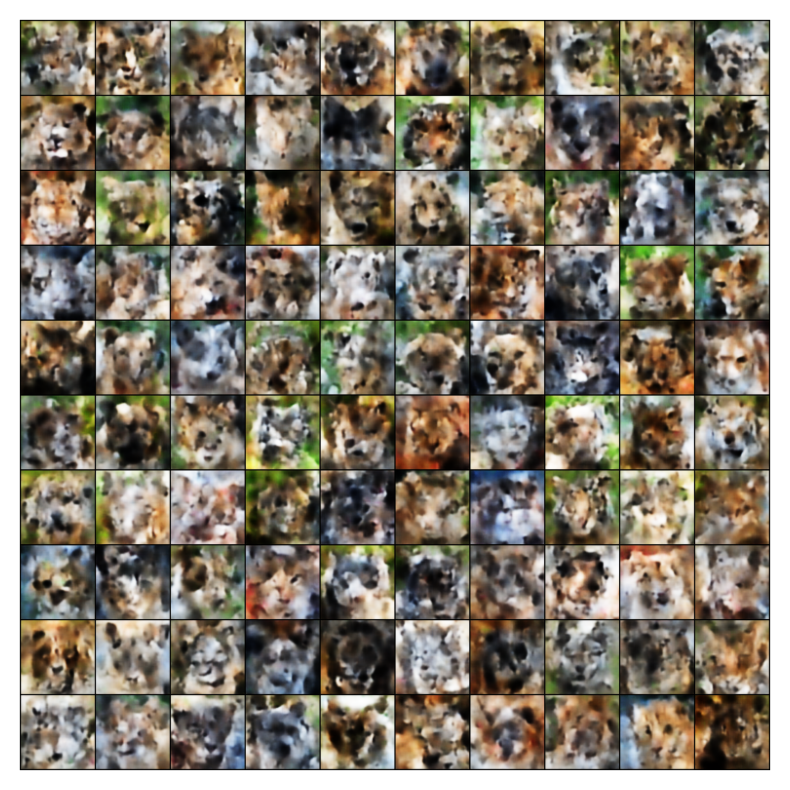

In [ ]:
def generate_and_display_samples(model, device, num_samples=100, grid_nrow=10):
  """
  Generates and displays a grid of samples from the trained VAE model.

  Args:
      model (VAE): The trained VAE model.
      device (str): The device to use ('cuda' or 'cpu').
      num_samples (int, optional): The number of samples to generate. Defaults to 100.
      grid_nrow (int, optional): The number of rows in the grid. Defaults to 10.
  """

  with torch.no_grad():
    # Generate samples from the model
    gen = model.sample(device, num_samples)

    # Create a grid of images for visualization
    grid = make_grid(gen, nrow=grid_nrow, padding=2, normalize=True)
    grid = grid.cpu().detach()

    # Display the grid of images
    plt.figure(figsize=(10, 10))
    plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
    plt.axis('off')
    plt.show()

# Load the model and generate samples
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model2 = VAE()
# Load the saved model weights
model2.load_state_dict(torch.load('/content/drive/My Drive/Project/DataSet/afhq/model_weights_z_10.pth'))
# Move the model to the specified device
model2 = model2.to(device)

# Generate and display samples from the loaded model
generate_and_display_samples(model2, device)

##### Reconstruction

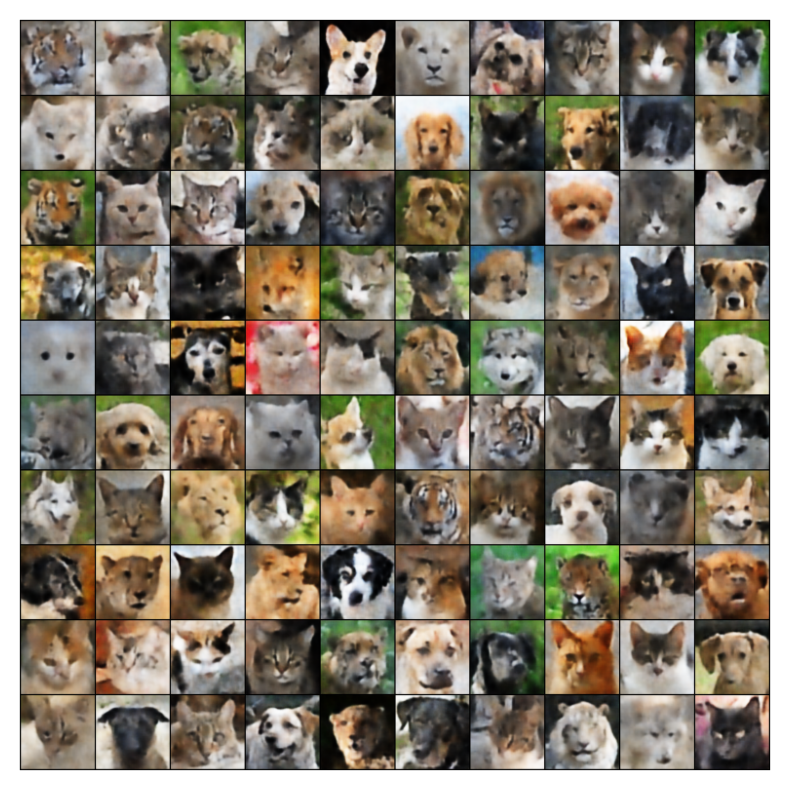

In [ ]:
def reconstruct_and_display(model, dataloader, device, grid_nrow=10):
  """
  Reconstructs an image from the dataloader using the trained VAE model
  and displays the reconstructed image in a grid.

  Args:
      model (VAE): The trained VAE model.
      dataloader (DataLoader): The dataloader containing images.
      device (str): The device to use ('cuda' or 'cpu').
      grid_nrow (int, optional): The number of rows in the grid. Defaults to 10.
  """

  with torch.no_grad():
    # Get a single batch from the dataloader
    for batch in dataloader:
        image = batch[0].to(device)
        break

    # Reconstruct the image
    gen = model.reconstruct(image)

    # Create a grid of reconstructed images for visualization
    grid = make_grid(gen, nrow=grid_nrow, padding=2, normalize=True)
    grid = grid.cpu().detach()

    # Display the grid of reconstructed images
    plt.figure(figsize=(10, 10))
    plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
    plt.axis('off')
    plt.show()

# Load the model and reconstruct an image
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model2 = VAE()
# Load the saved model weights
model2.load_state_dict(torch.load('/content/drive/My Drive/Project/DataSet/afhq/model_weights_z_10.pth'))
# Move the model to the specified device
model2 = model2.to(device)

# Create a dataloader for the dataset
tst = DataLoader(dataset, batch_size=100, shuffle=True)

# Reconstruct and display the image
reconstruct_and_display(model2, tst, device)

#### beta = 10

##### Sampling

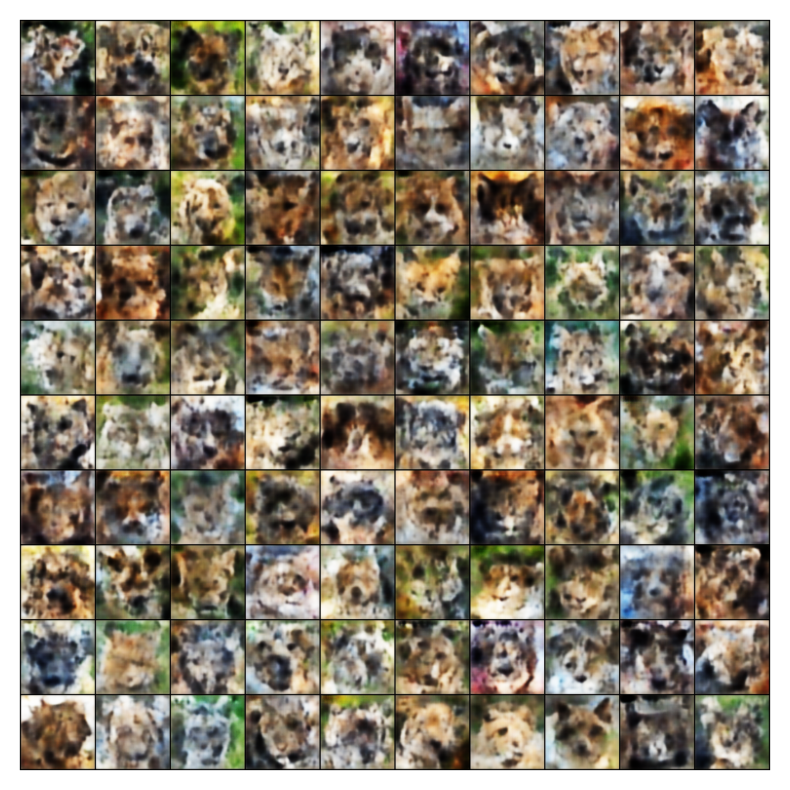

In [ ]:
def generate_and_display_samples(model, device, num_samples=100, grid_nrow=10):
  """
  Generates and displays a grid of samples from the trained VAE model.

  Args:
      model (VAE): The trained VAE model.
      device (str): The device to use ('cuda' or 'cpu').
      num_samples (int, optional): The number of samples to generate. Defaults to 100.
      grid_nrow (int, optional): The number of rows in the grid. Defaults to 10.
  """

  with torch.no_grad():
    # Generate samples from the model
    gen = model.sample(device, num_samples)

    # Create a grid of images for visualization
    grid = make_grid(gen, nrow=grid_nrow, padding=2, normalize=True)
    grid = grid.cpu().detach()

    # Display the grid of images
    plt.figure(figsize=(10, 10))
    plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
    plt.axis('off')
    plt.show()

# Load the model and generate samples
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model3 = VAE()
# Load the saved model weights
model3.load_state_dict(torch.load('/content/drive/My Drive/Project/DataSet/afhq/model_weights_beta_10.pth'))
# Move the model to the specified device
model3 = model3.to(device)

# Generate and display samples from the loaded model
generate_and_display_samples(model3, device)

##### Reconstruction

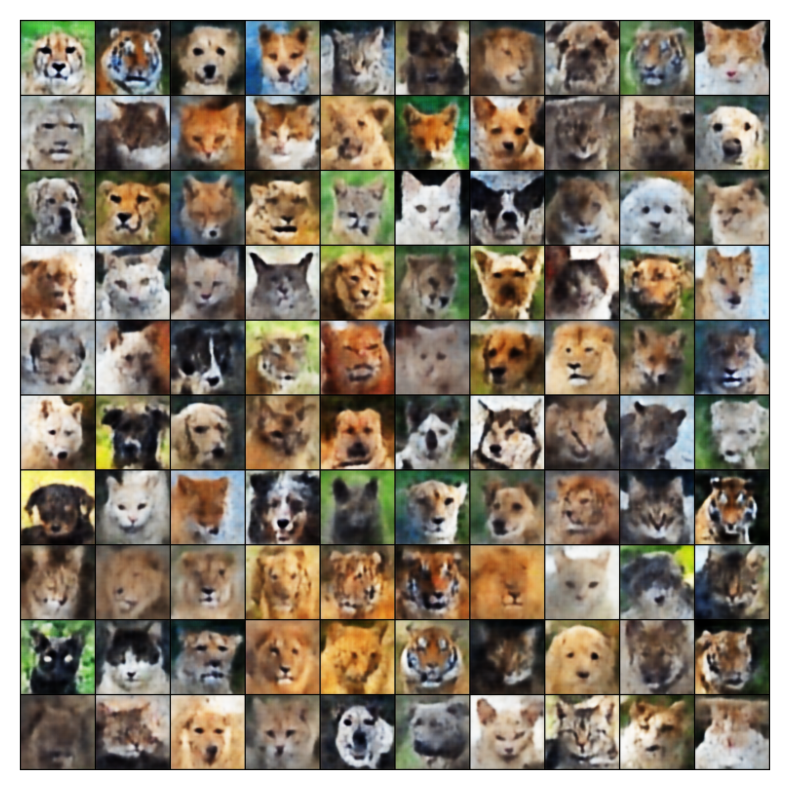

In [ ]:
def reconstruct_and_display(model, dataloader, device, grid_nrow=10):
  """
  Reconstructs an image from the dataloader using the trained VAE model
  and displays the reconstructed image in a grid.

  Args:
      model (VAE): The trained VAE model.
      dataloader (DataLoader): The dataloader containing images.
      device (str): The device to use ('cuda' or 'cpu').
      grid_nrow (int, optional): The number of rows in the grid. Defaults to 10.
  """

  with torch.no_grad():
    # Get a single batch from the dataloader
    for batch in dataloader:
        image = batch[0].to(device)
        break

    # Reconstruct the image
    gen = model.reconstruct(image)

    # Create a grid of reconstructed images for visualization
    grid = make_grid(gen, nrow=grid_nrow, padding=2, normalize=True)
    grid = grid.cpu().detach()

    # Display the grid of reconstructed images
    plt.figure(figsize=(10, 10))
    plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
    plt.axis('off')
    plt.show()

# Load the model and reconstruct an image
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model3 = VAE()
# Load the saved model weights
model3.load_state_dict(torch.load('/content/drive/My Drive/Project/DataSet/afhq/model_weights_beta_10.pth'))
# Move the model to the specified device
model3 = model3.to(device)

# Create a dataloader for the dataset
tst = DataLoader(dataset, batch_size=100, shuffle=True)

# Reconstruct and display the image
reconstruct_and_display(model3, tst, device)

#### beta = 100

##### Sampling

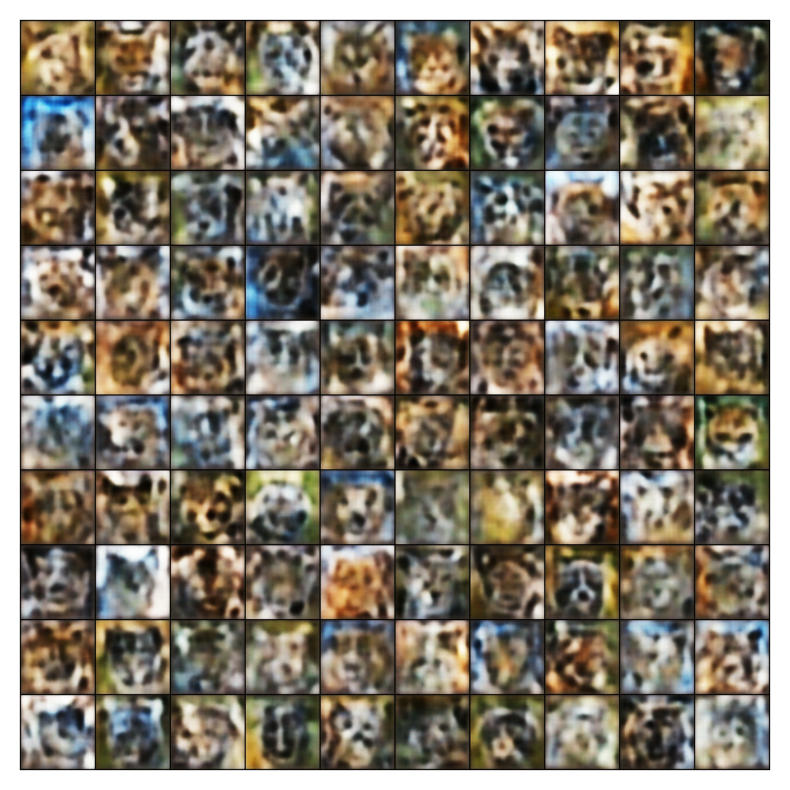

In [ ]:
def generate_and_display_samples(model, device, num_samples=100, grid_nrow=10):
  """
  Generates and displays a grid of samples from the trained VAE model.

  Args:
      model (VAE): The trained VAE model.
      device (str): The device to use ('cuda' or 'cpu').
      num_samples (int, optional): The number of samples to generate. Defaults to 100.
      grid_nrow (int, optional): The number of rows in the grid. Defaults to 10.
  """

  with torch.no_grad():
    # Generate samples from the model
    gen = model.sample(device, num_samples)

    # Create a grid of images for visualization
    grid = make_grid(gen, nrow=grid_nrow, padding=2, normalize=True)
    grid = grid.cpu().detach()

    # Display the grid of images
    plt.figure(figsize=(10, 10))
    plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
    plt.axis('off')
    plt.show()

# Load the model and generate samples
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model4 = VAE()
# Load the saved model weights
model4.load_state_dict(torch.load('/content/drive/My Drive/Project/DataSet/afhq/model_weights_100.pth'))
# Move the model to the specified device
model4 = model4.to(device)

# Generate and display samples from the loaded model
generate_and_display_samples(model4, device)

##### Reconstruction

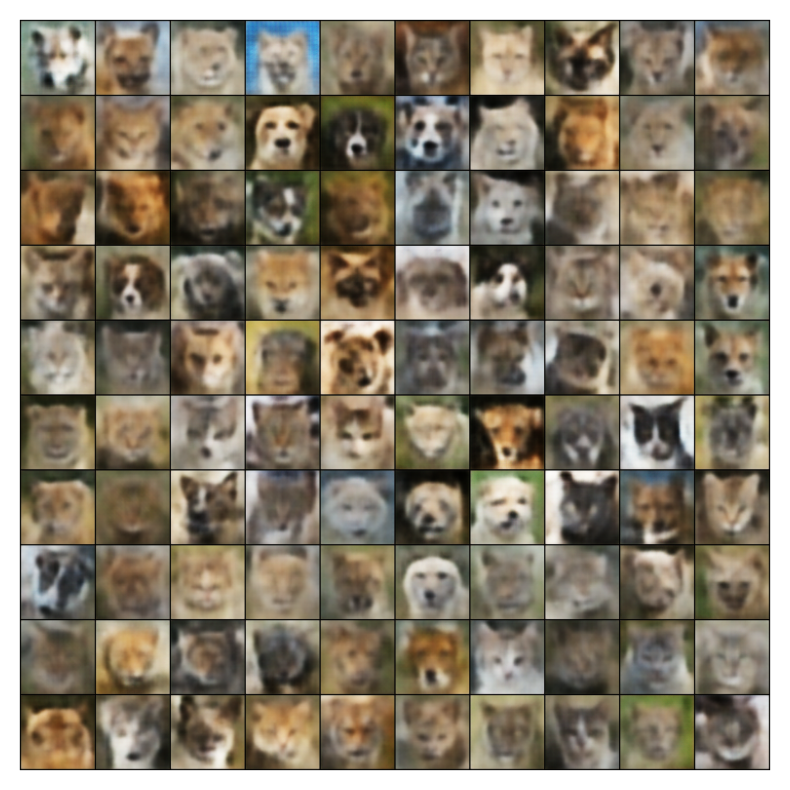

In [ ]:
def reconstruct_and_display(model, dataloader, device, grid_nrow=10):
  """
  Reconstructs an image from the dataloader using the trained VAE model
  and displays the reconstructed image in a grid.

  Args:
      model (VAE): The trained VAE model.
      dataloader (DataLoader): The dataloader containing images.
      device (str): The device to use ('cuda' or 'cpu').
      grid_nrow (int, optional): The number of rows in the grid. Defaults to 10.
  """

  with torch.no_grad():
    # Get a single batch from the dataloader
    for batch in dataloader:
        image = batch[0].to(device)
        break

    # Reconstruct the image
    gen = model.reconstruct(image)

    # Create a grid of reconstructed images for visualization
    grid = make_grid(gen, nrow=grid_nrow, padding=2, normalize=True)
    grid = grid.cpu().detach()

    # Display the grid of reconstructed images
    plt.figure(figsize=(10, 10))
    plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
    plt.axis('off')
    plt.show()

# Load the model and reconstruct an image
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model4 = VAE()
# Load the saved model weights
model4.load_state_dict(torch.load('/content/drive/My Drive/Project/DataSet/afhq/model_weights_100.pth'))
# Move the model to the specified device
model4 = model4.to(device)

# Create a dataloader for the dataset
tst = DataLoader(dataset, batch_size=100, shuffle=True)

# Reconstruct and display the image
reconstruct_and_display(model5, tst, device)

#### beta = 1000

##### Sampling

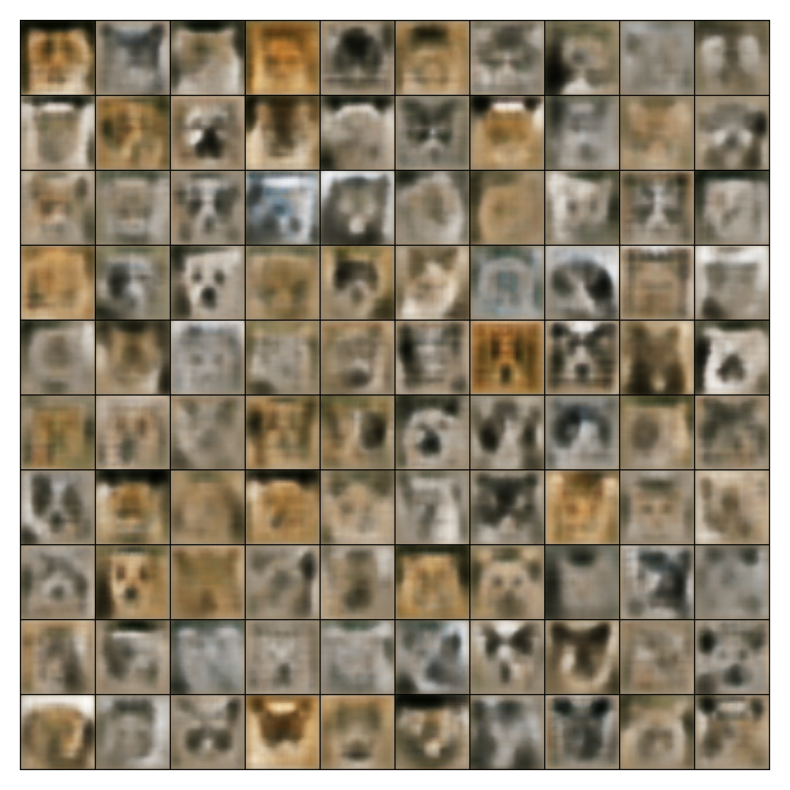

In [ ]:
def generate_and_display_samples(model, device, num_samples=100, grid_nrow=10):
  """
  Generates and displays a grid of samples from the trained VAE model.

  Args:
      model (VAE): The trained VAE model.
      device (str): The device to use ('cuda' or 'cpu').
      num_samples (int, optional): The number of samples to generate. Defaults to 100.
      grid_nrow (int, optional): The number of rows in the grid. Defaults to 10.
  """

  with torch.no_grad():
    # Generate samples from the model
    gen = model.sample(device, num_samples)

    # Create a grid of images for visualization
    grid = make_grid(gen, nrow=grid_nrow, padding=2, normalize=True)
    grid = grid.cpu().detach()

    # Display the grid of images
    plt.figure(figsize=(10, 10))
    plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
    plt.axis('off')
    plt.show()

# Load the model and generate samples
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model5 = VAE()
# Load the saved model weights
model5.load_state_dict(torch.load('/content/drive/My Drive/Project/DataSet/afhq/model_weights_b_1000.pth'))
# Move the model to the specified device
model5 = model5.to(device)

# Generate and display samples from the loaded model
generate_and_display_samples(model5, device)

##### Reconstruction

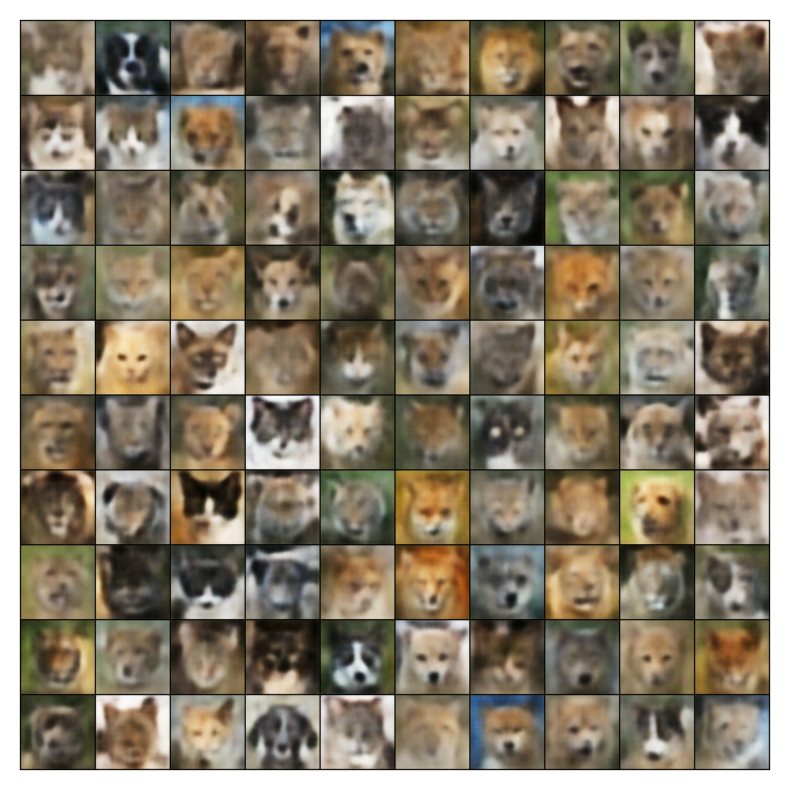

In [ ]:
def reconstruct_and_display(model, dataloader, device, grid_nrow=10):
  """
  Reconstructs an image from the dataloader using the trained VAE model
  and displays the reconstructed image in a grid.

  Args:
      model (VAE): The trained VAE model.
      dataloader (DataLoader): The dataloader containing images.
      device (str): The device to use ('cuda' or 'cpu').
      grid_nrow (int, optional): The number of rows in the grid. Defaults to 10.
  """

  with torch.no_grad():
    # Get a single batch from the dataloader
    for batch in dataloader:
        image = batch[0].to(device)
        break

    # Reconstruct the image
    gen = model.reconstruct(image)

    # Create a grid of reconstructed images for visualization
    grid = make_grid(gen, nrow=grid_nrow, padding=2, normalize=True)
    grid = grid.cpu().detach()

    # Display the grid of reconstructed images
    plt.figure(figsize=(10, 10))
    plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
    plt.axis('off')
    plt.show()

# Load the model and reconstruct an image
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model5 = VAE()
# Load the saved model weights
model5.load_state_dict(torch.load('/content/drive/My Drive/Project/DataSet/afhq/model_weights_b_1000.pth'))
# Move the model to the specified device
model5 = model5.to(device)

# Create a dataloader for the dataset
tst = DataLoader(dataset, batch_size=100, shuffle=True)

# Reconstruct and display the image
reconstruct_and_display(model5, tst, device)

### For latent dimension 32

In [ ]:
class VAE32(nn.Module):
    """
    Variational Autoencoder (VAE) with a configurable latent space dimension.

    This implementation uses a convolutional encoder and decoder architecture,
    with Leaky ReLU activations and batch normalization.

    Args:
        latent_dim (int, optional): Dimensionality of the latent space. Defaults to 32.
        in_channels (int, optional): Number of channels in the input image (e.g., 3 for RGB). Defaults to 3.
        beta (float, optional): Beta parameter for the KL-divergence loss, controlling the strength of the KL term. Defaults to 1.

    Input:
        x (torch.Tensor): Input image tensor of shape (B, C, H, W), where:
            B = Batch size
            C = Number of channels
            H = Height of the image
            W = Width of the image

    Output:
        Tuple containing:
            - Reconstructed input image (torch.Tensor) of shape (B, C, H, W)
            - Mean of the latent distribution (torch.Tensor) of shape (B, latent_dim)
            - Log variance of the latent distribution (torch.Tensor) of shape (B, latent_dim)
    """
    def __init__(self, latent_dim=32, in_channels=3, beta=1):
        super(VAE32, self).__init__()
        self.latent_dim = latent_dim
        self.beta = beta

        # --- Encoder Network ---
        self.encoder = nn.Sequential(
            # Convolutions with stride 2 for downsampling
            nn.Conv2d(in_channels, 32, kernel_size=3, stride=2, padding=1),  # (B, 32, 64, 64)
            nn.BatchNorm2d(32),
            nn.LeakyReLU(),
            nn.Conv2d(32, 64, kernel_size=3, stride=2, padding=1),            # (B, 64, 32, 32)
            nn.BatchNorm2d(64),
            nn.LeakyReLU(),
            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),           # (B, 128, 16, 16)
            nn.BatchNorm2d(128),
            nn.LeakyReLU(),
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),           # (B, 256, 8, 8)
            nn.LeakyReLU(),
        )

        # Fully connected layers for mean and log variance of the latent distribution
        self.fc_mu = nn.Linear(256 * 8 * 8, latent_dim)
        self.fc_log_var = nn.Linear(256 * 8 * 8, latent_dim)

        # --- Decoder Network ---
        self.decoder_input = nn.Linear(latent_dim, 256 * 8 * 8)  # (B, 256*8*8)
        self.decoder = nn.Sequential(
            # ConvTranspose2d with stride 2 for upsampling
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),    # (B, 128, 16, 16)
            nn.BatchNorm2d(128),
            nn.LeakyReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),     # (B, 64, 32, 32)
            nn.BatchNorm2d(64),
            nn.LeakyReLU(),
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),      # (B, 32, 64, 64)
            nn.BatchNorm2d(32),
            nn.LeakyReLU(),
            nn.ConvTranspose2d(32, in_channels, kernel_size=4, stride=2, padding=1),       # (B, 3, 128, 128)
            nn.Tanh()  # Output range -1 to 1
        )

    def encode(self, x):
        """
        Encodes the input image into the latent space, producing mean and log variance.

        Args:
            x (torch.Tensor): Input image tensor of shape (B, C, H, W).

        Returns:
            Tuple containing:
                - Mean of the latent distribution (torch.Tensor) of shape (B, latent_dim).
                - Log variance of the latent distribution (torch.Tensor) of shape (B, latent_dim).
        """
        encoded = self.encoder(x)
        encoded = torch.flatten(encoded, start_dim=1)
        mu = self.fc_mu(encoded)
        log_var = self.fc_log_var(encoded)
        return mu, log_var

    def decode(self, z):
        """
        Decodes a latent space representation into an image.

        Args:
            z (torch.Tensor): Latent space representation of shape (B, latent_dim).

        Returns:
            Decoded image tensor of shape (B, C, H, W).
        """
        decoded = self.decoder_input(z)
        decoded = torch.reshape(decoded, (-1, 256, 8, 8))
        decoded = self.decoder(decoded)
        return decoded

    def reparameterize(self, mu, log_var):
        """
        Samples from the latent distribution using the reparameterization trick.

        Args:
            mu (torch.Tensor): Mean of the latent distribution (B, latent_dim).
            log_var (torch.Tensor): Log variance of the latent distribution (B, latent_dim).

        Returns:
            Sampled latent space representations (torch.Tensor) of shape (B, latent_dim).
        """
        std = torch.exp(0.5 * log_var)
        eps = torch.randn_like(std)
        return mu + std * eps

    def forward(self, x):
        """
        Forward pass of the VAE.

        Args:
            x (torch.Tensor): Input image tensor.

        Returns:
            Tuple containing:
                - Reconstructed input image (torch.Tensor) of shape (B, C, H, W)
                - Mean of the latent distribution (torch.Tensor) of shape (B, latent_dim)
                - Log variance of the latent distribution (torch.Tensor) of shape (B, latent_dim)
        """
        mu, log_var = self.encode(x)
        z = self.reparameterize(mu, log_var)
        x_reconstructed = self.decode(z)
        return x_reconstructed, mu, log_var

    def loss(self, x, x_reconstructed, mu, log_var):
        """
        Calculates the VAE loss, combining reconstruction error and KL divergence.

        Args:
            x (torch.Tensor): Original input image.
            x_reconstructed (torch.Tensor): Reconstructed image.
            mu (torch.Tensor): Mean of the latent distribution.
            log_var (torch.Tensor): Log variance of the latent distribution.

        Returns:
            Tuple containing:
                - Total loss (torch.Tensor).
                - Reconstruction loss (torch.Tensor).
                - KL-divergence loss (torch.Tensor).
        """
        x = torch.flatten(x, start_dim=1)
        x_reconstructed = torch.flatten(x_reconstructed, start_dim=1)
        reconstruction_loss = F.mse_loss(x_reconstructed, x) # Mean squared error loss
        kl_divergence_loss = -0.5 * torch.sum(1 + log_var - mu ** 2 - log_var.exp()) # KL-divergence loss
        loss = reconstruction_loss + self.beta * kl_divergence_loss
        return loss, reconstruction_loss, kl_divergence_loss

    def reconstruct(self, x):
        """
        Reconstructs an input image using the VAE.

        Args:
            x (torch.Tensor): Input image tensor.

        Returns:
            Reconstructed image tensor (torch.Tensor).
        """
        x_reconstructed, _, _ = self.forward(x)
        return x_reconstructed

    def sample(self, device, num_samples):
        """
        Generates random samples from the VAE.

        Args:
            device (torch.device): Device to generate samples on (e.g., 'cuda' or 'cpu').
            num_samples (int): Number of samples to generate.

        Returns:
            Generated image tensor (torch.Tensor) of shape (num_samples, C, H, W).
        """
        z = torch.randn((num_samples, self.latent_dim)).to(device)
        x_generated = self.decode(z)
        return x_generated

##### Sampling

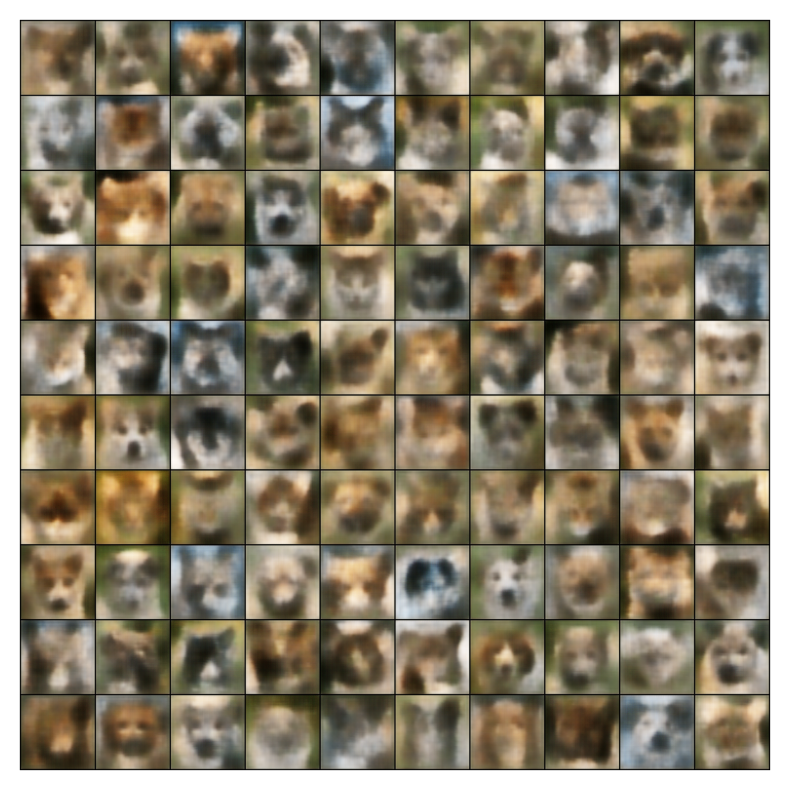

In [ ]:
def generate_and_display_samples(model, device, num_samples=100, grid_nrow=10):
  """
  Generates and displays a grid of samples from the trained VAE model.

  Args:
      model (VAE): The trained VAE model.
      device (str): The device to use ('cuda' or 'cpu').
      num_samples (int, optional): The number of samples to generate. Defaults to 100.
      grid_nrow (int, optional): The number of rows in the grid. Defaults to 10.
  """

  with torch.no_grad():
    # Generate samples from the model
    gen = model.sample(device, num_samples)

    # Create a grid of images for visualization
    grid = make_grid(gen, nrow=grid_nrow, padding=2, normalize=True)
    grid = grid.cpu().detach()

    # Display the grid of images
    plt.figure(figsize=(10, 10))
    plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
    plt.axis('off')
    plt.show()

# Load the model and generate samples
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model6 = VAE32()
# Load the saved model weights
model6.load_state_dict(torch.load('/content/drive/My Drive/Project/DataSet/afhq/model_weights_32_dim.pth'))
# Move the model to the specified device
model6 = model6.to(device)

# Generate and display samples from the loaded model
generate_and_display_samples(model6, device)

##### Reconstruction

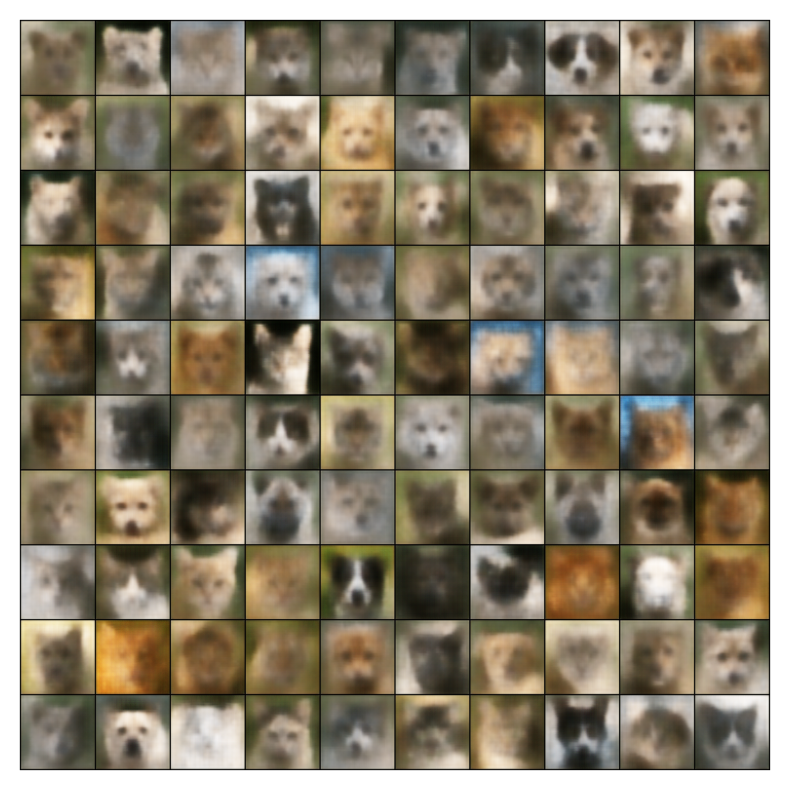

In [ ]:
def reconstruct_and_display(model, dataloader, device, grid_nrow=10):
  """
  Reconstructs an image from the dataloader using the trained VAE model
  and displays the reconstructed image in a grid.

  Args:
      model (VAE): The trained VAE model.
      dataloader (DataLoader): The dataloader containing images.
      device (str): The device to use ('cuda' or 'cpu').
      grid_nrow (int, optional): The number of rows in the grid. Defaults to 10.
  """

  with torch.no_grad():
    # Get a single batch from the dataloader
    for batch in dataloader:
        image = batch[0].to(device)
        break

    # Reconstruct the image
    gen = model.reconstruct(image)

    # Create a grid of reconstructed images for visualization
    grid = make_grid(gen, nrow=grid_nrow, padding=2, normalize=True)
    grid = grid.cpu().detach()

    # Display the grid of reconstructed images
    plt.figure(figsize=(10, 10))
    plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
    plt.axis('off')
    plt.show()

# Load the model and reconstruct an image
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model6 = VAE32()
# Load the saved model weights
model6.load_state_dict(torch.load('/content/drive/My Drive/Project/DataSet/afhq/model_weights_32_dim.pth'))
# Move the model to the specified device
model6 = model6.to(device)

# Create a dataloader for the dataset
tst = DataLoader(dataset, batch_size=100, shuffle=True)

# Reconstruct and display the image
reconstruct_and_display(model6, tst, device)

### Training CNN classifier on image domain

In [ ]:
class CNN_Classifier(nn.Module):
    """
    Convolutional Neural Network (CNN) classifier for image classification.

    This implementation uses a basic CNN architecture with Leaky ReLU activations.
    The network consists of a convolutional block followed by fully connected layers.

    Args:
        in_channels (int, optional): Number of channels in the input image (e.g., 3 for RGB). Defaults to 3.

    Input:
        x (torch.Tensor): Input image tensor of shape (B, C, H, W), where:
            B = Batch size
            C = Number of channels
            H = Height of the image
            W = Width of the image

    Output:
        Predicted class probabilities (torch.Tensor) of shape (B, num_classes).
    """
    def __init__(self, in_channels=3):
        super(CNN_Classifier, self).__init__()

        # --- Convolutional Block ---
        self.block1 = nn.Sequential(
            nn.Conv2d(in_channels, 32, kernel_size=3, stride=2, padding=1),   # (B, 32, 64, 64)
            nn.LeakyReLU(),
            nn.Conv2d(32, 64, kernel_size=3, stride=2, padding=1),            # (B, 64, 32, 32)
            nn.LeakyReLU(),
        )

        # --- Fully Connected Layers ---
        self.fc = nn.Sequential(
            nn.Linear(64 * 32 * 32, 512),
            nn.LeakyReLU(),
            nn.Linear(512, 32),
            nn.LeakyReLU(),
            nn.Linear(32, 3),
            nn.Softmax(dim=1)
        )

        self.ce_loss = nn.CrossEntropyLoss()

    def forward(self, x):
        """
        Forward pass of the CNN classifier.

        Args:
            x (torch.Tensor): Input image tensor.

        Returns:
            Predicted class probabilities (torch.Tensor) of shape (B, num_classes).
        """
        x = self.block1(x)
        x = x.view(x.shape[0], -1)  # Flatten the feature map
        x = self.fc(x)
        return x

    def loss(self, y_pred, y):
        """
        Calculates the cross-entropy loss.

        Args:
            y_pred (torch.Tensor): Predicted class probabilities.
            y (torch.Tensor): True labels.

        Returns:
            Cross-entropy loss (torch.Tensor).
        """
        return self.ce_loss(y_pred, y)

In [ ]:
# --- Data Loading and Training ---

# Define image transformations for preprocessing
transform = transforms.Compose([
    transforms.Resize(128),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

# Load training data
train_dataset = ImageFolder(root='/content/drive/My Drive/Project/DataSet/afhq/train', transform=transform)
train_dataloader = DataLoader(train_dataset, batch_size=256, shuffle=True)

In [ ]:
# --- Model Initialization and Training ---

device = 'cuda' if torch.cuda.is_available() else 'cpu'

model_cnn = CNN_Classifier().to(device)
optimizer = optim.Adam(model_cnn.parameters(), lr=0.0001)
epochs = 10

# Training Loop
for epoch in range(epochs):
    total_loss = 0
    for image_batch in train_dataloader:
        x = image_batch[0].to(device)
        labels = image_batch[1].to(device)
        y_pred = model_cnn(x)
        loss = model_cnn.loss(y_pred, labels)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

    print(f'Epoch {epoch+1}/{epochs} - Loss: {total_loss:.4f}')

Epoch: 1/10 - Loss: 53.6675
Epoch: 2/10 - Loss: 44.8405
Epoch: 3/10 - Loss: 42.3725
Epoch: 4/10 - Loss: 41.3176
Epoch: 5/10 - Loss: 39.7488
Epoch: 6/10 - Loss: 38.4896
Epoch: 7/10 - Loss: 37.6675
Epoch: 8/10 - Loss: 36.8631
Epoch: 9/10 - Loss: 36.4436
Epoch: 10/10 - Loss: 35.8673


In [ ]:
# Save the trained model weights
torch.save(model_cnn.state_dict(), '/content/drive/My Drive/Project/DataSet/afhq/model_weights_cnn.pth')

In [ ]:
# Train Accuracy
with torch.no_grad():
    correct = 0
    total = 0
    for image_batch in train_dataloader:
        x = image_batch[0].to(device)
        labels = image_batch[1].to(device)
        y_pred = model_cnn(x)
        _, predicted = torch.max(y_pred.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    print(f'Train Accuracy: {100 * correct / total:.2f}%')

Train Accuracy: 94.87354750512645


In [ ]:
# --- Evaluation ---

# Load test data
test_dataset = ImageFolder(root='/content/drive/My Drive/Project/DataSet/afhq/val', transform=transform)
test_dataloader = DataLoader(test_dataset, batch_size=128, shuffle=True)

# Evaluation Loop
with torch.no_grad():
    correct = 0
    total = 0
    for image_batch in test_dataloader:
        x = image_batch[0].to(device)
        labels = image_batch[1].to(device)
        y_pred = model_cnn(x)
        _, predicted = torch.max(y_pred.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    print(f'Test Accuracy: {100 * correct / total:.2f}%')

Test Accuracy: 90.86666666666666


### Training classifier on z domain

In [ ]:
device = 'cuda'
model = VAE().to(device)  # Load your VAE model
model.load_state_dict(torch.load('/content/drive/My Drive/Project/DataSet/afhq/model_weights_z_1.pth'))

In [ ]:
def extract_latent_vectors(dataloader, model):
  """
  Extracts latent vectors and labels from a dataloader.

  Args:
      dataloader (DataLoader): The dataloader to iterate over.
      model (VAE): The VAE model for encoding.

  Returns:
      tuple: A tuple containing the latent vectors and labels as tensors.
  """
  z_vectors = []
  y_vectors = []
  with torch.no_grad():
    for image in dataloader:
      x = image[0].to(device)
      y = image[1].to(device)
      mu, log_var = model.encode(x)
      z = model.reparametrization(mu, log_var, 1)
      z_vectors.append(z)
      y_vectors.append(y)
  return torch.cat(z_vectors, dim=0), torch.cat(y_vectors, dim=0)

# Extract latent vectors from training and test datasets
z_tensor_train, y_tensor_train = extract_latent_vectors(dataloader, model)
z_tensor_test, y_tensor_test = extract_latent_vectors(testdataloader, model)

print(z_tensor_train.shape)  # Print shape of latent vectors

# Save latent vectors and labels
torch.save(z_tensor_train, 'z_tensors_train.pth')
torch.save(y_tensor_train, 'y_tensors_train.pth')
torch.save(z_tensor_test, 'z_tensors_test.pth')
torch.save(y_tensor_test, 'y_tensors_test.pth')

torch.Size([14630, 128])


In [ ]:
# Custom dataset for latent vectors and labels
class z_dataset(Dataset):
    def __init__(self, z_tensor, y_tensor):
        self.z_tensor = z_tensor
        self.y_tensor = y_tensor

    def __len__(self):
        return len(self.z_tensor)

    def __getitem__(self, idx):
        return self.z_tensor[idx], self.y_tensor[idx]

# Create dataloaders for latent vectors
z_data_train = z_dataset(z_tensor_train, y_tensor_train)
z_train_dataloader = DataLoader(z_data_train, batch_size=128, shuffle=True)

z_data_test = z_dataset(z_tensor_test, y_tensor_test)
z_test_dataloader = DataLoader(z_data_test, batch_size=128, shuffle=True)

In [ ]:
class latent_vector_classifier(nn.Module):
    def __init__(self, z_dim=128):
        super(latent_vector_classifier, self).__init__()

        self.fc = nn.Sequential(
            nn.Linear(z_dim, 64),
            nn.LeakyReLU(),
            nn.Linear(64, 32),
            nn.LeakyReLU(),
            nn.Linear(32, 16),
            nn.LeakyReLU(),
            nn.Linear(16, 3),
            nn.Softmax(dim=1)  # B X 3
        )

        self.ce_loss = nn.CrossEntropyLoss()

    def forward(self, z):
        return self.fc(z)  # B X 3

    def loss(self, y_pred, y):
        return self.ce_loss(y_pred, y)

model_vd = latent_vector_classifier().to(device)

optimizer = optim.Adam(model_vd.parameters(), lr=0.001)

epochs = 10
for i in range(epochs):
  tot_loss = 0
  for vector in z_train_dataloader:
    z = vector[0].to(device)
    y = vector[1].to(device)
    y_pred = model_vd.forward(z)
    loss = model_vd.loss(y_pred, y)
    tot_loss += loss
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
  print(f'Epoch {i+1}: Total loss = {tot_loss}')

Epoch 1: Total loss = 106.20236206054688
Epoch 2: Total loss = 80.83395385742188
Epoch 3: Total loss = 78.51630859375
Epoch 4: Total loss = 76.83769226074219
Epoch 5: Total loss = 75.2979736328125
Epoch 6: Total loss = 74.08837890625
Epoch 7: Total loss = 73.03546142578125
Epoch 8: Total loss = 72.25369262695312
Epoch 9: Total loss = 71.58028106689453
Epoch 10: Total loss = 70.74298095703125


In [ ]:
def calculate_accuracy(dataloader, model):
  """
  Calculates the accuracy of the model on a given dataloader.

  Args:
      dataloader (DataLoader): The dataloader to evaluate on.
      model (nn.Module): The model to use for prediction.

  Returns:
      float: The accuracy of the model.
  """
  count = 0
  total_count = 0
  with torch.no_grad():
    for vector in dataloader:
      z = vector[0].to(device)
      labels = vector[1].to(device)
      y = model_vd.forward(z)
      ans = torch.argmax(y, dim=1)
      count += torch.sum(labels == ans).item()
      total_count += z.shape[0]
  return count / total_count

# Evaluate accuracy on training and test sets
train_acc = calculate_accuracy(z_train_dataloader, model_vd)
test_acc = calculate_accuracy(z_test_dataloader, model_vd)

print(f"Train accuracy: {train_acc}")
print(f"Test accuracy: {test_acc}")

Train accuracy: 0.945
Test accuracy: 0.858


### Comparing MLP and CNN Classifiers for Z-Latent Based Classification

This analysis demonstrates a compelling advantage of using a Multi-Layer Perceptron (MLP) classifier over a Convolutional Neural Network (CNN) for classifying data based on z-latent representations.

**Network Size and Training Efficiency:**

The MLP classifier exhibits a significantly smaller network size compared to the CNN. This translates into substantial improvements in training time. While the MLP classifier can be trained within a minute, the CNN requires approximately 20 minutes to complete training for the same number of epochs. This dramatic difference in training efficiency is a key benefit of using the MLP.

**Training Accuracy and Generalization:**

While both classifiers demonstrate comparable training accuracies, reaching around 94% on the training set, the CNN outperforms the MLP in terms of test set accuracy. This difference is likely attributable to the CNN's ability to capture more intricate and complex patterns within the 128-dimensional latent space compared to the MLP.

**Conclusion:**

The choice between an MLP and CNN classifier for z-latent based classification ultimately depends on the specific requirements of the task. For applications where training time is a critical factor and a slightly lower test accuracy is acceptable, the MLP offers a compelling alternative to the CNN. Conversely, when high accuracy on unseen data is paramount, the CNN's superior ability to extract features from the latent space justifies its increased training time.


### Interpolated Latents: Bridging the Gap Between Images

This section explores the fascinating concept of interpolated latents, a technique that leverages the power of latent representations to create smooth transitions between images.

**The Process:**

1. **Image Acquisition:** A pair of images is selected as the starting points for the interpolation.
2. **Latent Representation:** Each image is transformed into its corresponding latent representation. This latent representation captures the essence of the image, often in a lower-dimensional space compared to the original image data.
3. **Interpolation:** The two latent representations are then interpolated. This involves blending the information contained in each latent vector, creating a series of intermediate representations.
4. **Reconstruction:** Finally, each interpolated latent representation is decoded back into an image, revealing a smooth transition between the original two images.

In [ ]:
class ImageInterpolator:
    """
    Class to interpolate between images using a VAE model and display the results.

    Attributes:
        vae_model (VAE): The trained VAE model.
        device (str): The device to use for computations (CPU or GPU).
    """

    def __init__(self, vae_model, device='cuda'):
        """
        Initializes the ImageInterpolator with the VAE model and device.

        Args:
            vae_model (VAE): The trained VAE model.
            device (str): The device to use for computations (default: 'cuda').
        """
        self.vae_model = vae_model
        self.device = device

    def interpolate_and_display(self, dataset, num_interpolations=10, batch_size=2):
        """
        Interpolates between images and displays the results in a grid.

        Args:
            dataset (Dataset): The dataset to sample images from.
            num_interpolations (int): The number of interpolations between each pair of images (default: 10).
            batch_size (int): The batch size for sampling images (default: 2).
        """
        grid = []
        for _ in range(num_interpolations):
            # Create a small dataloader for two images
            image_dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
            # Get the first batch from the dataloader
            for images in image_dataloader:
                break

            # Extract the first two images from the batch
            img0 = images[0][0]  # First image
            img0 = torch.unsqueeze(img0, 0)  # Add batch dimension
            img1 = images[0][1]  # Second image
            img1 = torch.unsqueeze(img1, 0)  # Add batch dimension

            # Encode the images and get latent vectors
            mu, log_var = self.vae_model.encode(img0.to(self.device))
            latent_vector_0 = self.vae_model.reparametrization(mu, log_var, 1)

            mu, log_var = self.vae_model.encode(img1.to(self.device))
            latent_vector_1 = self.vae_model.reparametrization(mu, log_var, 1)

            # Interpolate between latent vectors
            for i in range(11):  # 11 steps including the start and end points
                latent_vector = latent_vector_0 + i * (latent_vector_1 - latent_vector_0) / 10
                interpolated_image = self.vae_model.decode(latent_vector)

                # Preprocess the image for display
                interpolated_image = interpolated_image[0].cpu().detach()  # Remove batch dimension and move to CPU
                interpolated_image = interpolated_image.permute(1, 2, 0).numpy()  # Permute dimensions for Matplotlib
                grid.append(interpolated_image)

        # Display the images in a grid
        fig, axs = plt.subplots(num_interpolations, 11, figsize=(10, 10))
        for i in range(num_interpolations):
            for j in range(11):
                index = i * 11 + j
                img = grid[index] / 2 + 0.5  # Normalize for visualization
                axs[i, j].imshow(img)
                axs[i, j].axis('off')

        plt.tight_layout()
        plt.show()

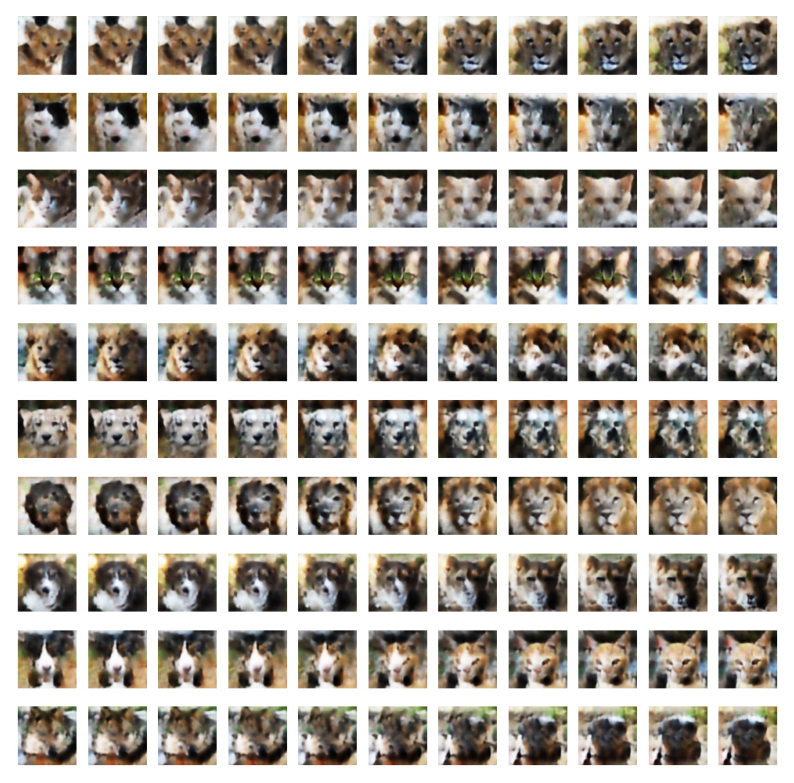

In [ ]:
# Load the VAE model and create the ImageInterpolator
vae_model = VAE().to(device)
vae_model.load_state_dict(torch.load('/content/drive/My Drive/Project/DataSet/afhq/model_weights_z_1.pth'))

image_interpolator = ImageInterpolator(vae_model, device)

# Create the dataset and the dataloader (assuming you have defined the 'dataset' variable)
transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]) # Normalizing between -1 to 1
])
dataset = ImageFolder(root='/content/drive/My Drive/Project/DataSet/afhq/train', transform=transform)

# Perform the interpolation and display the results
image_interpolator.interpolate_and_display(dataset)

# Vanilla Autoencoder

## Dataloader

In [ ]:
# Define data transformations
def create_transform(image_size: int = 128) -> transforms.Compose:
  """
  Creates a transformation pipeline for images.

  Args:
    image_size (int, optional): The desired size for resizing images. Defaults to 128.

  Returns:
    transforms.Compose: A transformation pipeline.
  """
  return transforms.Compose([
      transforms.Resize((image_size, image_size)),
      transforms.ToTensor(),
      transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])  # Normalizes to range [-1, 1]
  ])

# Create training and validation datasets
train_dataset = ImageFolder(root='/content/drive/My Drive/Project/DataSet/afhq/train', transform=create_transform())
validation_dataset = ImageFolder(root='/content/drive/My Drive/Project/DataSet/afhq/val', transform=create_transform())

# Create data loaders
batch_size = 256
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=False)
validation_dataloader = DataLoader(validation_dataset, batch_size=batch_size, shuffle=False)

## Autoencoder Class

In [ ]:
class Autoencoder(nn.Module):
  """
  An Autoencoder model for image reconstruction.

  Args:
    embedding_dim (int, optional): The dimension of the latent space. Defaults to 256.
    in_channels (int, optional): The number of channels in the input image. Defaults to 3.

  Attributes:
    embedding_dim (int): The dimension of the latent space.
    encoder (nn.Sequential): The encoder network.
    decoder (nn.Sequential): The decoder network.

  Methods:
    forward(x): The forward pass of the autoencoder.
  """

  def __init__(self, embedding_dim: int = 256, in_channels: int = 3):
    """
    Initializes the Autoencoder model.
    """
    super().__init__()
    self.embedding_dim = embedding_dim
    self.in_channels = in_channels

    # Define the encoder network
    self.encoder = nn.Sequential(
        nn.Conv2d(self.in_channels, 32, kernel_size=3, stride=2, padding=1),  # Input: B x 3 x 128 x 128, Output: B x 32 x 64 x 64
        nn.BatchNorm2d(32),
        nn.LeakyReLU(),
        nn.Conv2d(32, 64, kernel_size=3, stride=2, padding=1),             # Input: B x 32 x 64 x 64, Output: B x 64 x 32 x 32
        nn.BatchNorm2d(64),
        nn.LeakyReLU(),
        nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),            # Input: B x 64 x 32 x 32, Output: B x 128 x 16 x 16
        nn.BatchNorm2d(128),
        nn.LeakyReLU(),
        nn.Conv2d(128, 128, kernel_size=3, stride=2, padding=1),            # Input: B x 128 x 16 x 16, Output: B x 128 x 8 x 8
        nn.LeakyReLU(),
        nn.Conv2d(128, self.embedding_dim, kernel_size=8, stride=1, padding=0),  # Input: B x 128 x 8 x 8, Output: B x 128 x 1 x 1
        nn.Tanh()
    )

    # Define the decoder network
    self.decoder = nn.Sequential(
        nn.ConvTranspose2d(self.embedding_dim, 128, kernel_size=8, stride=1, padding=0),  # Input: B x 128 x 1 x 1, Output: B x 128 x 8 x 8
        nn.BatchNorm2d(128),
        nn.LeakyReLU(),
        nn.ConvTranspose2d(128, 128, kernel_size=3, stride=2, padding=1, output_padding=1),  # Input: B x 128 x 8 x 8, Output: B x 128 x 16 x 16
        nn.BatchNorm2d(128),
        nn.LeakyReLU(),
        nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),   # Input: B x 128 x 16 x 16, Output: B x 64 x 32 x 32
        nn.BatchNorm2d(64),
        nn.LeakyReLU(),
        nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),   # Input: B x 64 x 32 x 32, Output: B x 32 x 64 x 64
        nn.BatchNorm2d(32),
        nn.LeakyReLU(),
        nn.ConvTranspose2d(32, self.in_channels, kernel_size=3, stride=2, padding=1, output_padding=1), # Input: B x 32 x 64 x 64, Output: B x 3 x 128 x 128
        nn.Tanh()
    )

  def forward(self, x: torch.Tensor) -> torch.Tensor:
    """
    The forward pass of the autoencoder.

    Args:
      x (torch.Tensor): The input image tensor.

    Returns:
      torch.Tensor: The reconstructed image tensor.
    """
    encoded = self.encoder(x)
    decoded = self.decoder(encoded)
    return decoded

In [ ]:
# Initialize the model
model = Autoencoder()

# Define the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Define loss function and optimizer
criterion = nn.MSELoss()
optimizer = Adam(model.parameters(), lr=1e-3, weight_decay=1e-5)

## Training Autoencoder

In [ ]:
class AutoencoderTrainer:
    """
    Trains an autoencoder model.

    Attributes:
        model: The autoencoder model.
        optimizer: The optimizer used for training.
        criterion: The loss function for training.
        validation_criterion: The loss function for validation.
        num_epochs: The number of epochs to train for.
        device: The device to train on (CPU or GPU).
        training_dataloader: The dataloader for the training data.
        validation_dataloader: The dataloader for the validation data.
        training_losses: A list to store the training losses for each epoch.
        validation_losses: A list to store the validation losses for each epoch.
        outputs: A list to store the outputs of the model for each epoch.
    """

    def __init__(self, model, optimizer, criterion, validation_criterion, num_epochs, device, training_dataloader, validation_dataloader):
        """
        Initializes the AutoencoderTrainer class.

        Args:
            model: The autoencoder model.
            optimizer: The optimizer used for training.
            criterion: The loss function for training.
            validation_criterion: The loss function for validation.
            num_epochs: The number of epochs to train for.
            device: The device to train on (CPU or GPU).
            training_dataloader: The dataloader for the training data.
            validation_dataloader: The dataloader for the validation data.
        """
        self.model = model
        self.optimizer = optimizer
        self.criterion = criterion
        self.validation_criterion = validation_criterion
        self.num_epochs = num_epochs
        self.device = device
        self.training_dataloader = training_dataloader
        self.validation_dataloader = validation_dataloader
        self.training_losses = []
        self.validation_losses = []
        self.outputs = []

    def train(self):
        """
        Trains the autoencoder model.
        """
        for epoch in range(self.num_epochs):
            # Save model weights every 10 epochs
            if epoch % 10 == 0:
                self.save_model()

            # Training phase
            self.model.train()
            for img in self.training_dataloader:
                x = img[0].to(self.device)
                recon = self.model(x)
                loss = self.criterion(recon, x)

                # Backpropagation
                self.optimizer.zero_grad()
                loss.backward()
                self.optimizer.step()

                # Clear CUDA cache
                torch.cuda.empty_cache()

            # Validation phase
            self.model.eval()
            validation_loss = 0.0
            with torch.no_grad():
                for val_img in self.validation_dataloader:
                    x = val_img[0].to(self.device)
                    val_recon = self.model(x)
                    val_loss = self.validation_criterion(val_recon, x)
                    validation_loss += val_loss.item()

            # Calculate average validation loss
            validation_loss /= len(self.validation_dataloader)

            # Print training and validation losses
            print(f'Epoch:{epoch+1}, Training Loss:{loss.item():.4f}, Validation Loss: {validation_loss:.4f}')

            # Store losses and outputs
            self.training_losses.append(loss.item())
            self.validation_losses.append(validation_loss)
            self.outputs.append((epoch, img, recon))

    def save_model(self):
        """
        Saves the model weights to disk.
        """
        model_path = '/content/drive/My Drive/Project/DataSet/afhq/AE_model_weights.pth'
        if os.path.exists(model_path):
            os.remove(model_path)
        torch.save(self.model.state_dict(), model_path)

    def visualize_results(self):
        """
        Visualizes the input images and their reconstructions for selected epochs.
        """
        for k in range(0, self.num_epochs, 10):
            plt.figure(figsize=(9, 2))
            plt.gray()
            input_images = self.outputs[k][1][0].detach().cpu().numpy()
            reconstructed_images = self.outputs[k][2].detach().cpu().numpy()

            # Visualize 9 input images
            for i, image in enumerate(input_images):
                if i >= 9: break
                plt.subplot(2, 9, i + 1)
                plt.imshow(self.inverse_normalize(image).transpose(1, 2, 0))

            # Visualize 9 reconstructed images
            for i, image in enumerate(reconstructed_images):
                if i >= 9: break
                plt.subplot(2, 9, 9 + i + 1)
                plt.imshow(self.inverse_normalize(image).transpose(1, 2, 0))

            # Display the plot
            plt.show()

    def inverse_normalize(self, image):
        """
        Denormalizes an image from [-1, 1] to [0, 1].

        Args:
            image: The image to denormalize.

        Returns:
            The denormalized image.
        """
        return (image + 1) / 2.0

    def plot_loss_curves(self):
        """
        Plots the training and validation loss curves over epochs.
        """
        epochs = np.arange(1, self.num_epochs + 1)
        plt.figure(figsize=(8, 6))
        plt.plot(epochs, self.training_losses, marker='o', linestyle='-', label='Training Loss', color='blue')
        plt.plot(epochs, self.validation_losses, marker='o', linestyle='-', label='Validation Loss', color='orange')
        plt.title('Training and Validation Loss vs. Number of Epochs')
        plt.xlabel('Number of Epochs')
        plt.ylabel('Loss')
        plt.grid(True)
        plt.legend()
        plt.show()

    def save_embeddings_to_csv(self, dataloader, save_dir):
        """
        Saves the embeddings and labels from a dataloader to a CSV file.

        Args:
            dataloader: The dataloader containing the data.
            save_dir: The directory to save the CSV file.
        """
        self.model.encoder.eval()  # Set the encoder to evaluation mode
        data = {'Embeddings': [], 'Label': []}

        with torch.no_grad():
            for images, labels in dataloader:
                images = images.to(self.device)
                embeddings = self.model.encoder(images)

                for i, label in enumerate(labels):
                    data['Embeddings'].append(embeddings[i].cpu().numpy().flatten())
                    data['Label'].append(int(label))

        # Create a DataFrame and save to CSV
        df = pd.DataFrame(data)
        csv_file = os.path.join(save_dir, 'embeddings.csv')
        df.to_csv(csv_file, index=False)

    def save_embeddings(self, dataloader):
        """
        Saves the embeddings after training is complete.
        """
        save_dir = '/content/drive/My Drive/Project/DataSet/afhq/embeddings'
        os.makedirs(save_dir, exist_ok=True)  # Create the directory if it doesn't exist
        self.save_embeddings_to_csv(dataloader, save_dir)

    def cluster_embeddings(self, csv_file, n_components=3, n_samples=100):
        """
        Clusters the embeddings from a CSV file using Gaussian Mixture Models (GMM).

        Args:
            csv_file: The path to the CSV file containing the embeddings.
            n_components: The number of components for the GMM.
            n_samples: The number of samples to generate from the trained GMM.

        Returns:
            A tuple containing the trained GMM model, the generated samples,
            and the original embeddings.
        """

        # Read the CSV file
        df = pd.read_csv(csv_file)

        # Convert 'Embeddings' strings to float arrays
        pattern = r'[-+]?\d*\.\d+([eE][-+]?\d+)?'
        df['Embeddings'] = df['Embeddings'].apply(lambda x: [float(match.group()) for match in re.finditer(pattern, x)])

        # Extract embeddings and labels
        embeddings = np.array(df['Embeddings'].values.tolist())
        labels = df['Label'].values

        # Train GMM
        gmm = GaussianMixture(n_components=n_components, random_state=0)
        gmm.fit(embeddings)

        # Generate samples
        samples = gmm.sample(n_samples)

        return gmm, samples, embeddings

    def decode_and_display_images(self, saved_model_weights_path, embeddings):
        """
        Decodes embeddings using the trained decoder and displays the reconstructed images.

        Args:
            saved_model_weights_path: Path to the saved model weights file.
            embeddings: A list of embeddings to decode.
        """
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

        # Load the model and weights
        model = self.model  # Use the trained model
        model.load_state_dict(torch.load(saved_model_weights_path))
        model.to(device)
        model.eval()

        # Prepare embeddings for decoding
        embeddings = [torch.tensor(emb, dtype=torch.float32) for emb in embeddings]
        embeddings = torch.stack(embeddings)
        embeddings = embeddings.view(embeddings.size(0), 128, 1, 1)  # Assuming 128-dimensional embeddings
        embeddings = embeddings.to(device)

        # Decode embeddings
        with torch.no_grad():
            reconstructed_images = model.decoder(embeddings)

        # Normalize images to [0, 1]
        reconstructed_images = (reconstructed_images - reconstructed_images.min()) / (
            reconstructed_images.max() - reconstructed_images.min()
        )

        # Inverse transform for PIL image conversion
        inverse_transform = transforms.Compose([transforms.ToPILImage()])

        # Plot the images
        rows, cols = 10, 10
        fig, axes = plt.subplots(rows, cols, figsize=(10, 10))
        for i in range(reconstructed_images.size(0)):
            row = i // 10
            col = i % 10
            reconstructed_image = reconstructed_images[i].squeeze().cpu()
            reconstructed_image = inverse_transform(reconstructed_image)
            axes[row, col].imshow(np.asarray(reconstructed_image))
            axes[row, col].axis("off")
        plt.show()

In [ ]:
# Create an instance of the AutoencoderTrainer class
trainer = AutoencoderTrainer(model, optimizer, criterion, validation_criterion, num_epochs, device, train_dataloader, validation_dataloader)

# Train the autoencoder
trainer.train()

Epoch:1, Training Loss:0.0863, Validation Loss: 0.0838
Epoch:2, Training Loss:0.0821, Validation Loss: 0.0798
Epoch:3, Training Loss:0.0795, Validation Loss: 0.0759
Epoch:4, Training Loss:0.0770, Validation Loss: 0.0726
Epoch:5, Training Loss:0.0750, Validation Loss: 0.0709
Epoch:6, Training Loss:0.0727, Validation Loss: 0.0696
Epoch:7, Training Loss:0.0711, Validation Loss: 0.0699
Epoch:8, Training Loss:0.0694, Validation Loss: 0.0688
Epoch:9, Training Loss:0.0682, Validation Loss: 0.0663
Epoch:10, Training Loss:0.0677, Validation Loss: 0.0663
Epoch:11, Training Loss:0.0667, Validation Loss: 0.0680
Epoch:12, Training Loss:0.0658, Validation Loss: 0.0638
Epoch:13, Training Loss:0.0648, Validation Loss: 0.0652
Epoch:14, Training Loss:0.0642, Validation Loss: 0.0649
Epoch:15, Training Loss:0.0640, Validation Loss: 0.0649
Epoch:16, Training Loss:0.0629, Validation Loss: 0.0664
Epoch:17, Training Loss:0.0620, Validation Loss: 0.0638
Epoch:18, Training Loss:0.0612, Validation Loss: 0.0639
E

Reconstruction at different epochs

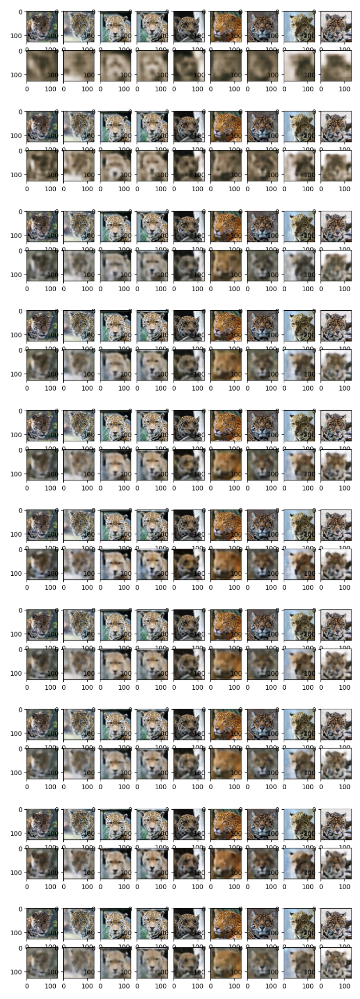

In [ ]:
# Visualize the results
trainer.visualize_results()

Training and Validation Loss

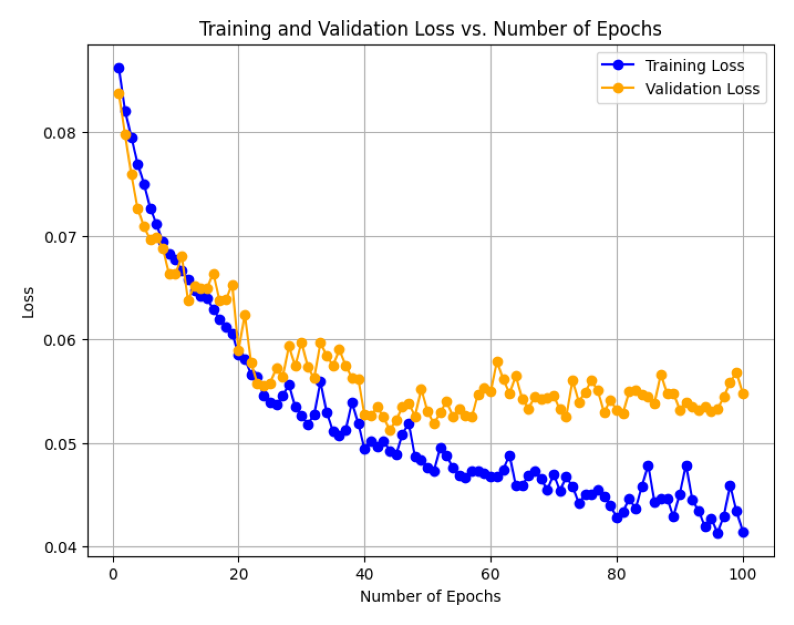

In [ ]:
# Plot the loss curves
trainer.plot_loss_curves()

Saving Latent Embeddings

In [ ]:
# Save embeddings after training
trainer.save_embeddings(training_dataloader)

Training GMM and Sampling

In [ ]:
# Cluster embeddings
csv_file = '/content/drive/My Drive/Project/DataSet/afhq/embeddings.csv'
gmm_model, generated_samples, original_embeddings = trainer.cluster_embeddings(csv_file)


Reconstruction using sampled embeddings

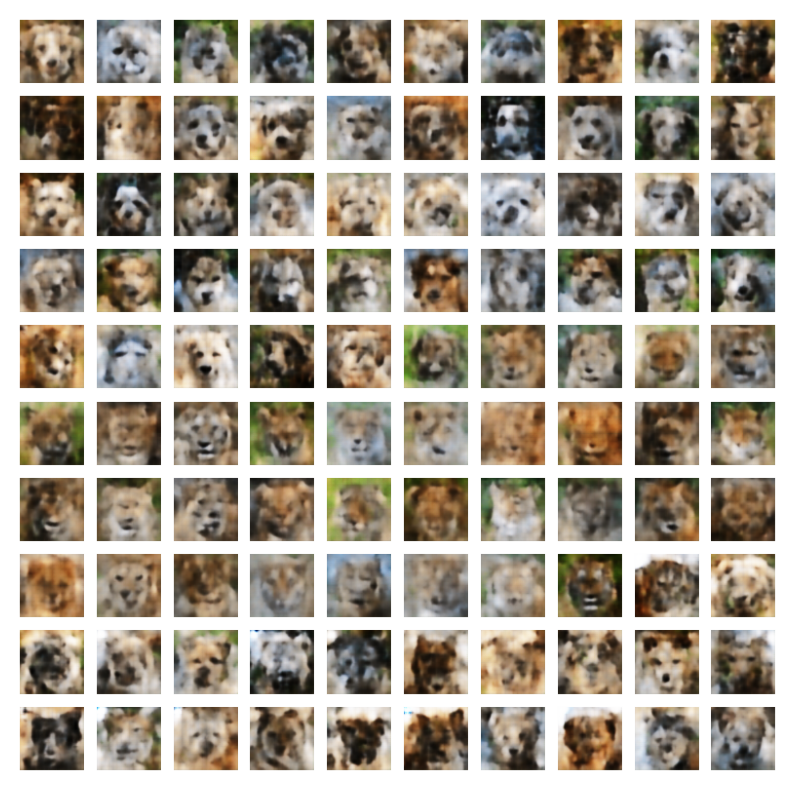

In [ ]:
trainer.decode_and_display_images("/content/drive/My Drive/Project/DataSet/afhq/AE_model_weights.pth", generated_samples[0])

## Classifier trained on Embeddings of the Autoencoder

In [ ]:
class LatentVectorClassifierTrainer:
    """
    Trains a classifier on latent vectors extracted from an autoencoder.
    """

    def __init__(self, csv_file, num_classes, batch_size=64, learning_rate=0.001, num_epochs=20):
        """
        Initializes the LatentVectorClassifierTrainer.

        Args:
            csv_file: Path to the CSV file containing embeddings and labels.
            num_classes: Number of classes for classification.
            batch_size: Batch size for training.
            learning_rate: Learning rate for the optimizer.
            num_epochs: Number of epochs for training.
        """
        self.csv_file = csv_file
        self.num_classes = num_classes
        self.batch_size = batch_size
        self.learning_rate = learning_rate
        self.num_epochs = num_epochs
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.classifier = None
        self.train_dataloader = None
        self.test_dataloader = None

    def load_and_preprocess_data(self):
        """
        Loads data from the CSV file, preprocesses it, and creates DataLoaders.
        """
        df = pd.read_csv(self.csv_file)

        # Clean and convert embeddings to floats
        def clean_and_convert(embedding_str):
            cleaned_str = embedding_str.replace('[', '').replace(']', '').replace('e+', 'e').replace('e-', 'e-')
            return [float(val) for val in cleaned_str.split()]

        df['Embeddings'] = df['Embeddings'].apply(clean_and_convert)

        # Pad or truncate embeddings to have the same length
        max_embedding_length = max(len(embedding) for embedding in df['Embeddings'])
        def pad_or_truncate(embedding):
            return embedding + [0.0] * (max_embedding_length - len(embedding))
        df['Embeddings'] = df['Embeddings'].apply(pad_or_truncate)

        # Extract embeddings and labels
        embeddings = df['Embeddings'].values
        labels = df['Label'].values

        embeddings = np.array(list(embeddings))

        # Convert to PyTorch tensors
        embeddings = torch.tensor(embeddings, dtype=torch.float32)
        labels = torch.tensor(labels, dtype=torch.long)

        # Split data into training and testing sets
        X_train, X_test, y_train, y_test = train_test_split(embeddings, labels, test_size=0.2, random_state=42)

        # Create DataLoaders
        self.train_dataloader = DataLoader(TensorDataset(X_train, y_train), batch_size=self.batch_size, shuffle=True)
        self.test_dataloader = DataLoader(TensorDataset(X_test, y_test), batch_size=self.batch_size, shuffle=False)

    def create_classifier(self, input_dim):
        """
        Creates the latent vector classifier model.
        """
        self.classifier = LatentVectorClassifier(input_dim, self.num_classes)
        self.classifier = self.classifier.to(self.device)

    def train_classifier(self):
        """
        Trains the latent vector classifier.
        """
        optimizer = optim.Adam(self.classifier.parameters(), lr=self.learning_rate)

        for epoch in range(self.num_epochs):
            self.classifier.train()
            total_loss = 0.0
            correct = 0
            total = 0

            for inputs, labels in self.train_dataloader:
                inputs, labels = inputs.to(self.device), labels.to(self.device)

                optimizer.zero_grad()
                outputs = self.classifier(inputs)
                loss = self.classifier.loss(outputs, labels)
                loss.backward()
                optimizer.step()

                total_loss += loss.item()
                _, predicted = torch.max(outputs, 1)
                total += labels.size(0)
                correct += (predicted == labels).sum().item()

            train_accuracy = 100 * correct / total
            print(f"Epoch {epoch + 1}/{self.num_epochs}, Loss: {total_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%")

    def evaluate_classifier(self):
        """
        Evaluates the trained classifier on the test set.
        """
        self.classifier.eval()
        correct = 0
        total = 0

        with torch.no_grad():
            for inputs, labels in self.test_dataloader:
                inputs, labels = inputs.to(self.device), labels.to(self.device)
                outputs = self.classifier(inputs)
                _, predicted = torch.max(outputs.data, 1)
                total += labels.size(0)
                correct += (predicted == labels).sum().item()

        test_accuracy = 100 * correct / total
        print(f"\nTest Accuracy: {test_accuracy:.2f}%")

    def train(self):
        """
        Performs the entire training and evaluation process.
        """
        self.load_and_preprocess_data()
        input_dim = self.train_dataloader.dataset.tensors[0].shape[1]
        self.create_classifier(input_dim)
        self.train_classifier()
        self.evaluate_classifier()


# Define the classifier model
class LatentVectorClassifier(nn.Module):
    def __init__(self, input_dim, num_classes):
        super(LatentVectorClassifier, self).__init__()
        self.fc = nn.Sequential(
            nn.Linear(input_dim, 64),
            nn.LeakyReLU(),
            nn.Linear(64, 32),
            nn.LeakyReLU(),
            nn.Linear(32, 16),
            nn.LeakyReLU(),
            nn.Linear(16, num_classes)
        )
        self.ce_loss = nn.CrossEntropyLoss()

    def forward(self, x):
        return self.fc(x)

    def loss(self, y_pred, y):
        return self.ce_loss(y_pred, y)

# Train the classifier
csv_file = '/content/drive/My Drive/Project/DataSet/afhq/embeddings/embeddings.csv'
num_classes = 3
trainer1 = LatentVectorClassifierTrainer(csv_file, num_classes)
trainer1.train()

Epoch 1/20, Loss: 88.0833, Train Accuracy: 55.06%
Epoch 2/20, Loss: 51.7564, Train Accuracy: 82.18%
Epoch 3/20, Loss: 39.8785, Train Accuracy: 86.28%
Epoch 4/20, Loss: 33.9951, Train Accuracy: 88.46%
Epoch 5/20, Loss: 29.6621, Train Accuracy: 90.32%
Epoch 6/20, Loss: 25.8094, Train Accuracy: 91.83%
Epoch 7/20, Loss: 23.1315, Train Accuracy: 92.48%
Epoch 8/20, Loss: 20.2875, Train Accuracy: 93.77%
Epoch 9/20, Loss: 18.2017, Train Accuracy: 94.16%
Epoch 10/20, Loss: 15.8921, Train Accuracy: 95.15%
Epoch 11/20, Loss: 13.8892, Train Accuracy: 95.89%
Epoch 12/20, Loss: 11.9387, Train Accuracy: 96.36%
Epoch 13/20, Loss: 9.8897, Train Accuracy: 97.35%
Epoch 14/20, Loss: 8.6397, Train Accuracy: 97.60%
Epoch 15/20, Loss: 7.0519, Train Accuracy: 98.21%
Epoch 16/20, Loss: 5.5485, Train Accuracy: 98.67%
Epoch 17/20, Loss: 4.4423, Train Accuracy: 99.09%
Epoch 18/20, Loss: 3.4497, Train Accuracy: 99.30%
Epoch 19/20, Loss: 2.5779, Train Accuracy: 99.50%
Epoch 20/20, Loss: 1.7976, Train Accuracy: 99.7